# Step 1: Introduction

The objective of this project is to perform Exploratory Data Analysis on the AMCAT dataset which contains 40 independent variables which are categorical as well as numerical in nature with 4000 datapoints which are of candidates who took AMCAT test. As we walk through the code work of the project the reader can find more information regarding the same.

# Step 2: Data definition, details, and description

In [1]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

In [2]:
df = pd.read_excel('/content/drive/MyDrive/Innomatics/AMCAT/amcat_data.xlsx')
df.head()

,Unnamed: 0,ID,Salary,DOJ,DOL,Designation,JobCity,Gender,DOB,10percentage,...,ComputerScience,MechanicalEngg,ElectricalEngg,TelecomEngg,CivilEngg,conscientiousness,agreeableness,extraversion,nueroticism,openess_to_experience
0,train,203097,420000,2012-06-01,present,senior quality engineer,Bangalore,f,1990-02-19,84.3,...,-1,-1,-1,-1,-1,0.9737,0.8128,0.5269,1.35490,-0.4455
1,train,579905,500000,2013-09-01,present,assistant manager,Indore,m,1989-10-04,85.4,...,-1,-1,-1,-1,-1,-0.7335,0.3789,1.2396,-0.10760,0.8637
2,train,810601,325000,2014-06-01,present,systems engineer,Chennai,f,1992-08-03,85.0,...,-1,-1,-1,-1,-1,0.2718,1.7109,0.1637,-0.86820,0.6721
3,train,267447,1100000,2011-07-01,present,senior software engineer,Gurgaon,m,1989-12-05,85.6,...,-1,-1,-1,-1,-1,0.0464,0.3448,-0.3440,-0.40780,-0.9194
4,train,343523,200000,2014-03-01,2015-03-01 00:00:00,get,Manesar,m,1991-02-27,78.0,...,-1,-1,-1,-1,-1,-0.8810,-0.2793,-1.0697,0.09163,-0.1295


In [4]:
df['Unnamed: 0'].unique()

array(['train'], dtype=object)

In [5]:
df.drop('Unnamed: 0', axis=1, inplace=True)

In [6]:
df.head()

,ID,Salary,DOJ,DOL,Designation,JobCity,Gender,DOB,10percentage,10board,...,ComputerScience,MechanicalEngg,ElectricalEngg,TelecomEngg,CivilEngg,conscientiousness,agreeableness,extraversion,nueroticism,openess_to_experience
0,203097,420000,2012-06-01,present,senior quality engineer,Bangalore,f,1990-02-19,84.3,"board ofsecondary education,ap",...,-1,-1,-1,-1,-1,0.9737,0.8128,0.5269,1.35490,-0.4455
1,579905,500000,2013-09-01,present,assistant manager,Indore,m,1989-10-04,85.4,cbse,...,-1,-1,-1,-1,-1,-0.7335,0.3789,1.2396,-0.10760,0.8637
2,810601,325000,2014-06-01,present,systems engineer,Chennai,f,1992-08-03,85.0,cbse,...,-1,-1,-1,-1,-1,0.2718,1.7109,0.1637,-0.86820,0.6721
3,267447,1100000,2011-07-01,present,senior software engineer,Gurgaon,m,1989-12-05,85.6,cbse,...,-1,-1,-1,-1,-1,0.0464,0.3448,-0.3440,-0.40780,-0.9194
4,343523,200000,2014-03-01,2015-03-01 00:00:00,get,Manesar,m,1991-02-27,78.0,cbse,...,-1,-1,-1,-1,-1,-0.8810,-0.2793,-1.0697,0.09163,-0.1295


In [7]:
df.shape

(3998, 38)

In [8]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 3998 entries, 0 to 3997
Data columns (total 38 columns):
 #   Column                 Non-Null Count  Dtype         
---  ------                 --------------  -----         
 0   ID                     3998 non-null   int64         
 1   Salary                 3998 non-null   int64         
 2   DOJ                    3998 non-null   datetime64[ns]
 3   DOL                    3998 non-null   object        
 4   Designation            3998 non-null   object        
 5   JobCity                3998 non-null   object        
 6   Gender                 3998 non-null   object        
 7   DOB                    3998 non-null   datetime64[ns]
 8   10percentage           3998 non-null   float64       
 9   10board                3998 non-null   object        
 10  12graduation           3998 non-null   int64         
 11  12percentage           3998 non-null   float64       
 12  12board                3998 non-null   object        
 13  Col

In [9]:
df.columns

Index(['ID', 'Salary', 'DOJ', 'DOL', 'Designation', 'JobCity', 'Gender', 'DOB',
       '10percentage', '10board', '12graduation', '12percentage', '12board',
       'CollegeID', 'CollegeTier', 'Degree', 'Specialization', 'collegeGPA',
       'CollegeCityID', 'CollegeCityTier', 'CollegeState', 'GraduationYear',
       'English', 'Logical', 'Quant', 'Domain', 'ComputerProgramming',
       'ElectronicsAndSemicon', 'ComputerScience', 'MechanicalEngg',
       'ElectricalEngg', 'TelecomEngg', 'CivilEngg', 'conscientiousness',
       'agreeableness', 'extraversion', 'nueroticism',
       'openess_to_experience'],
      dtype='object')

In [10]:
numerical_df = df[['Salary', '10percentage', '12percentage', 'collegeGPA', 'English',
                   'Logical', 'Quant', 'Domain', 'ComputerProgramming', 'ElectronicsAndSemicon', 'ComputerScience', 'MechanicalEngg',
                   'ElectricalEngg', 'TelecomEngg', 'CivilEngg', 'conscientiousness', 'agreeableness', 'extraversion', 'nueroticism',
                   'openess_to_experience']]
numerical_df.head()

,Salary,10percentage,12percentage,collegeGPA,English,Logical,Quant,Domain,ComputerProgramming,ElectronicsAndSemicon,ComputerScience,MechanicalEngg,ElectricalEngg,TelecomEngg,CivilEngg,conscientiousness,agreeableness,extraversion,nueroticism,openess_to_experience
0,420000,84.3,95.8,78.00,515,585,525,0.635979,445,-1,-1,-1,-1,-1,-1,0.9737,0.8128,0.5269,1.35490,-0.4455
1,500000,85.4,85.0,70.06,695,610,780,0.960603,-1,466,-1,-1,-1,-1,-1,-0.7335,0.3789,1.2396,-0.10760,0.8637
2,325000,85.0,68.2,70.00,615,545,370,0.450877,395,-1,-1,-1,-1,-1,-1,0.2718,1.7109,0.1637,-0.86820,0.6721
3,1100000,85.6,83.6,74.64,635,585,625,0.974396,615,-1,-1,-1,-1,-1,-1,0.0464,0.3448,-0.3440,-0.40780,-0.9194
4,200000,78.0,76.8,73.90,545,625,465,0.124502,-1,233,-1,-1,-1,-1,-1,-0.8810,-0.2793,-1.0697,0.09163,-0.1295


In [11]:
categorical_df = df[['DOJ', 'DOL', 'Designation', 'JobCity', 'Gender', 'DOB', '12graduation', '12board',
       'CollegeID', 'CollegeTier', 'Degree', 'Specialization', 'CollegeCityID', 'CollegeCityTier', 'CollegeState', 'GraduationYear',]]
categorical_df.head()

,DOJ,DOL,Designation,JobCity,Gender,DOB,12graduation,12board,CollegeID,CollegeTier,Degree,Specialization,CollegeCityID,CollegeCityTier,CollegeState,GraduationYear
0,2012-06-01,present,senior quality engineer,Bangalore,f,1990-02-19,2007,"board of intermediate education,ap",1141,2,B.Tech/B.E.,computer engineering,1141,0,Andhra Pradesh,2011
1,2013-09-01,present,assistant manager,Indore,m,1989-10-04,2007,cbse,5807,2,B.Tech/B.E.,electronics and communication engineering,5807,0,Madhya Pradesh,2012
2,2014-06-01,present,systems engineer,Chennai,f,1992-08-03,2010,cbse,64,2,B.Tech/B.E.,information technology,64,0,Uttar Pradesh,2014
3,2011-07-01,present,senior software engineer,Gurgaon,m,1989-12-05,2007,cbse,6920,1,B.Tech/B.E.,computer engineering,6920,1,Delhi,2011
4,2014-03-01,2015-03-01 00:00:00,get,Manesar,m,1991-02-27,2008,cbse,11368,2,B.Tech/B.E.,electronics and communication engineering,11368,0,Uttar Pradesh,2012


In [12]:
# Extracting only the years from DOJ, DOL, and DOB
def extract_year(value):
    if value == 'present':
        return 'present'
    else:
        return pd.to_datetime(value).year
categorical_df['DOJ_year'] =pd.to_datetime(categorical_df['DOJ']).dt.year
categorical_df['DOL_year'] =categorical_df['DOL'].apply(extract_year)
categorical_df['DOB_year'] =pd.to_datetime(categorical_df['DOB']).dt.year

<ipython-input-12-1b4e6779b32a>:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  categorical_df['DOJ_year'] =pd.to_datetime(categorical_df['DOJ']).dt.year
<ipython-input-12-1b4e6779b32a>:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  categorical_df['DOL_year'] =categorical_df['DOL'].apply(extract_year)
<ipython-input-12-1b4e6779b32a>:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the

In [13]:
categorical_df.columns

Index(['DOJ', 'DOL', 'Designation', 'JobCity', 'Gender', 'DOB', '12graduation',
       '12board', 'CollegeID', 'CollegeTier', 'Degree', 'Specialization',
       'CollegeCityID', 'CollegeCityTier', 'CollegeState', 'GraduationYear',
       'DOJ_year', 'DOL_year', 'DOB_year'],
      dtype='object')

In [14]:
categorical_df.head()

,DOJ,DOL,Designation,JobCity,Gender,DOB,12graduation,12board,CollegeID,CollegeTier,Degree,Specialization,CollegeCityID,CollegeCityTier,CollegeState,GraduationYear,DOJ_year,DOL_year,DOB_year
0,2012-06-01,present,senior quality engineer,Bangalore,f,1990-02-19,2007,"board of intermediate education,ap",1141,2,B.Tech/B.E.,computer engineering,1141,0,Andhra Pradesh,2011,2012,present,1990
1,2013-09-01,present,assistant manager,Indore,m,1989-10-04,2007,cbse,5807,2,B.Tech/B.E.,electronics and communication engineering,5807,0,Madhya Pradesh,2012,2013,present,1989
2,2014-06-01,present,systems engineer,Chennai,f,1992-08-03,2010,cbse,64,2,B.Tech/B.E.,information technology,64,0,Uttar Pradesh,2014,2014,present,1992
3,2011-07-01,present,senior software engineer,Gurgaon,m,1989-12-05,2007,cbse,6920,1,B.Tech/B.E.,computer engineering,6920,1,Delhi,2011,2011,present,1989
4,2014-03-01,2015-03-01 00:00:00,get,Manesar,m,1991-02-27,2008,cbse,11368,2,B.Tech/B.E.,electronics and communication engineering,11368,0,Uttar Pradesh,2012,2014,2015,1991


In [31]:
categorical_df_bivariate = categorical_df[['DOJ_year', 'DOL_year', 'Designation', 'JobCity', 'Gender', 'DOB_year', '12graduation',
       '12board', 'CollegeTier', 'Degree', 'Specialization', 'CollegeCityTier', 'CollegeState', 'GraduationYear']]
categorical_df_bivariate.head()

,DOJ_year,DOL_year,Designation,JobCity,Gender,DOB_year,12graduation,12board,CollegeTier,Degree,Specialization,CollegeCityTier,CollegeState,GraduationYear
0,2012,present,senior quality engineer,Bangalore,f,1990,2007,"board of intermediate education,ap",2,B.Tech/B.E.,computer engineering,0,Andhra Pradesh,2011
1,2013,present,assistant manager,Indore,m,1989,2007,cbse,2,B.Tech/B.E.,electronics and communication engineering,0,Madhya Pradesh,2012
2,2014,present,systems engineer,Chennai,f,1992,2010,cbse,2,B.Tech/B.E.,information technology,0,Uttar Pradesh,2014
3,2011,present,senior software engineer,Gurgaon,m,1989,2007,cbse,1,B.Tech/B.E.,computer engineering,1,Delhi,2011
4,2014,2015,get,Manesar,m,1991,2008,cbse,2,B.Tech/B.E.,electronics and communication engineering,0,Uttar Pradesh,2012


In [16]:
def replace_less_frequent_with_others(column, top_n=5):
    # Get the top N most frequent values
    top_values = column.value_counts().nlargest(top_n).index
    # Replace values not in the top N with 'Others'
    return column.apply(lambda x: x if x in top_values else 'Others')

In [17]:
for col in categorical_df_bivariate.select_dtypes(include=['object', 'int32', 'int64']).columns:
    unique_vals_count = categorical_df_bivariate[col].nunique()

    if unique_vals_count > 5:
        categorical_df_bivariate[col] = replace_less_frequent_with_others(categorical_df_bivariate[col], top_n=5)
categorical_df_bivariate.head()

<ipython-input-17-7ba407dfa16e>:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  categorical_df_bivariate[col] = replace_less_frequent_with_others(categorical_df_bivariate[col], top_n=5)
<ipython-input-17-7ba407dfa16e>:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  categorical_df_bivariate[col] = replace_less_frequent_with_others(categorical_df_bivariate[col], top_n=5)
<ipython-input-17-7ba407dfa16e>:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .

,DOJ_year,DOL_year,Designation,JobCity,Gender,DOB_year,12graduation,12board,CollegeTier,Degree,Specialization,CollegeCityTier,CollegeState,GraduationYear
0,2012,present,Others,Bangalore,f,1990,2007,Others,2,B.Tech/B.E.,computer engineering,0,Others,2011
1,2013,present,Others,Others,m,1989,2007,cbse,2,B.Tech/B.E.,electronics and communication engineering,0,Others,2012
2,2014,present,systems engineer,Others,f,1992,2010,cbse,2,B.Tech/B.E.,information technology,0,Uttar Pradesh,2014
3,2011,present,Others,Others,m,1989,2007,cbse,1,B.Tech/B.E.,computer engineering,1,Others,2011
4,2014,2015,Others,Others,m,1991,2008,cbse,2,B.Tech/B.E.,electronics and communication engineering,0,Uttar Pradesh,2012


In [18]:
categorical_df_bivariate.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 3998 entries, 0 to 3997
Data columns (total 14 columns):
 #   Column           Non-Null Count  Dtype 
---  ------           --------------  ----- 
 0   DOJ_year         3998 non-null   object
 1   DOL_year         3998 non-null   object
 2   Designation      3998 non-null   object
 3   JobCity          3998 non-null   object
 4   Gender           3998 non-null   object
 5   DOB_year         3998 non-null   object
 6   12graduation     3998 non-null   object
 7   12board          3998 non-null   object
 8   CollegeTier      3998 non-null   int64 
 9   Degree           3998 non-null   object
 10  Specialization   3998 non-null   object
 11  CollegeCityTier  3998 non-null   int64 
 12  CollegeState     3998 non-null   object
 13  GraduationYear   3998 non-null   object
dtypes: int64(2), object(12)
memory usage: 437.4+ KB


In [19]:
categorical_df_bivariate.nunique()

,0
DOJ_year,6
DOL_year,6
Designation,6
JobCity,6
Gender,2
DOB_year,6
12graduation,6
12board,6
CollegeTier,2
Degree,4


# Step 3: Univariate Analysis

## Performing Univariate Analysis on the numerical columns

In [ ]:
# defining a function to perform non-visual NUA to give more insights than describe()
def numerical_univariate_analysis(numerical_data):
  for column_name in numerical_data:
    print(f"{'<'}{'-'*10}{column_name}{'-'*10}{'>'}")
    print(numerical_data[column_name].agg(['min', 'max', 'mean', 'median', 'std', 'skew', 'kurtosis']))

In [ ]:
numerical_df.isnull().sum()

,0
Salary,0
10percentage,0
12percentage,0
collegeGPA,0
English,0
Logical,0
Quant,0
Domain,0
ComputerProgramming,0
ElectronicsAndSemicon,0


### Analysis on Salary

*1) Non-visual analysis:*

In [ ]:
numerical_univariate_analysis(numerical_df[['Salary']])

<----------Salary---------->
min         3.500000e+04
max         4.000000e+06
mean        3.076998e+05
median      3.000000e+05
std         2.127375e+05
skew        6.451081e+00
kurtosis    8.093000e+01
Name: Salary, dtype: float64


*2) Visual analysis*

<Axes: ylabel='Density'>

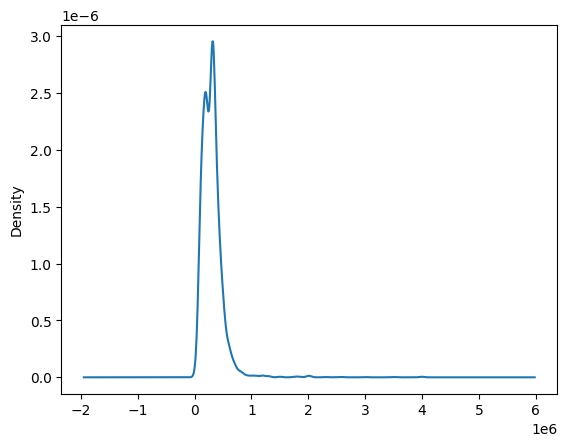

In [ ]:
numerical_df['Salary'].plot(kind = 'kde')

This kde plot suggests that the distribution is leptokurtic meaning the kurtosis is greater than 3 confirming the value obtained in non-viz analysis and the number of outliers are way too high\
Due to steepness of the curve due to high kurtosis, it's little difficult to observe the skew, but the curve is actually right skewed suggesting there are more people are in the salary range less than the mean value which is around 377000

<Axes: ylabel='Frequency'>

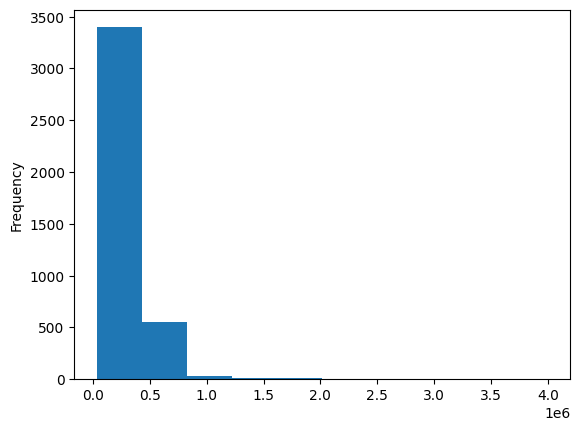

In [ ]:
numerical_df['Salary'].plot(kind = 'hist')

This plot suggests that most of the people earn between 0.1X1e6 to 0.5X1e6 which is between 100000 to 400000 INR annually, as well as confirming our observation from the previous plot which is presence of more people in the range less than mean value of 377000

<Axes: >

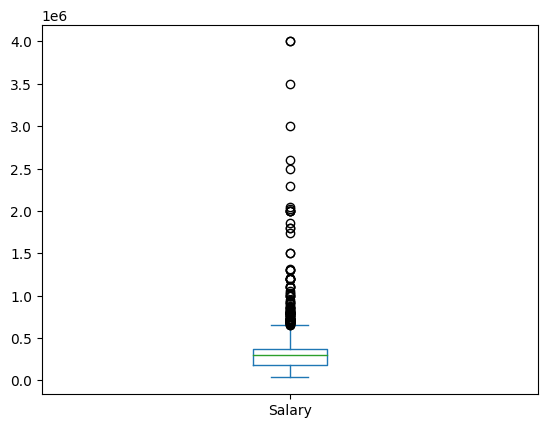

In [ ]:
numerical_df['Salary'].plot(kind = 'box')

This plot confirms our observation of presence of lot of outliers from the kde plot, and we can observe that there are a lot of outliers just above 0.7X1e6 which is above 700000 INR salary range

### Analysis on 10th percentage

*1) Non-visual analysis*

In [ ]:
numerical_univariate_analysis(numerical_df[['10percentage']])

<----------10percentage---------->
min         43.000000
max         97.760000
mean        77.925443
median      79.150000
std          9.850162
skew        -0.591019
kurtosis    -0.110284
Name: 10percentage, dtype: float64


*2) Visual analysis*

<Axes: ylabel='Density'>

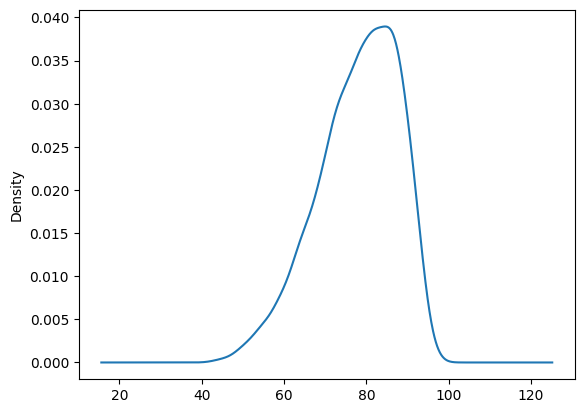

In [ ]:
numerical_df['10percentage'].plot(kind = 'kde')

This kde plot suggests that the distribution is platykurtic meaning the kurtosis value is less than 3 confirming the value obtained in non-viz analysis with less number of outliers\
The skew of the plot is observed to be left-skewed suggesting that more candidates scored above the mean score of around 78 in 10th standard and confirming the negative skew value obtained from non-viz analysis

<Axes: ylabel='Frequency'>

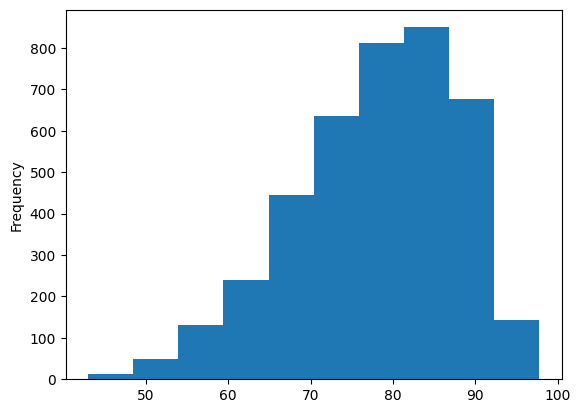

In [ ]:
numerical_df['10percentage'].plot(kind = 'hist')

 This plot suggests that most of the candidates scored between 75 to 90 which in their 10th standard board exams confirming our observation from the previous plot which is presence of more people in the range above the mean value of 78

<Axes: >

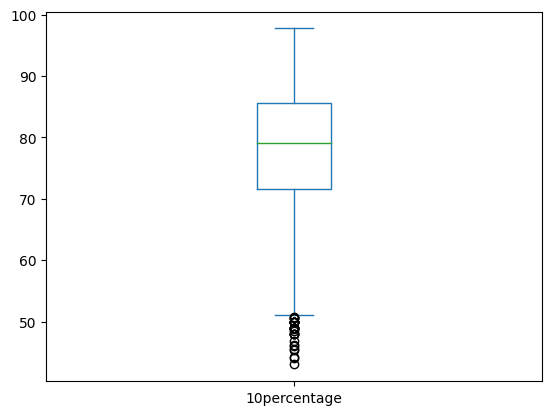

In [ ]:
numerical_df['10percentage'].plot(kind = 'box')

This plot shows why the left tail in the kde plot is a little bit longer than the right tail suggesting the presence of outliers in the range of values less than mean, but no too many outliers owing to the kurtosis



### Analysis on 12th percentage

*1) Non-visual analysis*

In [ ]:
numerical_univariate_analysis(numerical_df[['12percentage']])

<----------12percentage---------->
min         40.000000
max         98.700000
mean        74.466366
median      74.400000
std         10.999933
skew        -0.032607
kurtosis    -0.630737
Name: 12percentage, dtype: float64


*2) Visual analysis*

<Axes: ylabel='Density'>

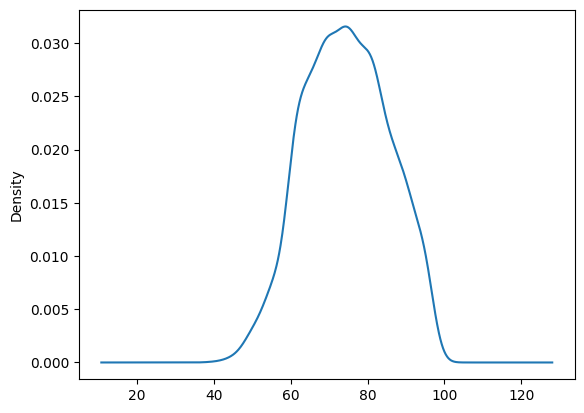

In [ ]:
numerical_df['12percentage'].plot(kind = 'kde')

This kde plot suggests that the distribution is platykurtic meaning the kurtosis is between -2 to 2 confirming the value obtained in non-viz analysis with less number of outliers\
The skew of the plot is observed to be almost symmetric from 40 to 100 in 12th standard with a left tail confirming the negative skew value obtained from non-viz analysis due to the presence of outliers

<Axes: ylabel='Frequency'>

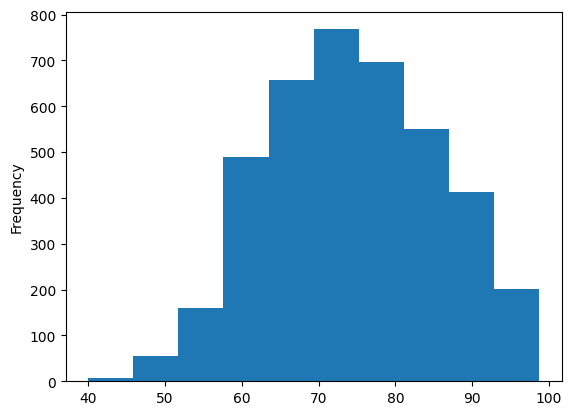

In [ ]:
numerical_df['12percentage'].plot(kind = 'hist')

 This plot suggests that most of the candidates scored between 70 to 75 which in their 10th standard board exams confirming our observation from the previous plot which is symmetric distribution of marks scored by candidates in 12th standard

<Axes: >

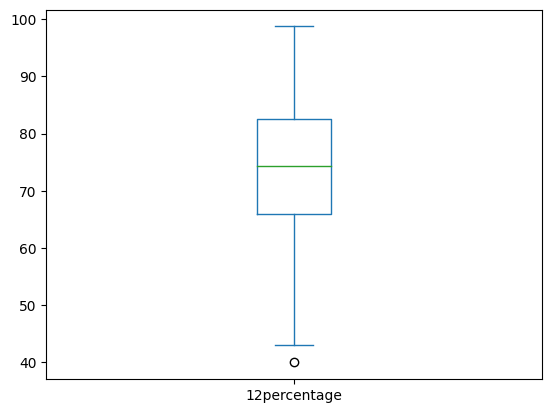

In [ ]:
numerical_df['12percentage'].plot(kind = 'box')

This plot shows why the left tail in the kde plot is longer than the right tail due to the presence of just one outliers at 40 which is the minimum value


### Analysis on college GPA

*1) Non-visual analysis*

In [ ]:
numerical_univariate_analysis(numerical_df[['collegeGPA']])

<----------collegeGPA---------->
min          6.450000
max         99.930000
mean        71.486171
median      71.720000
std          8.167338
skew        -1.249209
kurtosis    10.234244
Name: collegeGPA, dtype: float64


*2) Visual analysis*

<Axes: ylabel='Density'>

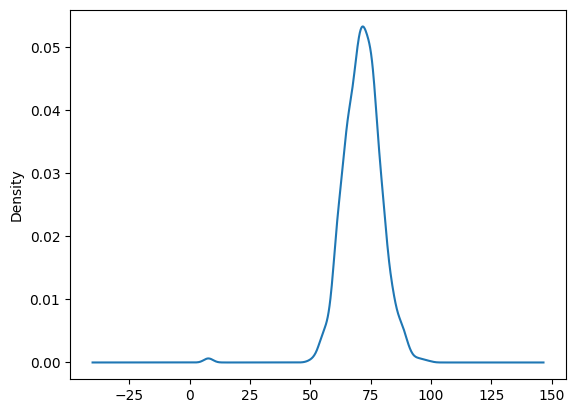

In [ ]:
numerical_df['collegeGPA'].plot(kind = 'kde')

This kde plot suggests that the distribution is leptokurtic meaning the kurtosis is greater than 3 confirming the value obtained in non-viz analysis with a lot of outliers\
The skew of the plot is observed to be almost symmetrical suggesting that most of the candidates scored around the average score of 71.5 in their college exams\
Also the left tail suggests the presence of a lot of outliers below the average score

<Axes: ylabel='Frequency'>

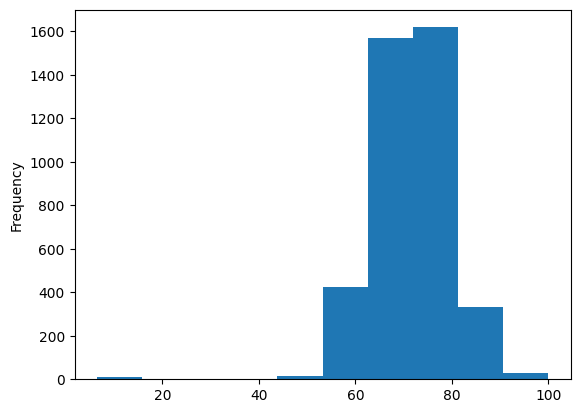

In [ ]:
numerical_df['collegeGPA'].plot(kind = 'hist')

As observed in the previous plot it is clear that the most of the candidates scored in the range of 70 to 79 in their college exams


<Axes: >

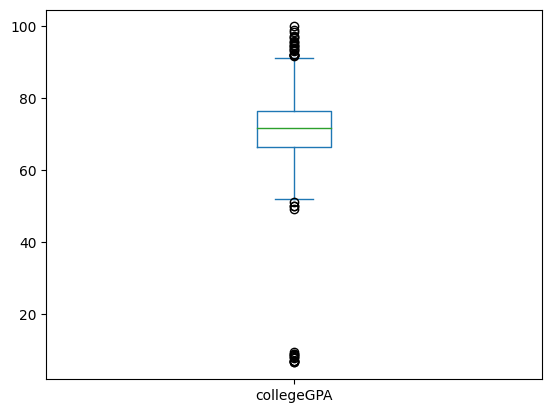

In [ ]:
numerical_df['collegeGPA'].plot(kind = 'box')

This plot confirms the presence of outliers that was inferred in the kde plot over the range below the average value, and it is clear that the most of the outliers lie below the value of 50

### Analysis on English

*1) Non-visual analysis*

In [ ]:
numerical_univariate_analysis(numerical_df[['English']])

<----------English---------->
min         180.000000
max         875.000000
mean        501.649075
median      500.000000
std         104.940021
skew          0.191997
kurtosis     -0.254133
Name: English, dtype: float64


*2) Visual analysis*

<Axes: ylabel='Density'>

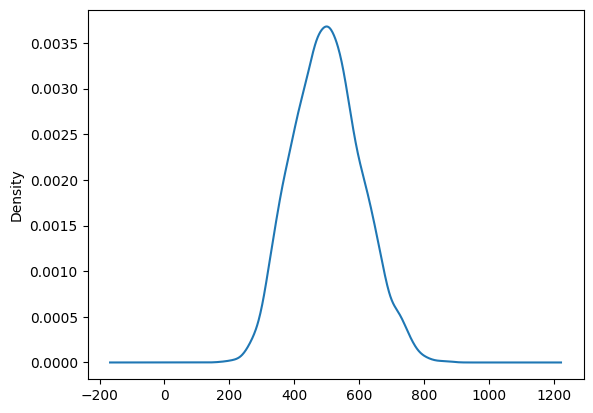

In [ ]:
numerical_df['English'].plot(kind = 'kde')

This kde plot suggests that the distribution is platykurtic meaning the kurtosis is less than 3 confirming the value obtained in non-viz analysis with a lot of outliers\
The skew of the plot is observed to be almost symmetrical suggesting that most of the candidates scored around the average score of 500 in English at AMCAT

<Axes: ylabel='Frequency'>

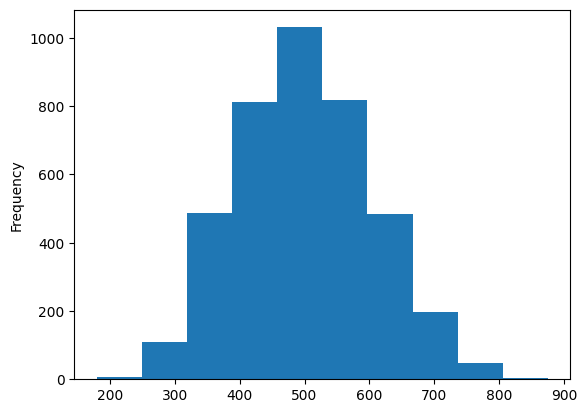

In [ ]:
numerical_df['English'].plot(kind = 'hist')

As observed in the previous plot it is clear that the most of the candidates scored around 500 in English at AMCAT


<Axes: >

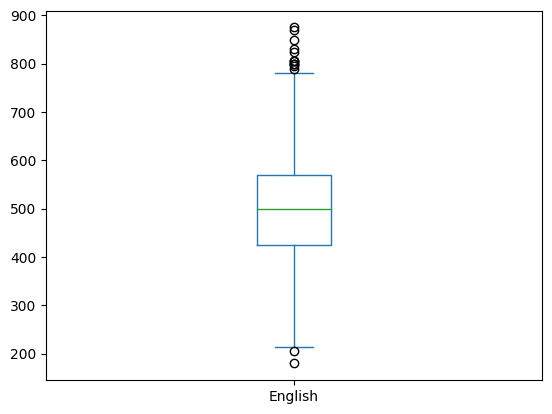

In [ ]:
numerical_df['English'].plot(kind = 'box')

This plot shows the presence of outliers which was subtly visible in kde plot but clear in this plot because very few students above 800 and only two below 200

### Analysis on Logical

*1) Non-visual analysis*

In [ ]:
numerical_univariate_analysis(numerical_df[['Logical']])

<----------Logical---------->
min         195.000000
max         795.000000
mean        501.598799
median      505.000000
std          86.783297
skew         -0.216602
kurtosis     -0.224761
Name: Logical, dtype: float64


*2) Visual analysis*

<Axes: ylabel='Density'>

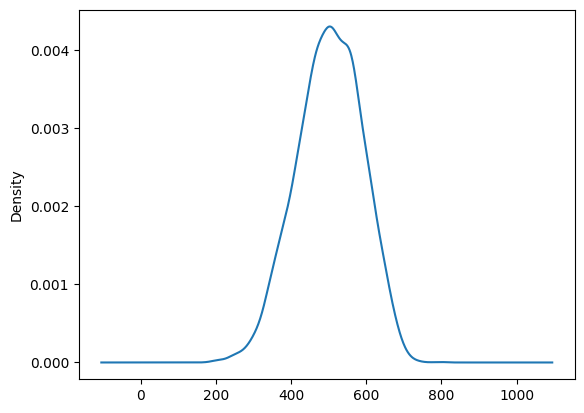

In [ ]:
numerical_df['Logical'].plot(kind = 'kde')

This kde plot suggests that the distribution is platykurtic meaning the kurtosis is less than 3 confirming the value obtained in non-viz analysis with a lot of outliers\
The skew of the plot is observed to be almost symmetrical suggesting that most of the candidates scored around the average score of 500 in Logical at AMCAT\
The left tail is longer than suggesting the presence of outliers below the mean value of around 500

<Axes: ylabel='Frequency'>

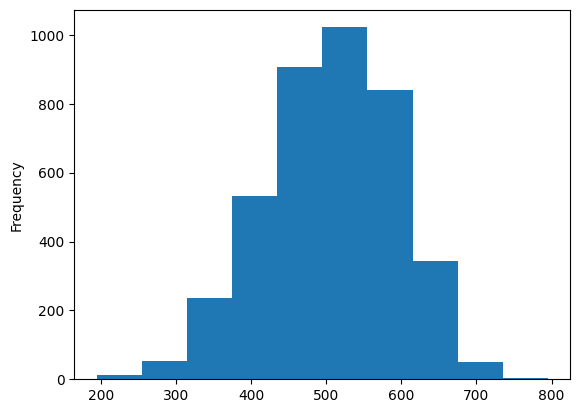

In [ ]:
numerical_df['Logical'].plot(kind = 'hist')

As observed in the previous plot it is clear that the most of the candidates scored around 500 in Logical at AMCAT


<Axes: >

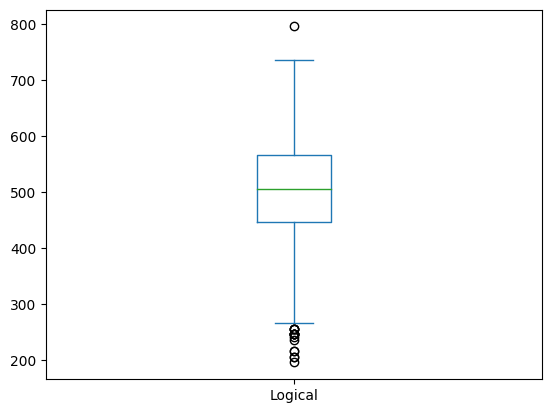

In [ ]:
numerical_df['Logical'].plot(kind = 'box')

This plot confirms the presence of outliers below the mean value which was concluded in the kde plot and we can see there is an outlier above the mean value as well at around 800 which is the maximum score scored by a candidate in Logical at AMCAT

### Analysis on Quant

*1) Non-visual analysis*

In [ ]:
numerical_univariate_analysis(numerical_df[['Quant']])

<----------Quant---------->
min         120.000000
max         900.000000
mean        513.378189
median      515.000000
std         122.302332
skew         -0.019399
kurtosis     -0.102472
Name: Quant, dtype: float64


*2) Visual analysis*

<Axes: ylabel='Density'>

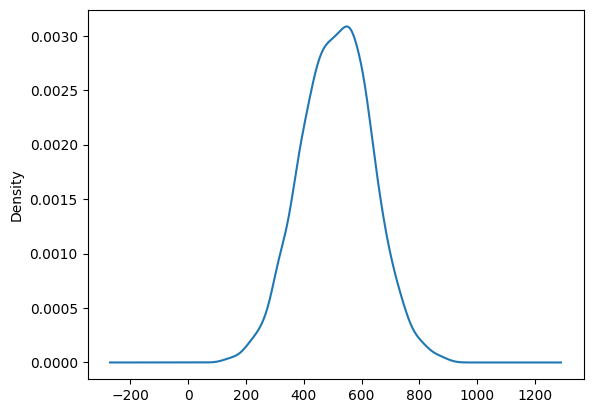

In [ ]:
numerical_df['Quant'].plot(kind = 'kde')

This kde plot suggests that the distribution is platykurtic meaning the kurtosis is less than 3 confirming the value obtained in non-viz analysis with a lot of outliers\
The skew of the plot is observed to be almost symmetrical suggesting that most of the candidates scored around the average score of 500 in Quantitative section at AMCAT\
The left tail is longer than suggesting the presence of outliers below the mean value of around 500

<Axes: ylabel='Frequency'>

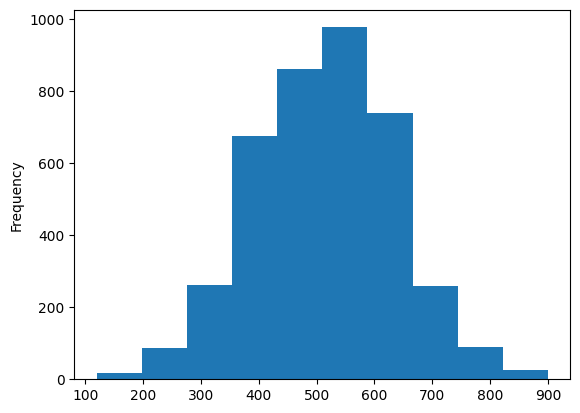

In [ ]:
numerical_df['Quant'].plot(kind = 'hist')

As observed in the previous plot it is clear that the most of the candidates scored around 500 in Quantitative section at AMCAT


<Axes: >

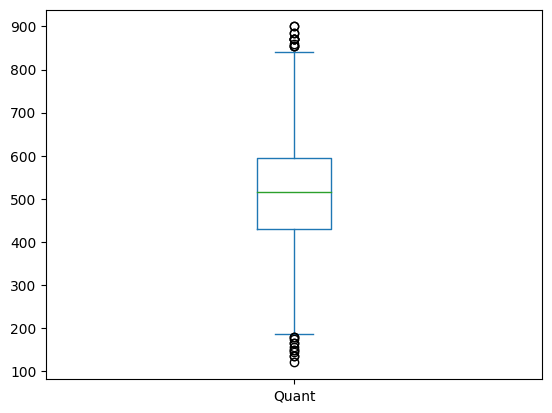

In [ ]:
numerical_df['Quant'].plot(kind = 'box')

This plot confirms the presence of outliers below the mean value which was concluded in the kde plot and we can see there are a few outliers above 800 suggesting that some students performed well in Quantitative section at AMCAT

### Analysis on Computer Programming

*1) Non-visual analysis*

In [ ]:
numerical_univariate_analysis(numerical_df[['ComputerProgramming']])

<----------ComputerProgramming---------->
min          -1.000000
max         840.000000
mean        353.102801
median      415.000000
std         205.355519
skew         -0.778106
kurtosis     -0.666352
Name: ComputerProgramming, dtype: float64


*2) Visual analysis*

<Axes: ylabel='Density'>

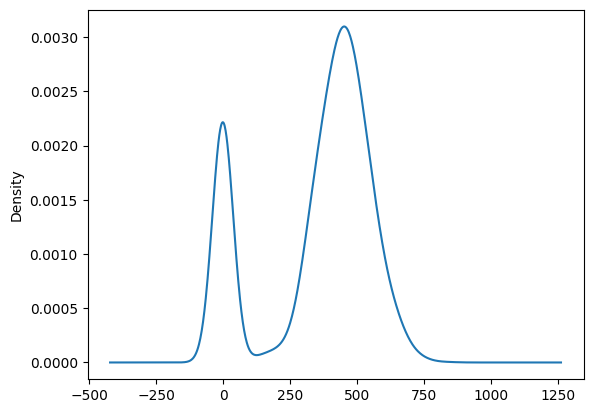

In [ ]:
numerical_df['ComputerProgramming'].plot(kind = 'kde')

We can see there are two peaks in the kde plot which may seem confusing, let's analyse the histogram and check what's wrong.

<Axes: ylabel='Frequency'>

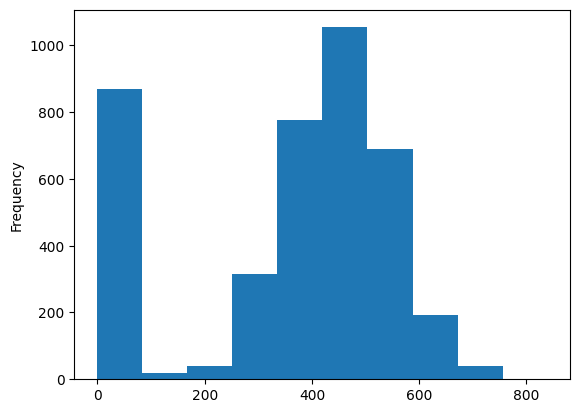

In [ ]:
numerical_df['ComputerProgramming'].plot(kind = 'hist')

In [ ]:
numerical_df[numerical_df['ComputerProgramming'] == -1].shape

(868, 20)

From the histogram andd the value obtained as above, it is clear that around 868 candidates which is 23% of the students were scored as -1 in the computer programming part of AMCAT, which either suggests that they scored really bad in this part or that 77% of the candidates only attempted the computer programming part in AMCAT, which is more obvious than the former


---



Let's try to reanalyse those who actually attempted the computere programming part

*1) Non-visual*

In [ ]:
numerical_univariate_analysis(numerical_df[numerical_df['ComputerProgramming'] > -1][['ComputerProgramming']])

<----------ComputerProgramming---------->
min         105.000000
max         840.000000
mean        451.301278
median      455.000000
std          97.158687
skew         -0.015933
kurtosis      0.411168
Name: ComputerProgramming, dtype: float64


In [ ]:
numerical_df[numerical_df['ComputerProgramming'] > -1].shape[0]

3130

*2) Visual*

<Axes: ylabel='Density'>

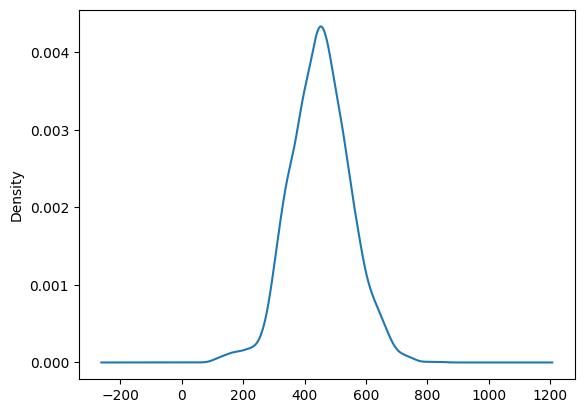

In [ ]:
numerical_df[numerical_df['ComputerProgramming'] > -1]['ComputerProgramming'].plot(kind = 'kde')

Now the plot is easier to analyse, and we can see the plot is symmetric about the mean with outliers almost equal in number on either side of the mean value

<Axes: ylabel='Frequency'>

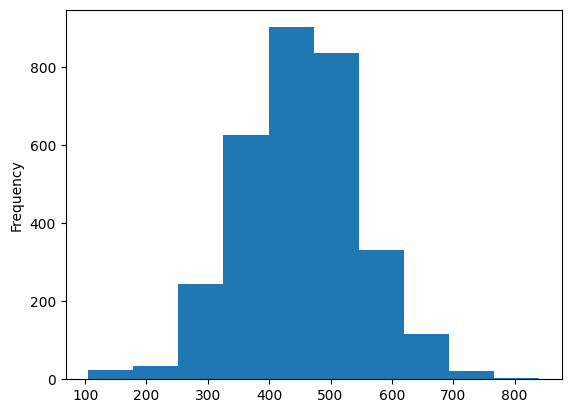

In [ ]:
numerical_df[numerical_df['ComputerProgramming'] > -1]['ComputerProgramming'].plot(kind = 'hist')

This plot shows that most of the candidates scored close to average scores in computer programming part of AMCAT

<Axes: >

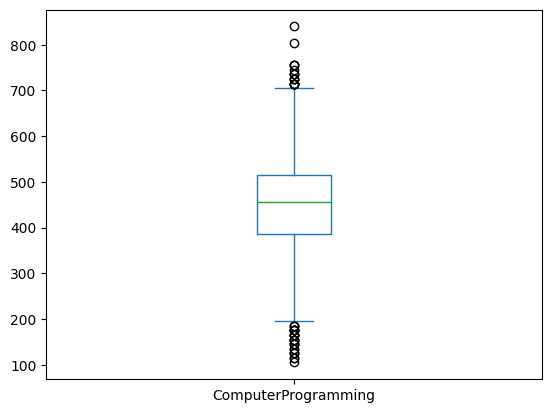

In [ ]:
numerical_df[numerical_df['ComputerProgramming'] > -1]['ComputerProgramming'].plot(kind = 'box')

This plot shows that only two candidates managed to get close to the highest marks in the computer programming part of AMCAT

### Analysis on Domain

*1) Non-visual analysis*

In [ ]:
numerical_df[numerical_df['Domain'] == -1].shape[0]

246

In [ ]:
numerical_df[numerical_df['Domain'] != -1].shape[0]

3752

246 candidates were scored as -1 suggesting that these candidates didn't attend the Domain module

In [ ]:
numerical_univariate_analysis(numerical_df[numerical_df['Domain'] > -1][['Domain']])

<----------Domain---------->
min         0.002750
max         0.999910
mean        0.609525
median      0.649390
std         0.273159
skew       -0.386342
kurtosis   -0.960650
Name: Domain, dtype: float64




---


***So we need not analyse the entirety of candidates in this case and just focus on those actually attempted the section by filtering out the non-attendees***


---



*2) Visual analysis*

<Axes: ylabel='Density'>

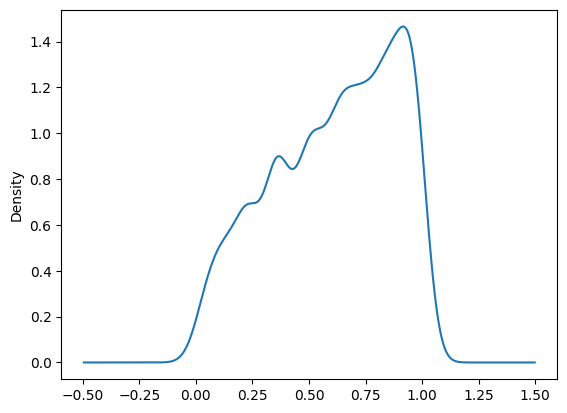

In [ ]:
numerical_df[numerical_df['Domain'] > -1]['Domain'].plot(kind = 'kde')

The kde plot suggests the distribution of the values are so uneven which is due to the reason that the score in this module ranges from 0 to 1 which is pretty short range and the plot is left skewed suggesting more candidates scored above the average score

<Axes: ylabel='Frequency'>

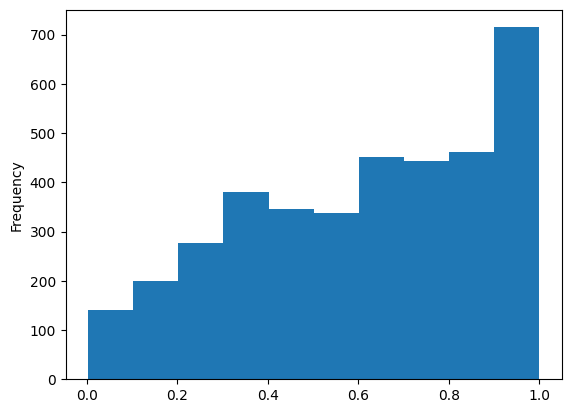

In [ ]:
numerical_df[numerical_df['Domain'] > -1]['Domain'].plot(kind = 'hist')

Most of the candidates scored 1.0 which is the maximum score scored by the candidates in this module

<Axes: >

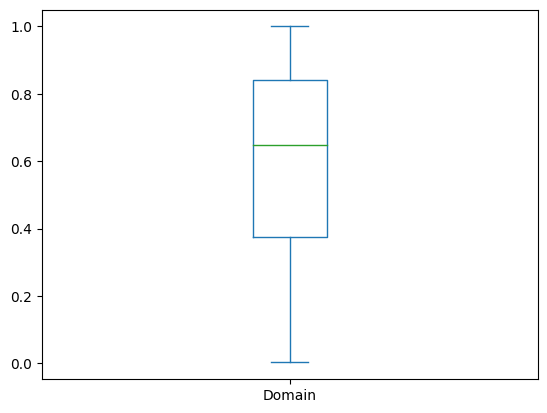

In [ ]:
numerical_df[numerical_df['Domain'] > -1]['Domain'].plot(kind = 'box')

There are no outliers in this module because the of the score range which is from 0 to 1.

### Analysis on ElectronicsAndSemicon

*1) Non-visual analysis*

In [ ]:
numerical_univariate_analysis(numerical_df[['ElectronicsAndSemicon']])

<----------ElectronicsAndSemicon---------->
min          -1.000000
max         612.000000
mean         95.328414
median       -1.000000
std         158.241218
skew          1.195975
kurtosis     -0.210374
Name: ElectronicsAndSemicon, dtype: float64


In [ ]:
numerical_df[numerical_df['ElectronicsAndSemicon'] == -1].shape

(2854, 20)

We can see that very small percentage of the candidates chose Electronics and Semiconductors part in AMCAT





---


***So we need not analyse the entirety of candidates in this case and just focus on those actually attempted the section by filtering out the non-attendees***


---



In [ ]:
numerical_univariate_analysis(numerical_df[numerical_df['ElectronicsAndSemicon'] > -1][['ElectronicsAndSemicon']])

<----------ElectronicsAndSemicon---------->
min         133.000000
max         612.000000
mean        335.644231
median      333.000000
std          81.194840
skew          0.283805
kurtosis     -0.023270
Name: ElectronicsAndSemicon, dtype: float64


*2) Visual analysis*

<Axes: ylabel='Density'>

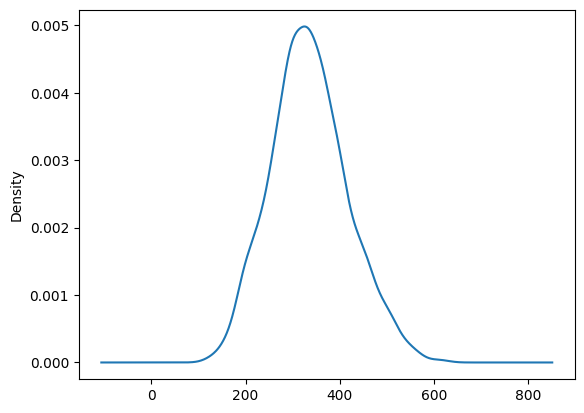

In [ ]:
numerical_df[numerical_df['ElectronicsAndSemicon'] > -1]['ElectronicsAndSemicon'].plot(kind = 'kde')

The kde plot is platykurtic and almost symmetric (meaning almost no skew) and hence most values are distributed around the mean score of the candidates in this section

<Axes: ylabel='Frequency'>

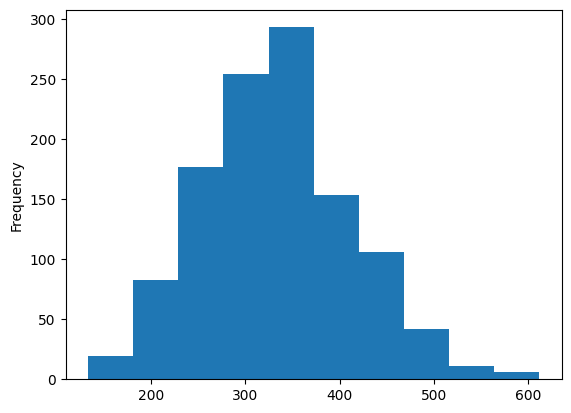

In [ ]:
numerical_df[numerical_df['ElectronicsAndSemicon'] > -1]['ElectronicsAndSemicon'].plot(kind = 'hist')

Most of the candidates scored around the average value of score among the candidates who attempted the Electronics and Semiconductor section of AMCAT

<Axes: >

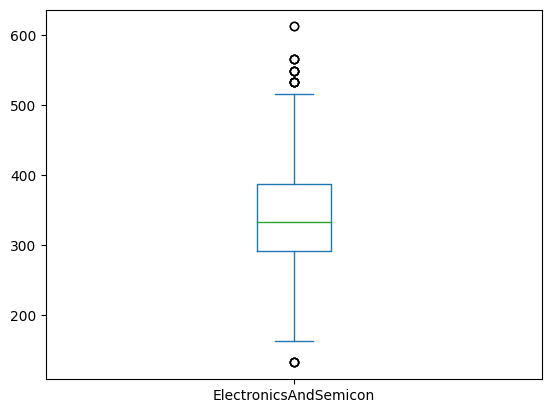

In [ ]:
numerical_df[numerical_df['ElectronicsAndSemicon'] > -1]['ElectronicsAndSemicon'].plot(kind = 'box')

This plot shows that around 10 candidates scored less than 200 and some aced the section by scoring above 500 in the same

### Analysis on ComputerScience

*1) Non-visual analysis*

In [ ]:
numerical_univariate_analysis(numerical_df[['ComputerScience']])

<----------ComputerScience---------->
min          -1.000000
max         715.000000
mean         90.742371
median       -1.000000
std         175.273083
skew          1.529521
kurtosis      0.692641
Name: ComputerScience, dtype: float64


In [ ]:
numerical_df[numerical_df['ComputerScience'] == -1].shape

(3096, 20)

We can see that very small percentage of the candidates chose Computer Science part in AMCAT





---


***So we need not analyse the entirety of candidates in this case and just focus on those actually attempted the section by filtering out the non-attendees***


---



In [ ]:
numerical_univariate_analysis(numerical_df[numerical_df['ComputerScience'] > -1][['ComputerScience']])

<----------ComputerScience---------->
min         130.000000
max         715.000000
mean        405.636364
median      407.000000
std          89.960805
skew          0.366018
kurtosis      0.212597
Name: ComputerScience, dtype: float64


*2) Visual analysis*

<Axes: ylabel='Density'>

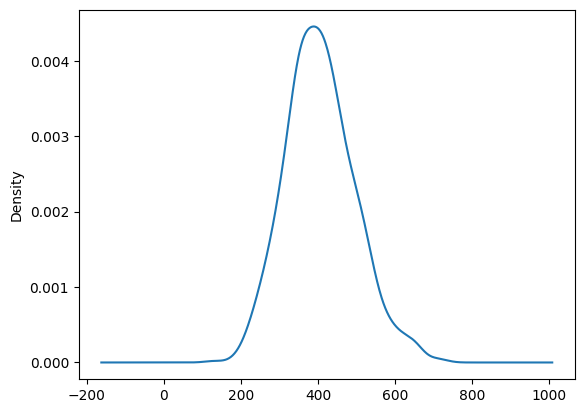

In [ ]:
numerical_df[numerical_df['ComputerScience'] > -1]['ComputerScience'].plot(kind = 'kde')

The kde plot is platykurtic and almost symmetric (meaning almost no skew) and hence most values are distributed around the mean score of the candidates in this section

<Axes: ylabel='Frequency'>

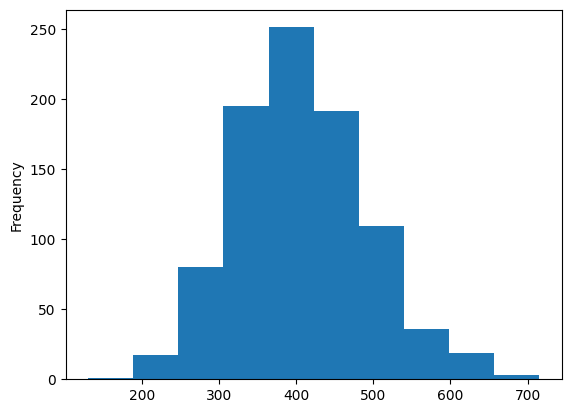

In [ ]:
numerical_df[numerical_df['ComputerScience'] > -1]['ComputerScience'].plot(kind = 'hist')

Most of the candidates scored around the average value of score among the candidates who attempted the Computer Science section of AMCAT

<Axes: >

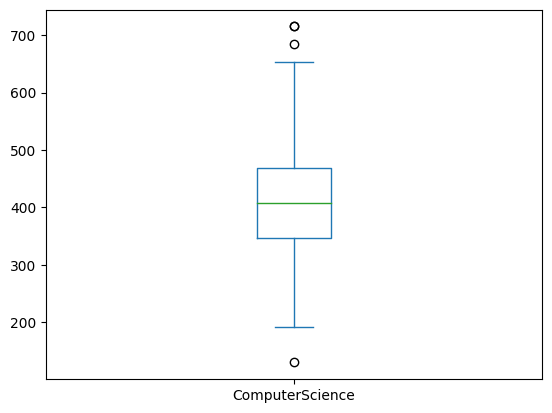

In [ ]:
numerical_df[numerical_df['ComputerScience'] > -1]['ComputerScience'].plot(kind = 'box')

This plot shows that 1 candidate scored less than 200 and 3 to 5 candidates aced the section by scoring above 600 in the same

### Analysis on MechanicalEngg

*1) Non-visual analysis*

In [ ]:
numerical_univariate_analysis(numerical_df[['MechanicalEngg']])

<----------MechanicalEngg---------->
min          -1.000000
max         623.000000
mean         22.974737
median       -1.000000
std          98.123311
skew          4.029563
kurtosis     15.018957
Name: MechanicalEngg, dtype: float64


In [ ]:
numerical_df[numerical_df['MechanicalEngg'] == -1].shape

(3763, 20)

We can see that very small percentage of the candidates chose Mechanical Engg part in AMCAT





---


***So we need not analyse the entirety of candidates in this case and just focus on those actually attempted the section by filtering out the non-attendees***


---



In [ ]:
numerical_univariate_analysis(numerical_df[numerical_df['MechanicalEngg'] > -1][['MechanicalEngg']])

<----------MechanicalEngg---------->
min         180.000000
max         623.000000
mean        406.876596
median      407.000000
std          84.894993
skew          0.154834
kurtosis      0.051448
Name: MechanicalEngg, dtype: float64


*2) Visual analysis*

<Axes: ylabel='Density'>

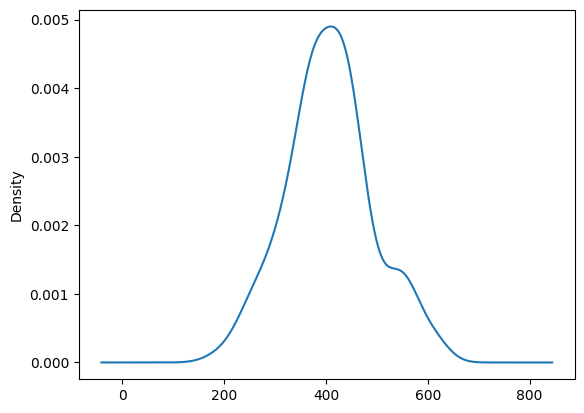

In [ ]:
numerical_df[numerical_df['MechanicalEngg'] > -1]['MechanicalEngg'].plot(kind = 'kde')

The kde plot is platykurtic and almost symmetric (meaning almost no skew) and hence most values are distributed around the mean score of the candidates in this section

<Axes: ylabel='Frequency'>

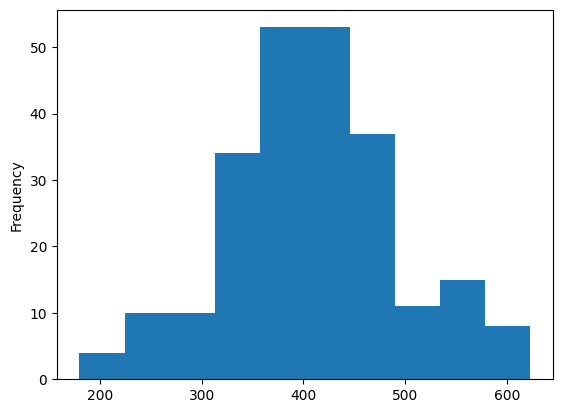

In [ ]:
numerical_df[numerical_df['MechanicalEngg'] > -1]['MechanicalEngg'].plot(kind = 'hist')

Most of the candidates scored around the average value of score among the candidates who attempted the Mechanical Engg section of AMCAT\
A sudden bump around the score range of 550 to 570 can suggest there needs some more checks need to be done on those candidates becuase there could be a chances of malpractice or something

<Axes: >

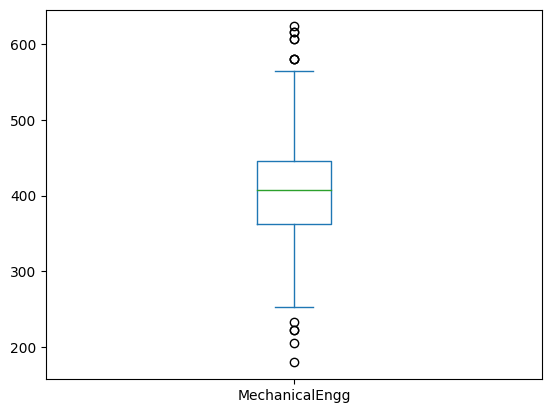

In [ ]:
numerical_df[numerical_df['MechanicalEngg'] > -1]['MechanicalEngg'].plot(kind = 'box')

This plot shows that around 10 candidates scored less than 250 and around 10 other candidates aced the section by scoring above 575 in the same

### Analysis on ElectricalEngg

*1) Non-visual analysis*

In [ ]:
numerical_univariate_analysis(numerical_df[['ElectricalEngg']])

<----------ElectricalEngg---------->
min          -1.000000
max         676.000000
mean         16.478739
median       -1.000000
std          87.585634
skew          5.060407
kurtosis     24.878194
Name: ElectricalEngg, dtype: float64


In [ ]:
numerical_df[numerical_df['ElectricalEngg'] == -1].shape

(3837, 20)

We can see that very small percentage of the candidates chose Electrical Engg part in AMCAT





---


***So we need not analyse the entirety of candidates in this case and just focus on those actually attempted the section by filtering out the non-attendees***


---



In [ ]:
numerical_univariate_analysis(numerical_df[numerical_df['ElectricalEngg'] > -1][['ElectricalEngg']])

<----------ElectricalEngg---------->
min         206.000000
max         676.000000
mean        433.037267
median      433.000000
std          98.515537
skew          0.170428
kurtosis     -0.269613
Name: ElectricalEngg, dtype: float64


*2) Visual analysis*

<Axes: ylabel='Density'>

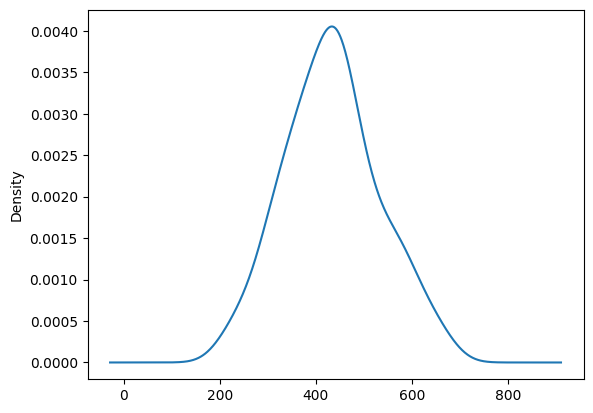

In [ ]:
numerical_df[numerical_df['ElectricalEngg'] > -1]['ElectricalEngg'].plot(kind = 'kde')

The kde plot is platykurtic and almost symmetric (meaning almost no skew) and hence most values are distributed around the mean score of the candidates in this section

<Axes: ylabel='Frequency'>

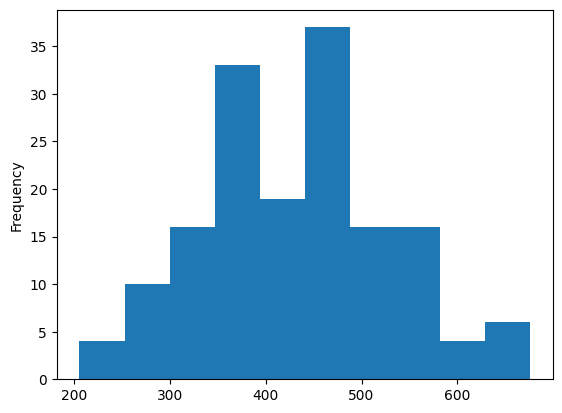

In [ ]:
numerical_df[numerical_df['ElectricalEngg'] > -1]['ElectricalEngg'].plot(kind = 'hist')

Unlike what we expected from the kde plot, the histogram shows the actual distribution of the scores of the candidates\
We can see that there is a dip in the count between 400 to 450 which can be due to the nature of the questions asked in the test where some questions might have closely related answers

<Axes: >

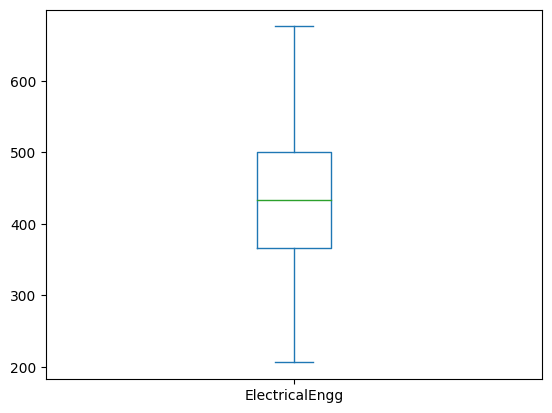

In [ ]:
numerical_df[numerical_df['ElectricalEngg'] > -1]['ElectricalEngg'].plot(kind = 'box')

There are no outliers because the percentage of students who attempted this section is very less compared to the other sections

### Analysis on TelecomEngg

*1) Non-visual analysis*

In [ ]:
numerical_univariate_analysis(numerical_df[['TelecomEngg']])

<----------TelecomEngg---------->
min          -1.000000
max         548.000000
mean         31.851176
median       -1.000000
std         104.852845
skew          3.041261
kurtosis      7.810221
Name: TelecomEngg, dtype: float64


In [ ]:
numerical_df[numerical_df['TelecomEngg'] == -1].shape

(3624, 20)

We can see that very small percentage of the candidates chose Telecom Engg part in AMCAT





---


***So we need not analyse the entirety of candidates in this case and just focus on those actually attempted the section by filtering out the non-attendees***


---



In [ ]:
numerical_univariate_analysis(numerical_df[numerical_df['TelecomEngg'] > -1][['TelecomEngg']])

<----------TelecomEngg---------->
min         153.000000
max         548.000000
mean        350.173797
median      356.000000
std          75.661864
skew          0.197276
kurtosis     -0.282071
Name: TelecomEngg, dtype: float64


*2) Visual analysis*

<Axes: ylabel='Density'>

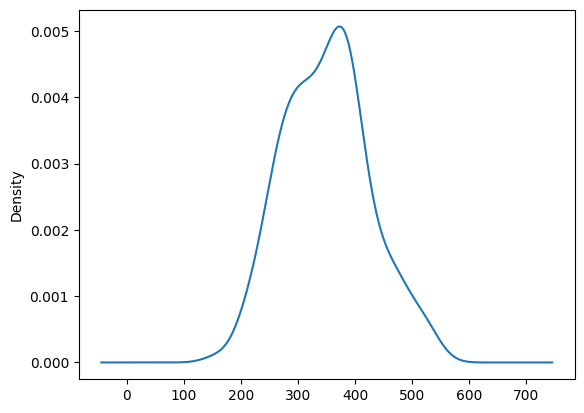

In [ ]:
numerical_df[numerical_df['TelecomEngg'] > -1]['TelecomEngg'].plot(kind = 'kde')

The kde plot is platykurtic and almost symmetric (meaning almost no skew) and hence most values are distributed around the mean score of the candidates in this section

<Axes: ylabel='Frequency'>

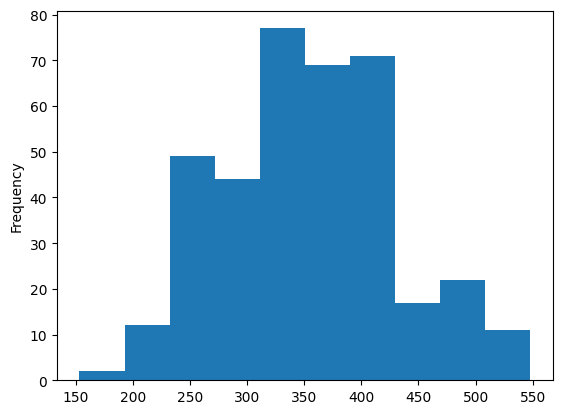

In [ ]:
numerical_df[numerical_df['TelecomEngg'] > -1]['TelecomEngg'].plot(kind = 'hist')

With this plot we can understand why the shape of the kde plot is little weird in shape, with uneven distribution of number of candidates across the range of marks

<Axes: >

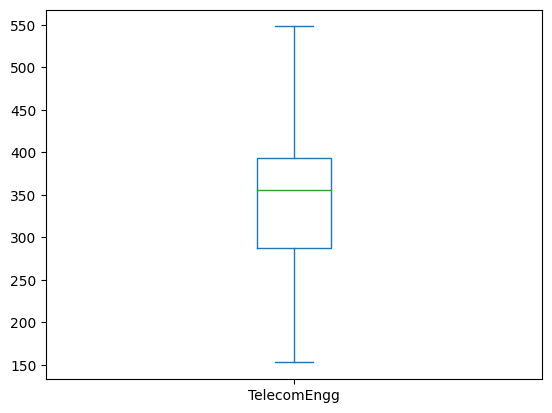

In [ ]:
numerical_df[numerical_df['TelecomEngg'] > -1]['TelecomEngg'].plot(kind = 'box')

There are no outliers because the percentage of students who attempted this section is very less compared to the other sections

### Analysis on CivilEngg

*1) Non-visual analysis*

In [ ]:
numerical_univariate_analysis(numerical_df[['CivilEngg']])

<----------CivilEngg---------->
min          -1.000000
max         516.000000
mean          2.683842
median       -1.000000
std          36.658505
skew         10.315681
kurtosis    109.041349
Name: CivilEngg, dtype: float64


In [ ]:
numerical_df[numerical_df['CivilEngg'] == -1].shape

(3956, 20)

We can see that very small percentage of the candidates chose Electrical Engg part in AMCAT





---


***So we need not analyse the entirety of candidates in this case and just focus on those actually attempted the section by filtering out the non-attendees***


---



In [ ]:
numerical_univariate_analysis(numerical_df[numerical_df['CivilEngg'] > -1][['CivilEngg']])

<----------CivilEngg---------->
min         166.000000
max         516.000000
mean        349.666667
median      348.000000
std          79.784670
skew          0.208857
kurtosis     -0.128203
Name: CivilEngg, dtype: float64


*2) Visual analysis*

<Axes: ylabel='Density'>

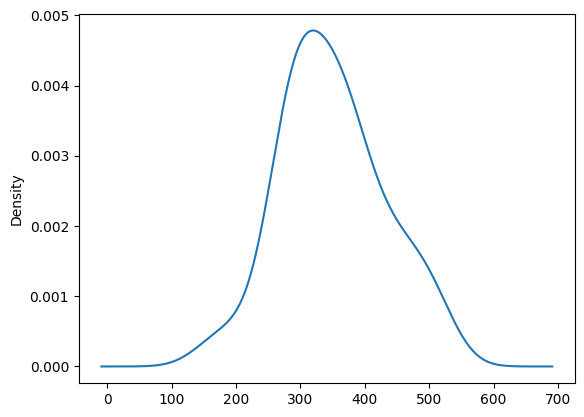

In [ ]:
numerical_df[numerical_df['CivilEngg'] > -1]['CivilEngg'].plot(kind = 'kde')

The kde plot is platykurtic and almost symmetric (meaning almost no skew) and hence most values are distributed around the mean score of the candidates in this section

<Axes: ylabel='Frequency'>

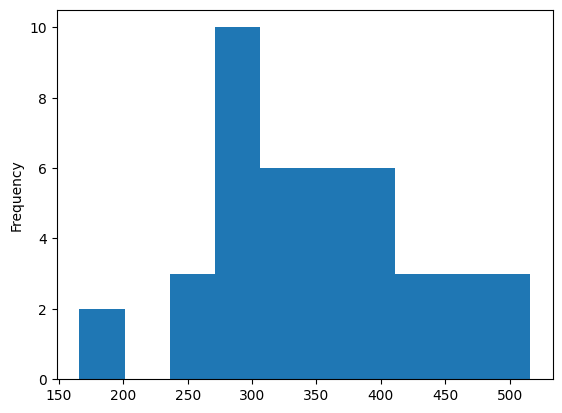

In [ ]:
numerical_df[numerical_df['CivilEngg'] > -1]['CivilEngg'].plot(kind = 'hist')

The number of candidates who attempted the Civil Engg section in AMCAT is very less, and we can clearly see the range with number very clearly

<Axes: >

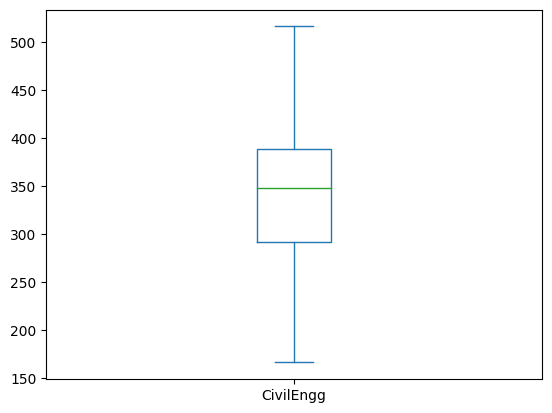

In [ ]:
numerical_df[numerical_df['CivilEngg'] > -1]['CivilEngg'].plot(kind = 'box')

There are no outliers because the percentage of students who attempted this section is very less compared to the other sections

In [ ]:
numerical_df.columns

Index(['Salary', '10percentage', '12percentage', 'collegeGPA', 'English',
       'Logical', 'Quant', 'Domain', 'ComputerProgramming',
       'ElectronicsAndSemicon', 'ComputerScience', 'MechanicalEngg',
       'ElectricalEngg', 'TelecomEngg', 'CivilEngg', 'conscientiousness',
       'agreeableness', 'extraversion', 'nueroticism',
       'openess_to_experience'],
      dtype='object')

### Analysis on conscientiousness

*1) Non-visual analysis*

In [ ]:
numerical_univariate_analysis(numerical_df[['conscientiousness']])

<----------conscientiousness---------->
min        -4.126700
max         1.995300
mean       -0.037831
median      0.046400
std         1.028666
skew       -0.527003
kurtosis    0.122596
Name: conscientiousness, dtype: float64


*2) Visual analysis*

<Axes: ylabel='Density'>

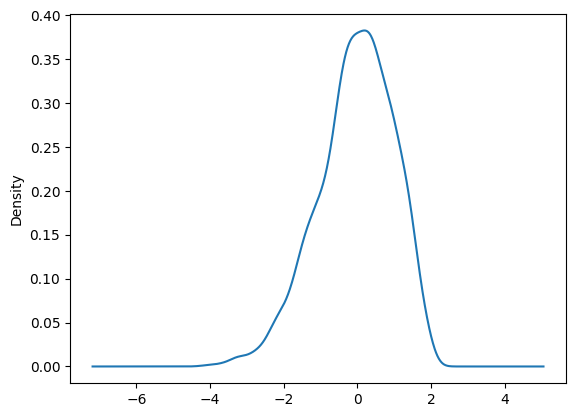

In [ ]:
numerical_df['conscientiousness'].plot(kind = 'kde')

The kde plot is platykurtic and almost symmetric (meaning almost no skew) and hence most values are distributed around the mean score of the candidates in this section

<Axes: ylabel='Frequency'>

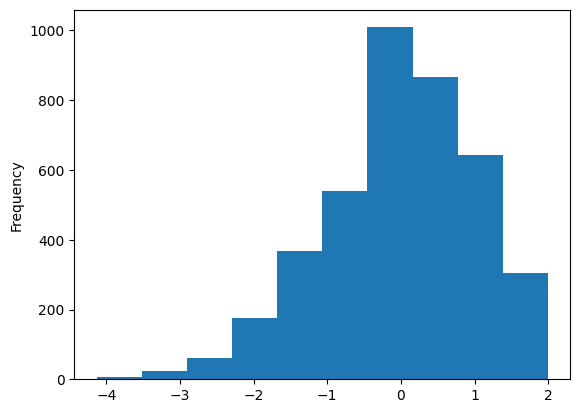

In [ ]:
numerical_df['conscientiousness'].plot(kind = 'hist')

Seems that there are a lot of outliers below that the mean score which can be confirmed with the box plot

<Axes: >

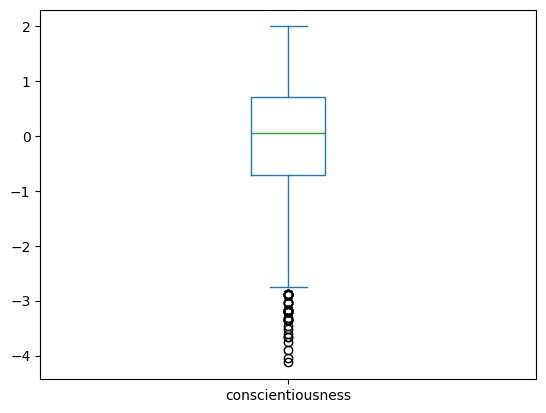

In [ ]:
numerical_df['conscientiousness'].plot(kind = 'box')

The long tail on the left end of the kde plot with the above plot confirms that there a group of around 200 candidates performed poorly in conscientiousness section in AMCAT

### Analysis on agreeableness

*1) Non-visual analysis*

In [ ]:
numerical_univariate_analysis(numerical_df[['agreeableness']])

<----------agreeableness---------->
min        -5.781600
max         1.904800
mean        0.146496
median      0.212400
std         0.941782
skew       -1.204915
kurtosis    3.391242
Name: agreeableness, dtype: float64


*2) Visual analysis*

<Axes: ylabel='Density'>

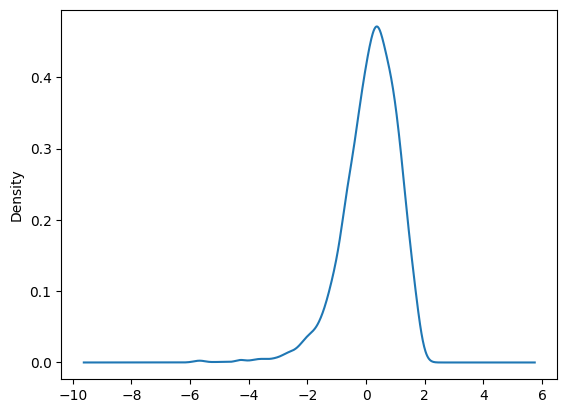

In [ ]:
numerical_df['agreeableness'].plot(kind = 'kde')

The kde plot is platykurtic and is left skewed and hence most values are distributed around the mean score of the candidates in this section and the tail in the suggests a lot of outliers below the mean value which is the reason for the skew

<Axes: ylabel='Frequency'>

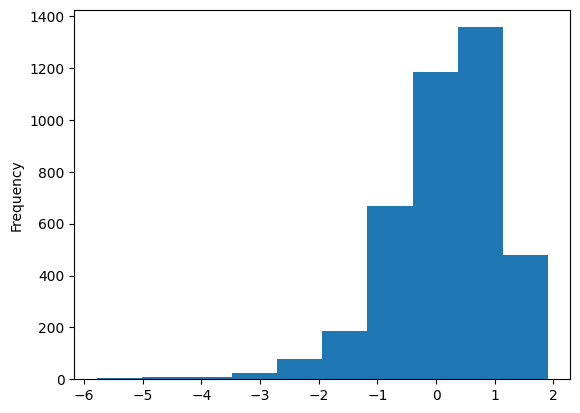

In [ ]:
numerical_df['agreeableness'].plot(kind = 'hist')

Around 300 candidates scored poorly in the agreeableness section in AMCAT, which can see in the above plot

<Axes: >

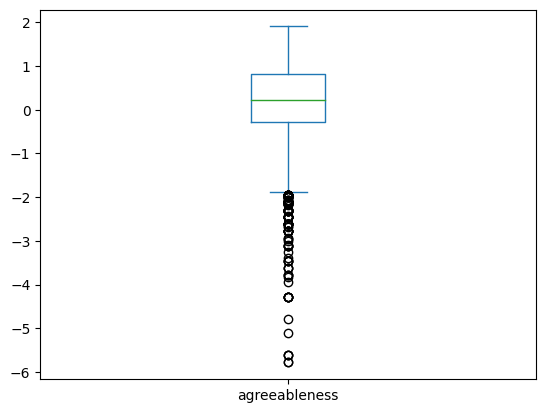

In [ ]:
numerical_df['agreeableness'].plot(kind = 'box')

The outlier candidates can be visualized in the above plot

### Analysis on extraversion

*1) Non-visual analysis*

In [ ]:
numerical_univariate_analysis(numerical_df[['extraversion']])

<----------extraversion---------->
min        -4.600900
max         2.535400
mean        0.002763
median      0.091400
std         0.951471
skew       -0.523267
kurtosis    0.643969
Name: extraversion, dtype: float64


*2) Visual analysis*

<Axes: ylabel='Density'>

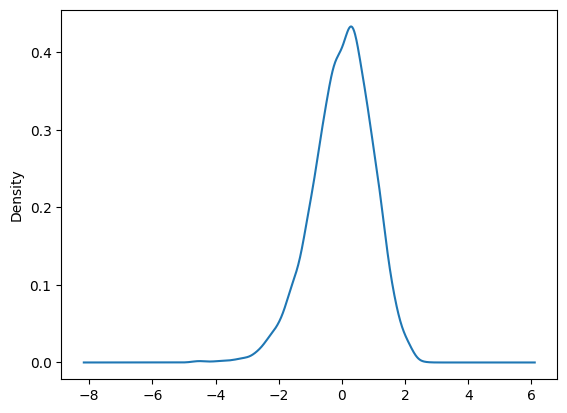

In [ ]:
numerical_df['extraversion'].plot(kind = 'kde')

The kde plot is platykurtic and is left skewed and hence most values are distributed around the mean score of the candidates in this section and the tail in the suggests a lot of outliers below the mean value which is the reason for the skew

<Axes: ylabel='Frequency'>

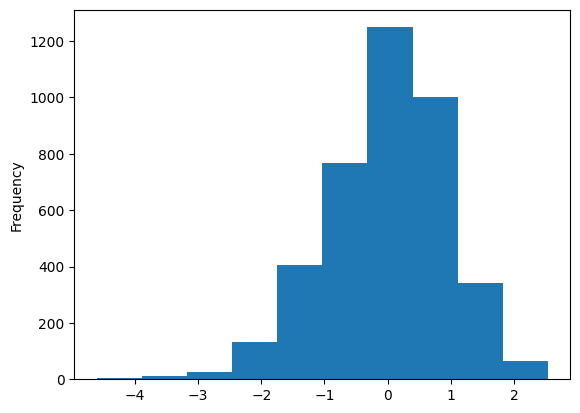

In [ ]:
numerical_df['extraversion'].plot(kind = 'hist')

Around 600 candidates scored poorly in the agreeableness section in AMCAT, which can see in the above plot

<Axes: >

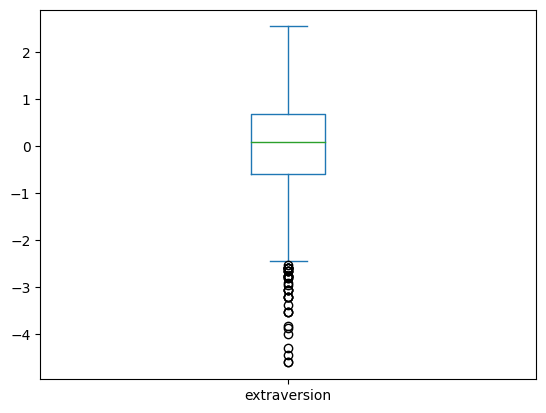

In [ ]:
numerical_df['extraversion'].plot(kind = 'box')

The outlier candidates can be visualized in the above plot

### Analysis on nueroticism

*1) Non-visual analysis*

In [ ]:
numerical_univariate_analysis(numerical_df[['nueroticism']])

<----------nueroticism---------->
min        -2.643000
max         3.352500
mean       -0.169033
median     -0.234400
std         1.007580
skew        0.165710
kurtosis   -0.191539
Name: nueroticism, dtype: float64


*2) Visual analysis*

<Axes: ylabel='Density'>

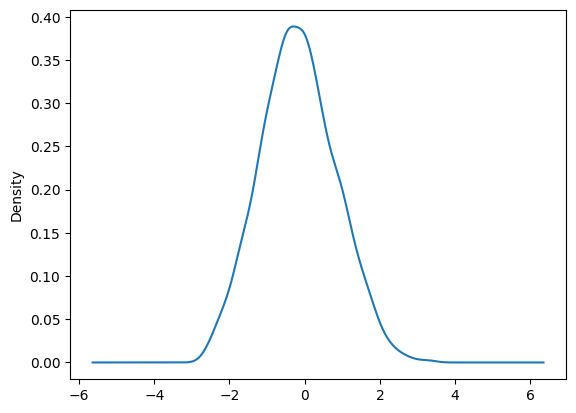

In [ ]:
numerical_df['nueroticism'].plot(kind = 'kde')

The kde plot is platykurtic and almost symmetric (meaning almost no skew) and hence most values are distributed around the mean score of the candidates in this section

<Axes: ylabel='Frequency'>

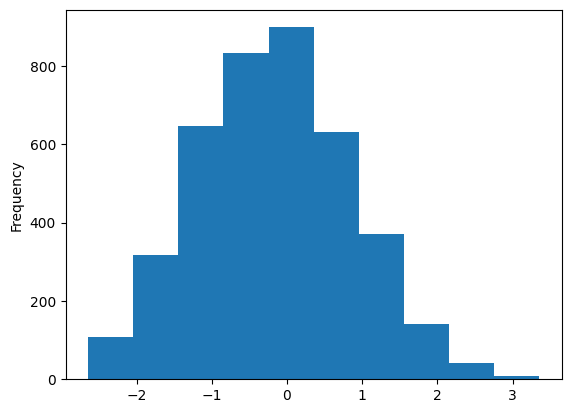

In [ ]:
numerical_df['nueroticism'].plot(kind = 'hist')

Most of the candidates scored around the mean value unlike the previous test sections that were analysed

<Axes: >

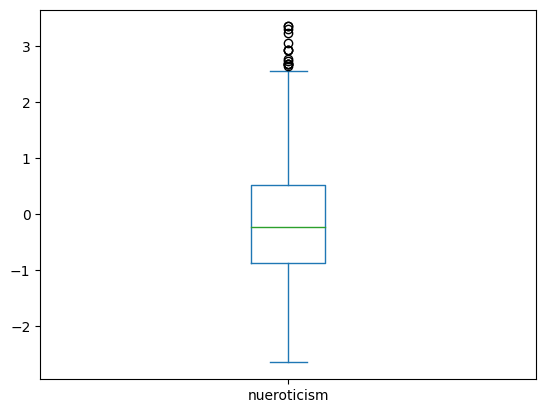

In [ ]:
numerical_df['nueroticism'].plot(kind = 'box')

The longer tail towards the right end in the kde plot suggested the presence of outliers above the mean score and this plot confirms that\
There were around 50 candidates scored above 2 in nueroticism in AMCAT

### Analysis on openess_to_experience

*1) Non-visual analysis*

In [ ]:
numerical_univariate_analysis(numerical_df[['openess_to_experience']])

<----------openess_to_experience---------->
min        -7.375700
max         1.822400
mean       -0.138110
median     -0.094300
std         1.008075
skew       -1.506962
kurtosis    5.788327
Name: openess_to_experience, dtype: float64


*2) Visual analysis*

<Axes: ylabel='Density'>

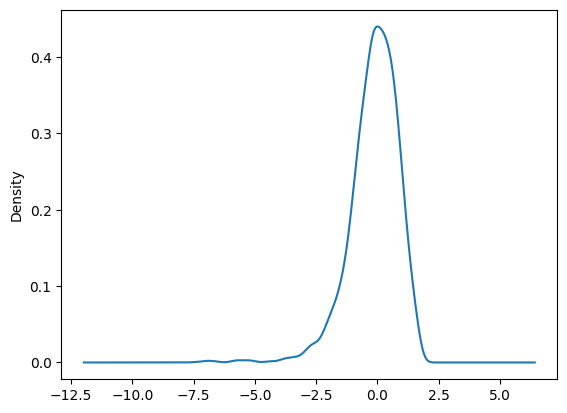

In [ ]:
numerical_df['openess_to_experience'].plot(kind = 'kde')

The kde plot is platykurtic and is left skewed and hence most values are distributed around the mean score of the candidates in this section and the tail in the suggests a lot of outliers below the mean value which is the reason for the skew

<Axes: ylabel='Frequency'>

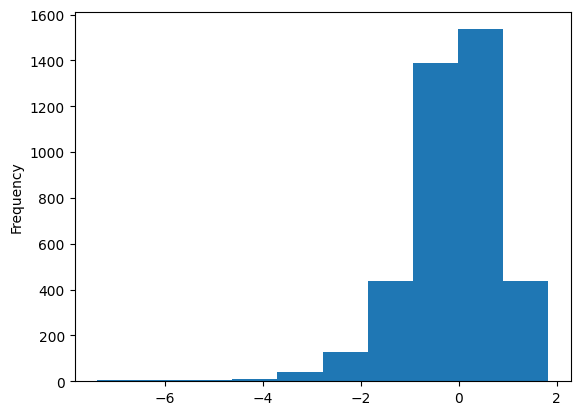

In [ ]:
numerical_df['openess_to_experience'].plot(kind = 'hist')

Around 600 candidates scored poorly in the openess_to_experience section in AMCAT, which can see in the above plot, and most of the other candidates scored close to the average score scored by the entirety of the candidates

<Axes: >

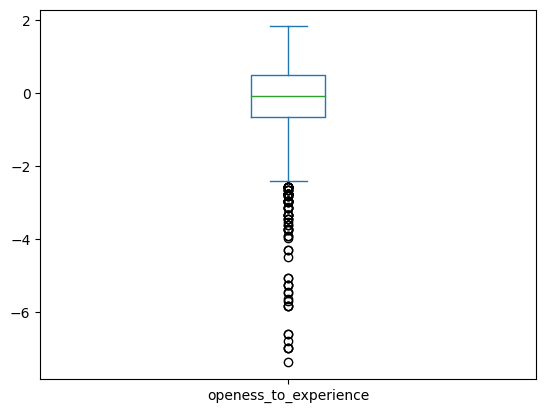

In [ ]:
numerical_df['openess_to_experience'].plot(kind = 'box')

The outlier candidates can be visualized in the above plot

## Performing Univariate Analysis on the categorical columns

### Analysis on 12th graduation

*1) Non-visual analysis*

In [ ]:
categorical_df['12graduation'].unique()

array([2007, 2010, 2008, 2009, 2006, 2011, 2005, 1995, 2004, 2012, 2003,
       2002, 2001, 1998, 2013, 1999])

In [ ]:
categorical_df['12graduation'].nunique()

16

In [ ]:
categorical_df['12graduation'].value_counts()

,count
12graduation,
2009,1052
2008,935
2010,742
2007,528
2006,407
2005,160
2004,73
2011,46
2003,25


*2) Visual analysis*

<Axes: ylabel='12graduation'>

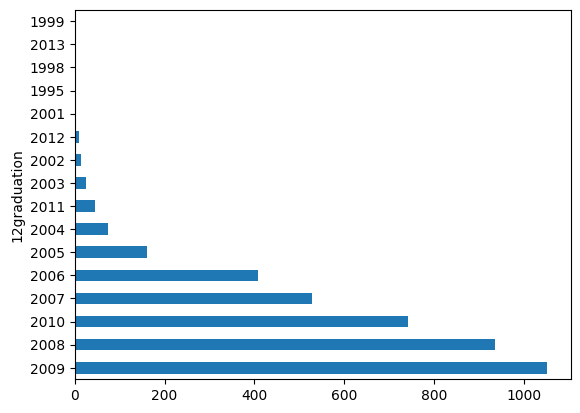

In [ ]:
categorical_df['12graduation'].value_counts().plot(kind = 'barh')

Most of the candidates graduated their 12th standard in the years of 2008 to 2010

### Analysis on Designation

*1) Non-visual analysis*

In [ ]:
categorical_df['Designation'].unique()

array(['senior quality engineer', 'assistant manager', 'systems engineer',
       'senior software engineer', 'get', 'system engineer',
       'java software engineer', 'mechanical engineer',
       'electrical engineer', 'project engineer', 'senior php developer',
       'senior systems engineer', 'quality assurance engineer',
       'qa analyst', 'network engineer', 'product development engineer',
       'associate software developer', 'data entry operator',
       'software engineer', 'developer', 'electrical project engineer',
       'programmer analyst', 'systems analyst', 'ase',
       'telecommunication engineer', 'application developer',
       'ios developer', 'executive assistant', 'online marketing manager',
       'documentation specialist', 'associate software engineer',
       'management trainee', 'site manager', 'software developer',
       '.net developer', 'production engineer', 'jr. software engineer',
       'trainee software developer', 'ui developer',
       'assi

In [ ]:
categorical_df['Designation'].nunique()

419

In [ ]:
categorical_df['Designation'].value_counts()

,count
Designation,
software engineer,539
software developer,265
system engineer,205
programmer analyst,139
systems engineer,118
...,...
cad drafter,1
noc engineer,1
human resources intern,1


*2) Visual analysis*

<Axes: ylabel='Designation'>

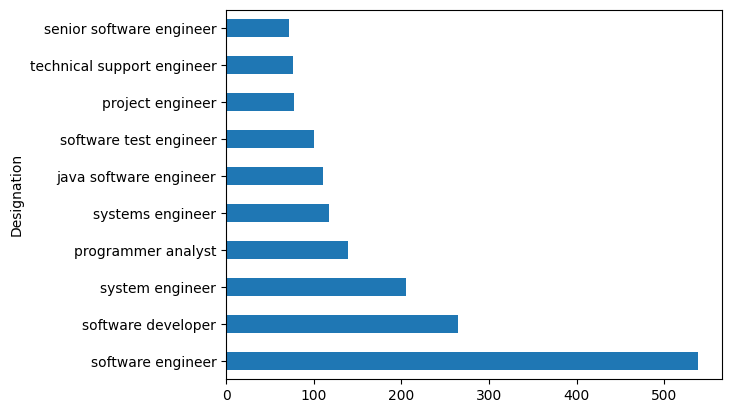

In [ ]:
categorical_df['Designation'].value_counts()[:10].plot(kind = 'barh')

Most of the candidates are either working or worked as software engineers or developers

### Analysis on Job City

*1) Non-visual analysis*

In [ ]:
categorical_df['JobCity'].nunique()

339

In [ ]:
categorical_df['JobCity'].unique()

array(['Bangalore', 'Indore', 'Chennai', 'Gurgaon', 'Manesar',
       'Hyderabad', 'Banglore', 'Noida', 'Kolkata', 'Pune', -1, 'mohali',
       'Jhansi', 'Delhi', 'Hyderabad ', 'Bangalore ', 'noida', 'delhi',
       'Bhubaneswar', 'Navi Mumbai', 'Mumbai', 'New Delhi', 'Mangalore',
       'Rewari', 'Gaziabaad', 'Bhiwadi', 'Mysore', 'Rajkot',
       'Greater Noida', 'Jaipur', 'noida ', 'HYDERABAD', 'mysore',
       'THANE', 'Maharajganj', 'Thiruvananthapuram', 'Punchkula',
       'Bhubaneshwar', 'Pune ', 'coimbatore', 'Dhanbad', 'Lucknow',
       'Trivandrum', 'kolkata', 'mumbai', 'Gandhi Nagar', 'Una',
       'Daman and Diu', 'chennai', 'GURGOAN', 'vsakhapttnam', 'pune',
       'Nagpur', 'Bhagalpur', 'new delhi - jaisalmer', 'Coimbatore',
       'Ahmedabad', 'Kochi/Cochin', 'Bankura', 'Bengaluru', 'Mysore ',
       'Kanpur ', 'jaipur', 'Gurgaon ', 'bangalore', 'CHENNAI',
       'Vijayawada', 'Kochi', 'Beawar', 'Alwar', 'NOIDA', 'Greater noida',
       'Siliguri ', 'raipur', 'gurgaon', '

In [ ]:
categorical_df['JobCity'].value_counts()

,count
JobCity,
Bangalore,627
-1,461
Noida,368
Hyderabad,335
Pune,290
...,...
Tirunelvelli,1
Ernakulam,1
Nanded,1


*2) Visual analysis*

<Axes: ylabel='JobCity'>

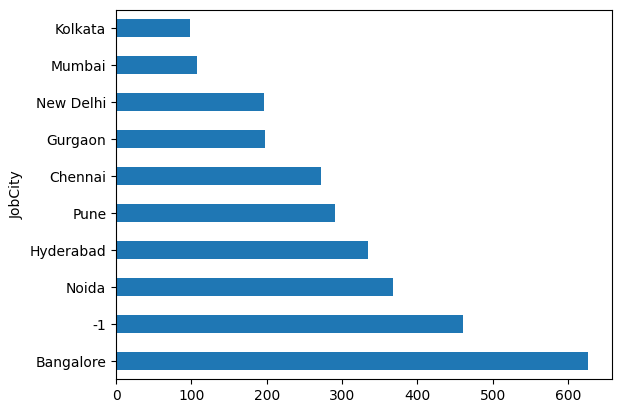

In [ ]:
categorical_df['JobCity'].value_counts()[:10].plot(kind = 'barh')

Most of the candidates are either working or worked in Banglore and Noida\
Some candidates seemed not to mention their job location where they worked or working

### Analysis on Gender

*1) Non-visual analysis*

In [ ]:
categorical_df['Gender'].nunique()

2

In [ ]:
categorical_df['Gender'].unique()

array(['f', 'm'], dtype=object)

In [ ]:
categorical_df['Gender'].value_counts()

,count
Gender,
m,3041
f,957


*2) Visual analysis*

<Axes: ylabel='Gender'>

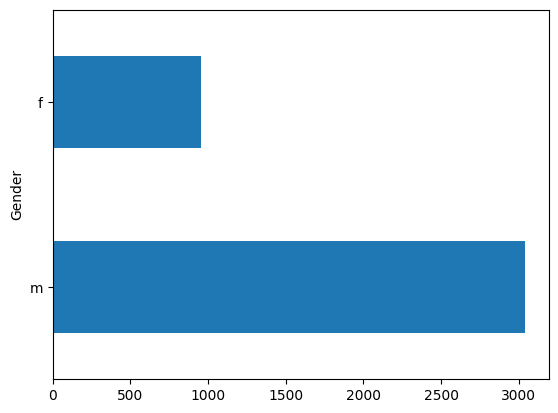

In [ ]:
categorical_df['Gender'].value_counts().plot(kind = 'barh')

Around 76% of the candidates who took AMCAT were male

### Analysis on 12th board

*1) Non-visual analysis*

In [ ]:
categorical_df['12board'].nunique()

340

In [ ]:
categorical_df['12board'].unique()

array(['board of intermediate education,ap', 'cbse', 'state board',
       'mp board', 'isc', 'icse', 'karnataka pre university board', 'up',
       'p u board, karnataka', 'dept of pre-university education', 'bie',
       'kerala state hse board', 'up board', 0, 'bseb', 'chse', 'puc',
       ' upboard',
       'state  board of intermediate education, andhra pradesh',
       'karnataka state board',
       'west bengal state council of technical education', 'wbchse',
       'maharashtra state board', 'ssc', 'isc board',
       'sda matric higher secondary school', 'uttar pradesh board', 'ibe',
       'chsc', 'board of intermediate', 'isce', 'upboard', 'sbtet',
       'hisher seconadry examination(state board)', 'pre university',
       'borad of intermediate', 'j & k board',
       'intermediate board of andhra pardesh', 'rbse',
       'central board of secondary education', 'jkbose', 'hbse',
       'board of intermediate education', 'state', 'ms board', 'pue',
       'intermediate sta

In [ ]:
categorical_df['12board'].value_counts()

,count
12board,
cbse,1400
state board,1254
0,359
icse,129
up board,87
...,...
jawahar higher secondary school,1
nagpur board,1
bsemp,1


*2) Visual analysis*

<Axes: ylabel='12board'>

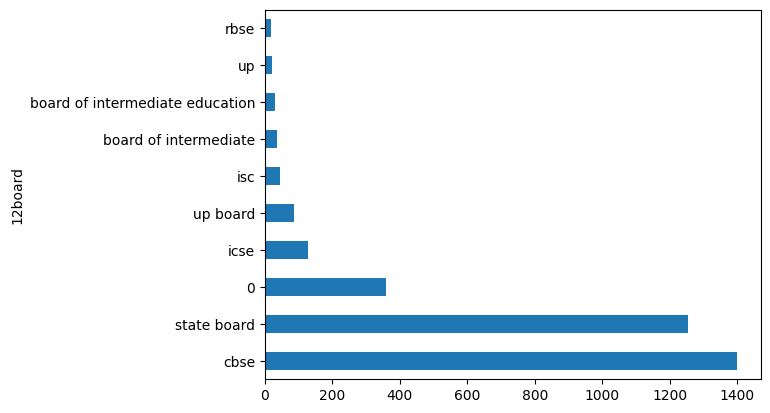

In [ ]:
categorical_df['12board'].value_counts()[:10].plot(kind = 'barh')

Most of the candidates did their schooling in CBSE and state board

### Analysis on College City Tier

*1) Non-visual analysis*

In [ ]:
categorical_df['CollegeCityTier'].nunique()

2

In [ ]:
categorical_df['CollegeCityTier'].unique()

array([0, 1])

In [ ]:
categorical_df['CollegeCityTier'].value_counts()

,count
CollegeCityTier,
0,2797
1,1201


*2) Visual analysis*

<Axes: ylabel='CollegeCityTier'>

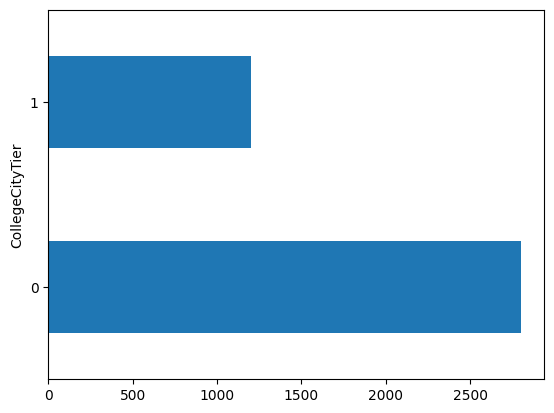

In [ ]:
categorical_df['CollegeCityTier'].value_counts()[:10].plot(kind = 'barh')

More than half of the candidates graduated their college from tier 0 cities

### Analysis on College Tier

*1) Non-visual analysis*

In [ ]:
categorical_df['CollegeTier'].nunique()

2

In [ ]:
categorical_df['CollegeTier'].unique()

array([2, 1])

In [ ]:
categorical_df['CollegeTier'].value_counts()

,count
CollegeTier,
2,3701
1,297


*2) Visual analysis*

<Axes: ylabel='CollegeTier'>

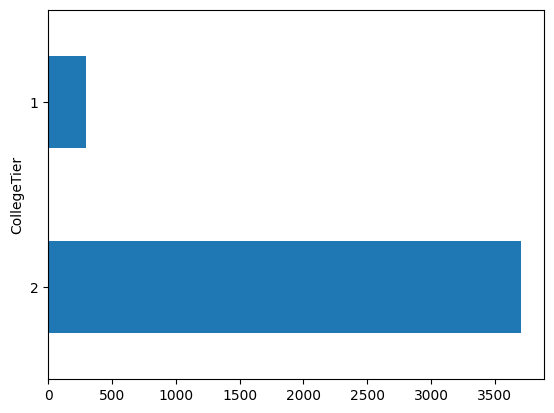

In [ ]:
categorical_df['CollegeTier'].value_counts()[:10].plot(kind = 'barh')

But more than 90% of the candidates graduated their college from tier 2 colleges

### Analysis on Degree

*1) Non-visual analysis*

In [ ]:
categorical_df['Degree'].nunique()

4

In [ ]:
categorical_df['Degree'].unique()

array(['B.Tech/B.E.', 'MCA', 'M.Tech./M.E.', 'M.Sc. (Tech.)'],
      dtype=object)

In [ ]:
categorical_df['Degree'].value_counts()

,count
Degree,
B.Tech/B.E.,3700
MCA,243
M.Tech./M.E.,53
M.Sc. (Tech.),2


*2) Visual analysis*

<Axes: ylabel='Degree'>

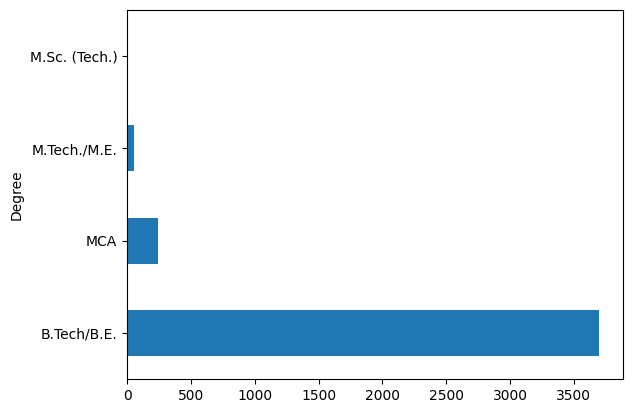

In [ ]:
categorical_df['Degree'].value_counts().plot(kind = 'barh')

92.5% of the candidates those who took AMCAT graduated only their UG degree while the rest of 7.5% of the candidates went on to complete their Masters' as well

### Analysis on Specialization

*1) Non-visual analysis*

In [ ]:
categorical_df['Specialization'].nunique()

46

In [ ]:
categorical_df['Specialization'].unique()

array(['computer engineering',
       'electronics and communication engineering',
       'information technology', 'computer science & engineering',
       'mechanical engineering', 'electronics and electrical engineering',
       'electronics & telecommunications',
       'instrumentation and control engineering', 'computer application',
       'electronics and computer engineering', 'electrical engineering',
       'applied electronics and instrumentation',
       'electronics & instrumentation eng',
       'information science engineering', 'civil engineering',
       'mechanical and automation', 'industrial & production engineering',
       'control and instrumentation engineering',
       'metallurgical engineering',
       'electronics and instrumentation engineering',
       'electronics engineering', 'ceramic engineering',
       'chemical engineering', 'aeronautical engineering', 'other',
       'biotechnology', 'embedded systems technology',
       'electrical and power engi

In [ ]:
categorical_df['Specialization'].value_counts()

,count
Specialization,
electronics and communication engineering,880
computer science & engineering,744
information technology,660
computer engineering,600
computer application,244
mechanical engineering,201
electronics and electrical engineering,196
electronics & telecommunications,121
electrical engineering,82


*2) Visual analysis*

<Axes: ylabel='Specialization'>

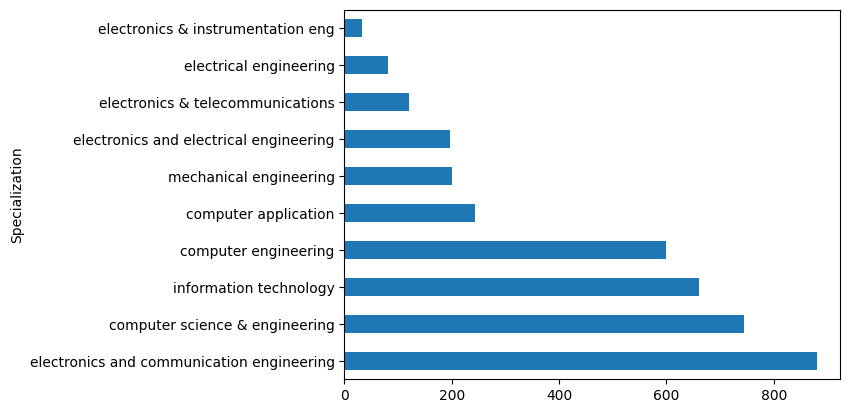

In [ ]:
categorical_df['Specialization'].value_counts()[:10].plot(kind = 'barh')

Surprisingly there were more Electronics and Communication Engineering graduates than Computer Science Engineering who have taken this test and are software professionals

### Analysis on DOJ Year

*1) Non-visual analysis*

In [ ]:
categorical_df['DOJ_year'].nunique()

12

In [ ]:
categorical_df['DOJ_year'].info()

<class 'pandas.core.series.Series'>
RangeIndex: 3998 entries, 0 to 3997
Series name: DOJ_year
Non-Null Count  Dtype
--------------  -----
3998 non-null   int32
dtypes: int32(1)
memory usage: 15.7 KB


In [ ]:
categorical_df['DOJ_year'].unique()

array([2012, 2013, 2014, 2011, 2010, 2015, 2009, 2004, 2008, 2006, 2007,
       1991], dtype=int32)

In [ ]:
categorical_df['DOJ_year'].value_counts()

,count
DOJ_year,
2014,1596
2013,1004
2012,590
2011,381
2015,248
2010,166
2009,5
2007,4
2004,1


*2) Visual analysis*

<Axes: ylabel='DOJ_year'>

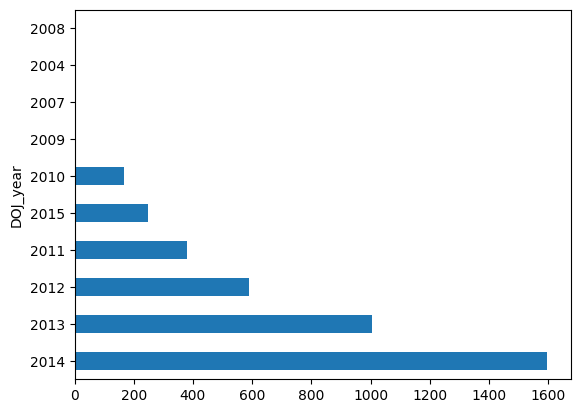

In [ ]:
categorical_df['DOJ_year'].value_counts()[:10].plot(kind = 'barh')

Most of the candidates joined in a company by the time they applied for the AMCAT (2014)

### Analysis on DOL Year

*1) Non-visual analysis*

In [ ]:
categorical_df['DOL_year'].nunique()

10

In [ ]:
categorical_df['DOL_year'].info()

<class 'pandas.core.series.Series'>
RangeIndex: 3998 entries, 0 to 3997
Series name: DOL_year
Non-Null Count  Dtype 
--------------  ----- 
3998 non-null   object
dtypes: object(1)
memory usage: 31.4+ KB


In [ ]:
categorical_df['DOL_year'].unique()

array(['present', 2015, 2014, 2012, 2013, 2011, 2005, 2010, 2009, 2008],
      dtype=object)

In [ ]:
categorical_df['DOL_year'].value_counts()

,count
DOL_year,
present,1875
2015,1059
2014,646
2013,255
2012,116
2011,40
2010,4
2005,1
2009,1


*2) Visual analysis*

<Axes: ylabel='DOL_year'>

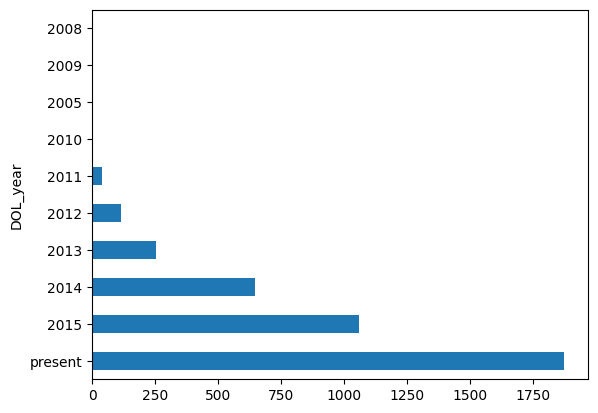

In [ ]:
categorical_df['DOL_year'].value_counts()[:10].plot(kind = 'barh')

Most of the candidates who took AMCAT where currently working professionals (as of 2015) and the second most of the candidates left the company in 2015, which might be after taking the AMCAT and scoring well in that

### Analysis on DOB Year

*1) Non-visual analysis*

In [ ]:
categorical_df['DOB_year'].nunique()

17

In [ ]:
categorical_df['DOB_year'].info()

<class 'pandas.core.series.Series'>
RangeIndex: 3998 entries, 0 to 3997
Series name: DOB_year
Non-Null Count  Dtype
--------------  -----
3998 non-null   int32
dtypes: int32(1)
memory usage: 15.7 KB


In [ ]:
categorical_df['DOB_year'].unique()

array([1990, 1989, 1992, 1991, 1993, 1987, 1988, 1986, 1994, 1977, 1985,
       1995, 1997, 1983, 1984, 1981, 1982], dtype=int32)

In [ ]:
categorical_df['DOB_year'].value_counts()

,count
DOB_year,
1991,979
1992,855
1990,774
1989,522
1988,308
1993,299
1987,116
1986,62
1994,31


*2) Visual analysis*

<Axes: ylabel='DOB_year'>

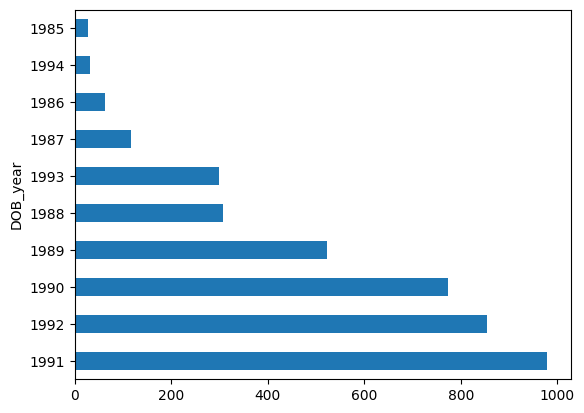

In [ ]:
categorical_df['DOB_year'].value_counts()[:10].plot(kind = 'barh')

Most of the candidates who took AMCAT where 90s born hence suggesting the large number of undergradutes than post graduates who took AMCAT

### Analysis on College State

*1) Non-visual analysis*

In [ ]:
categorical_df['CollegeState'].nunique()

26

In [ ]:
categorical_df['CollegeState'].info()

<class 'pandas.core.series.Series'>
RangeIndex: 3998 entries, 0 to 3997
Series name: CollegeState
Non-Null Count  Dtype 
--------------  ----- 
3998 non-null   object
dtypes: object(1)
memory usage: 31.4+ KB


In [ ]:
categorical_df['CollegeState'].unique()

array(['Andhra Pradesh', 'Madhya Pradesh', 'Uttar Pradesh', 'Delhi',
       'Karnataka', 'Tamil Nadu', 'West Bengal', 'Maharashtra', 'Haryana',
       'Telangana', 'Orissa', 'Punjab', 'Kerala', 'Gujarat', 'Rajasthan',
       'Chhattisgarh', 'Uttarakhand', 'Jammu and Kashmir', 'Jharkhand',
       'Himachal Pradesh', 'Bihar', 'Assam', 'Goa', 'Sikkim',
       'Union Territory', 'Meghalaya'], dtype=object)

In [ ]:
categorical_df['CollegeState'].value_counts()

,count
CollegeState,
Uttar Pradesh,915
Karnataka,370
Tamil Nadu,367
Telangana,319
Maharashtra,262
Andhra Pradesh,225
West Bengal,196
Punjab,193
Madhya Pradesh,189


*2) Visual analysis*

<Axes: ylabel='CollegeState'>

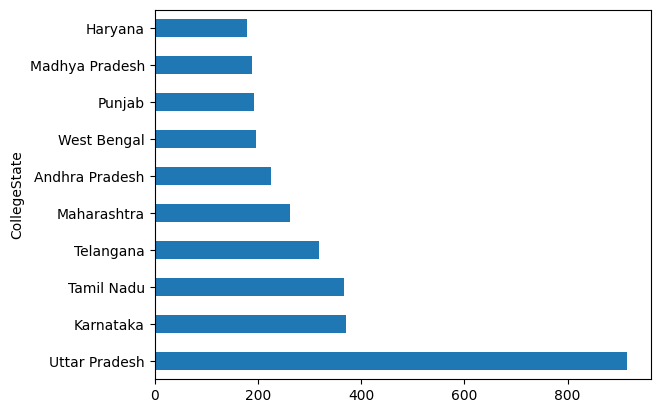

In [ ]:
categorical_df['CollegeState'].value_counts()[:10].plot(kind = 'barh')

There was at least one candidate from almost all the states and union territories with maximum nuber of candidates from UP followed by Karnataka and Tamil Nadu

### Analysis on Graduation Year

*1) Non-visual analysis*

In [ ]:
categorical_df['GraduationYear'].nunique()

11

In [ ]:
categorical_df['GraduationYear'].info()

<class 'pandas.core.series.Series'>
RangeIndex: 3998 entries, 0 to 3997
Series name: GraduationYear
Non-Null Count  Dtype
--------------  -----
3998 non-null   int64
dtypes: int64(1)
memory usage: 31.4 KB


In [ ]:
categorical_df['GraduationYear'].unique()

array([2011, 2012, 2014, 2016, 2013, 2010, 2015, 2009, 2017,    0, 2007])

In [ ]:
categorical_df['GraduationYear'].value_counts()

,count
GraduationYear,
2013,1181
2014,1036
2012,847
2011,507
2010,292
2015,94
2009,24
2017,8
2016,7


*2) Visual analysis*

<Axes: ylabel='GraduationYear'>

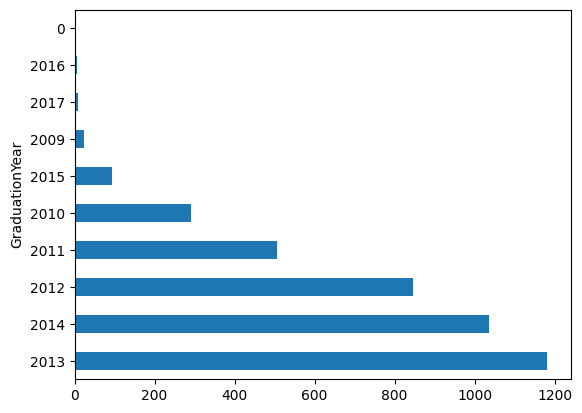

In [ ]:
categorical_df['GraduationYear'].value_counts()[:10].plot(kind = 'barh')

Most of the candidates who took AMCAT graduates in 2013 and 2014 suggesting a lot of reattempting the same and lot others were freshers

# Step 4: Bivariate Analysis

## Performing Bivariate Analysis on the Numerical VS Numerical columns

In [53]:
numerical_df.head()

,Salary,10percentage,12percentage,collegeGPA,English,Logical,Quant,Domain,ComputerProgramming,ElectronicsAndSemicon,ComputerScience,MechanicalEngg,ElectricalEngg,TelecomEngg,CivilEngg,conscientiousness,agreeableness,extraversion,nueroticism,openess_to_experience
0,420000,84.3,95.8,78.00,515,585,525,0.635979,445,-1,-1,-1,-1,-1,-1,0.9737,0.8128,0.5269,1.35490,-0.4455
1,500000,85.4,85.0,70.06,695,610,780,0.960603,-1,466,-1,-1,-1,-1,-1,-0.7335,0.3789,1.2396,-0.10760,0.8637
2,325000,85.0,68.2,70.00,615,545,370,0.450877,395,-1,-1,-1,-1,-1,-1,0.2718,1.7109,0.1637,-0.86820,0.6721
3,1100000,85.6,83.6,74.64,635,585,625,0.974396,615,-1,-1,-1,-1,-1,-1,0.0464,0.3448,-0.3440,-0.40780,-0.9194
4,200000,78.0,76.8,73.90,545,625,465,0.124502,-1,233,-1,-1,-1,-1,-1,-0.8810,-0.2793,-1.0697,0.09163,-0.1295


In [54]:
numerical_df.shape[1]

20

In [55]:
numerical_df.columns

Index(['Salary', '10percentage', '12percentage', 'collegeGPA', 'English',
       'Logical', 'Quant', 'Domain', 'ComputerProgramming',
       'ElectronicsAndSemicon', 'ComputerScience', 'MechanicalEngg',
       'ElectricalEngg', 'TelecomEngg', 'CivilEngg', 'conscientiousness',
       'agreeableness', 'extraversion', 'nueroticism',
       'openess_to_experience'],
      dtype='object')

### 1) Salary VS Rest of the numerical columns

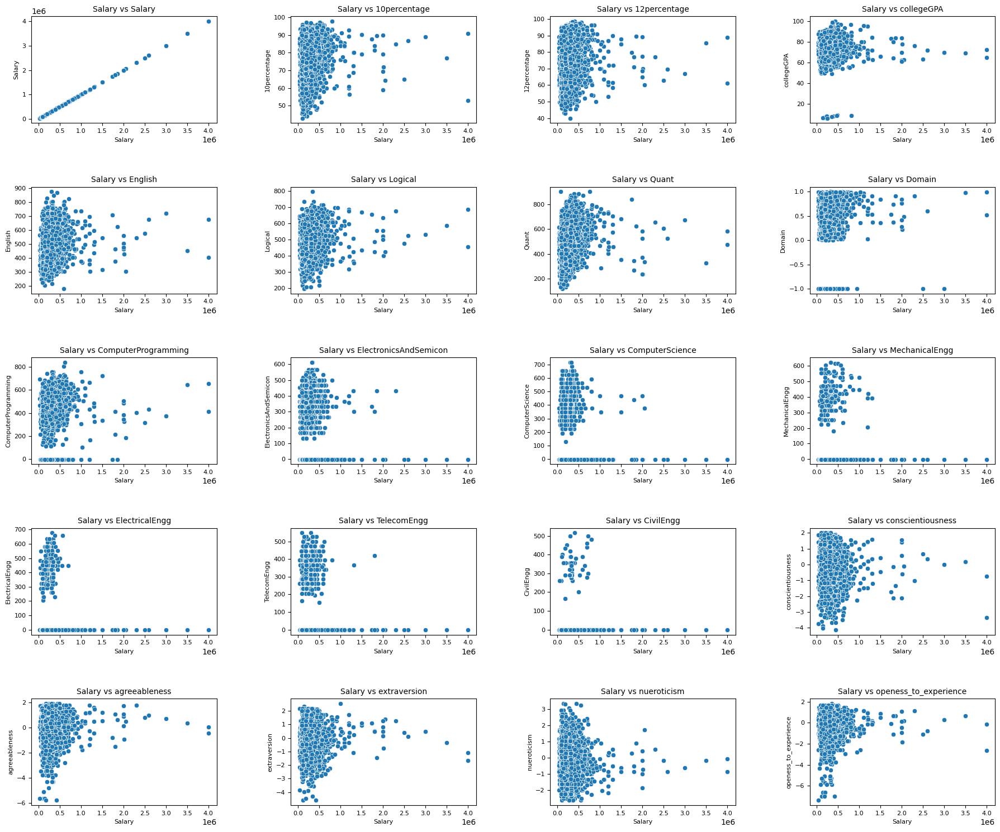

In [56]:
x_col = 'Salary'
fig, axes = plt.subplots(nrows=5, ncols=4, figsize=(18, 15))
axes = axes.flatten()
for i, col in enumerate(numerical_df.columns):
        sns.scatterplot(x=numerical_df[x_col], y=numerical_df[col], ax=axes[i])
        axes[i].set_title(f'{x_col} vs {col}', fontsize=10)
        axes[i].set_xlabel(x_col, fontsize=8)
        axes[i].set_ylabel(col, fontsize=8)
        axes[i].tick_params(axis='both', which='major', labelsize=8)
for j in range(i+1, len(axes)):
    fig.delaxes(axes[j])
plt.tight_layout()
plt.subplots_adjust(wspace=0.4, hspace=0.6)
plt.show()

### 2) 10th Percentage VS Rest of the numerical columns

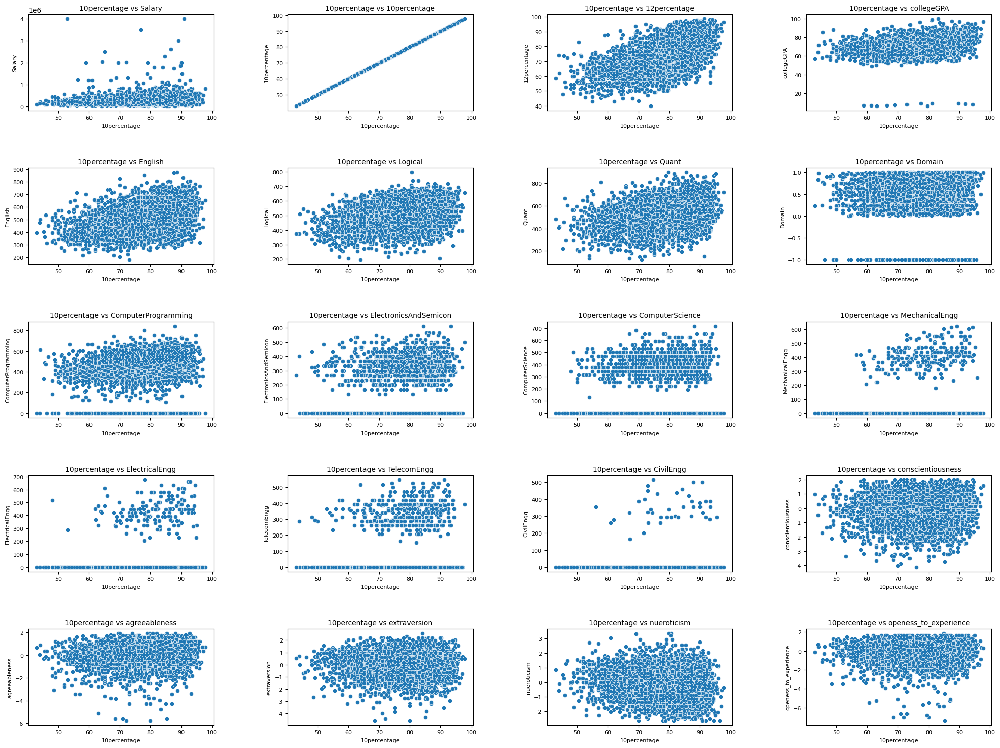

In [57]:
x_col = '10percentage'
fig, axes = plt.subplots(nrows=5, ncols=4, figsize=(20, 15))
axes = axes.flatten()
for i, col in enumerate(numerical_df.columns):
        sns.scatterplot(x=numerical_df[x_col], y=numerical_df[col], ax=axes[i])
        axes[i].set_title(f'{x_col} vs {col}', fontsize=10)
        axes[i].set_xlabel(x_col, fontsize=8)
        axes[i].set_ylabel(col, fontsize=8)
        axes[i].tick_params(axis='both', which='major', labelsize=8)
for j in range(i+1, len(axes)):
    fig.delaxes(axes[j])
plt.tight_layout()
plt.subplots_adjust(wspace=0.4, hspace=0.6)
plt.show()

### 3) 12th Percentage VS Rest of the numerical columns

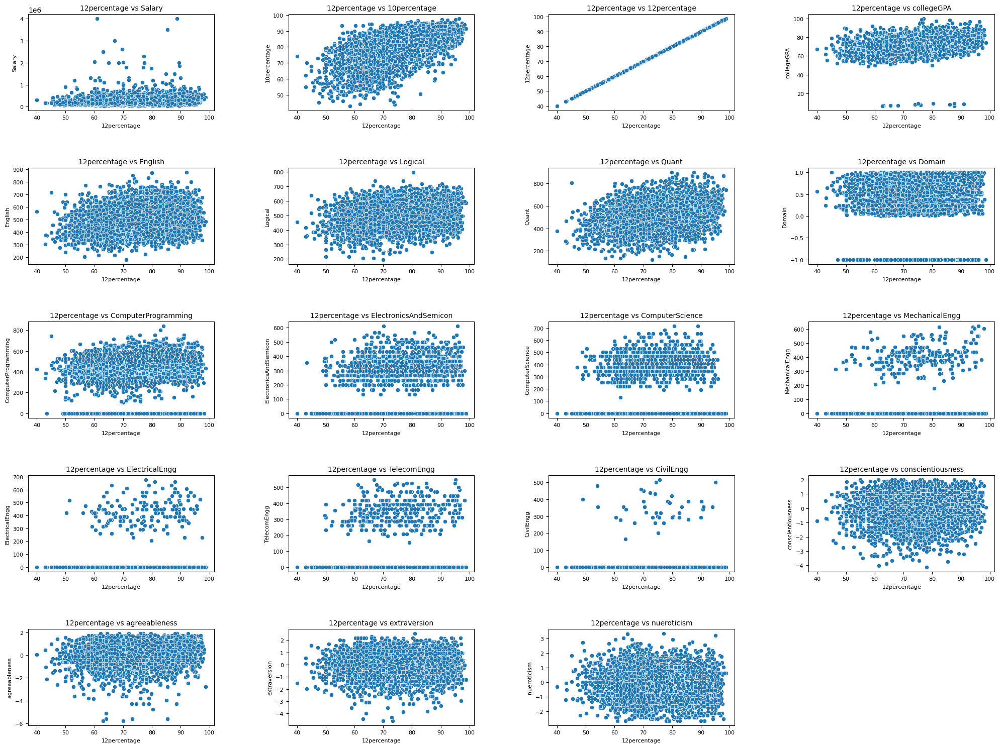

In [58]:
x_col = '12percentage'
fig, axes = plt.subplots(nrows=5, ncols=4, figsize=(20, 15))
axes = axes.flatten()
for i, col in enumerate(numerical_df.columns):
        sns.scatterplot(x=numerical_df[x_col], y=numerical_df[col], ax=axes[i])
        axes[i].set_title(f'{x_col} vs {col}', fontsize=10)
        axes[i].set_xlabel(x_col, fontsize=8)
        axes[i].set_ylabel(col, fontsize=8)
        axes[i].tick_params(axis='both', which='major', labelsize=8)
for j in range(i, len(axes)):
    fig.delaxes(axes[j])
plt.tight_layout()
plt.subplots_adjust(wspace=0.4, hspace=0.6)
plt.show()

### 4) College GPA VS Rest of the numerical columns

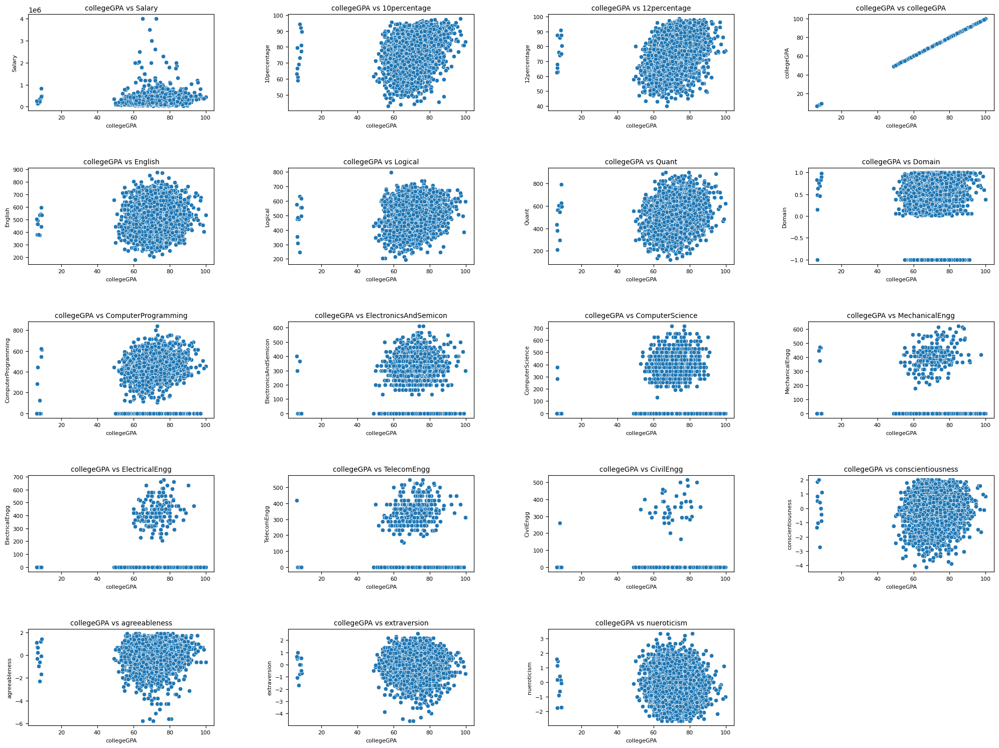

In [59]:
x_col = 'collegeGPA'
fig, axes = plt.subplots(nrows=5, ncols=4, figsize=(20, 15))
axes = axes.flatten()
for i, col in enumerate(numerical_df.columns):
        sns.scatterplot(x=numerical_df[x_col], y=numerical_df[col], ax=axes[i])
        axes[i].set_title(f'{x_col} vs {col}', fontsize=10)
        axes[i].set_xlabel(x_col, fontsize=8)
        axes[i].set_ylabel(col, fontsize=8)
        axes[i].tick_params(axis='both', which='major', labelsize=8)
for j in range(i, len(axes)):
    fig.delaxes(axes[j])
plt.tight_layout()
plt.subplots_adjust(wspace=0.4, hspace=0.6)
plt.show()

### 5) English VS Rest of the numerical columns

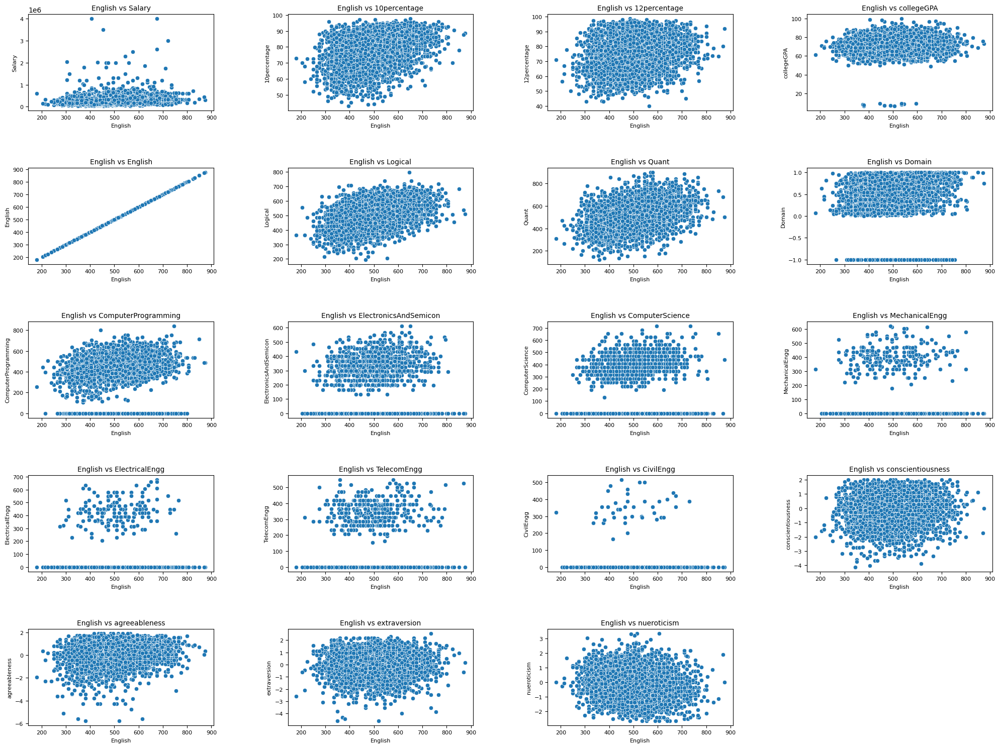

In [60]:
x_col = 'English'
fig, axes = plt.subplots(nrows=5, ncols=4, figsize=(20, 15))
axes = axes.flatten()
for i, col in enumerate(numerical_df.columns):
        sns.scatterplot(x=numerical_df[x_col], y=numerical_df[col], ax=axes[i])
        axes[i].set_title(f'{x_col} vs {col}', fontsize=10)
        axes[i].set_xlabel(x_col, fontsize=8)
        axes[i].set_ylabel(col, fontsize=8)
        axes[i].tick_params(axis='both', which='major', labelsize=8)
for j in range(i, len(axes)):
    fig.delaxes(axes[j])
plt.tight_layout()
plt.subplots_adjust(wspace=0.4, hspace=0.6)
plt.show()

### 6) Logical VS Rest of the numerical columns

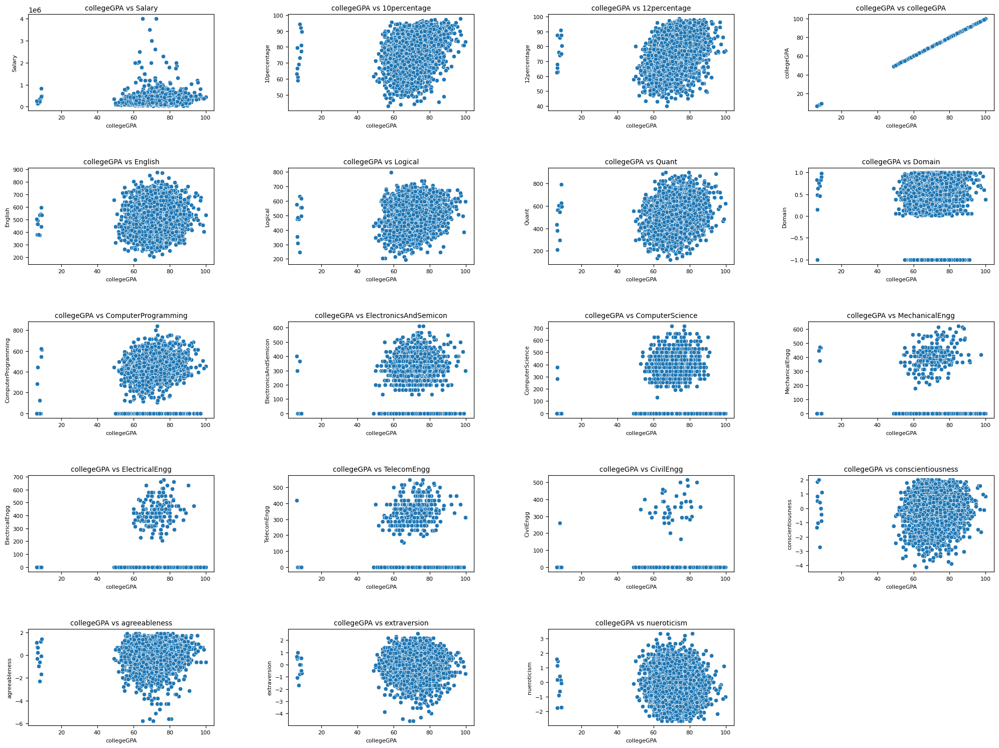

In [61]:
x_col = 'collegeGPA'
fig, axes = plt.subplots(nrows=5, ncols=4, figsize=(20, 15))
axes = axes.flatten()
for i, col in enumerate(numerical_df.columns):
        sns.scatterplot(x=numerical_df[x_col], y=numerical_df[col], ax=axes[i])
        axes[i].set_title(f'{x_col} vs {col}', fontsize=10)
        axes[i].set_xlabel(x_col, fontsize=8)
        axes[i].set_ylabel(col, fontsize=8)
        axes[i].tick_params(axis='both', which='major', labelsize=8)
for j in range(i, len(axes)):
    fig.delaxes(axes[j])
plt.tight_layout()
plt.subplots_adjust(wspace=0.4, hspace=0.6)
plt.show()

### 7) Quantitative VS Rest of the numerical columns

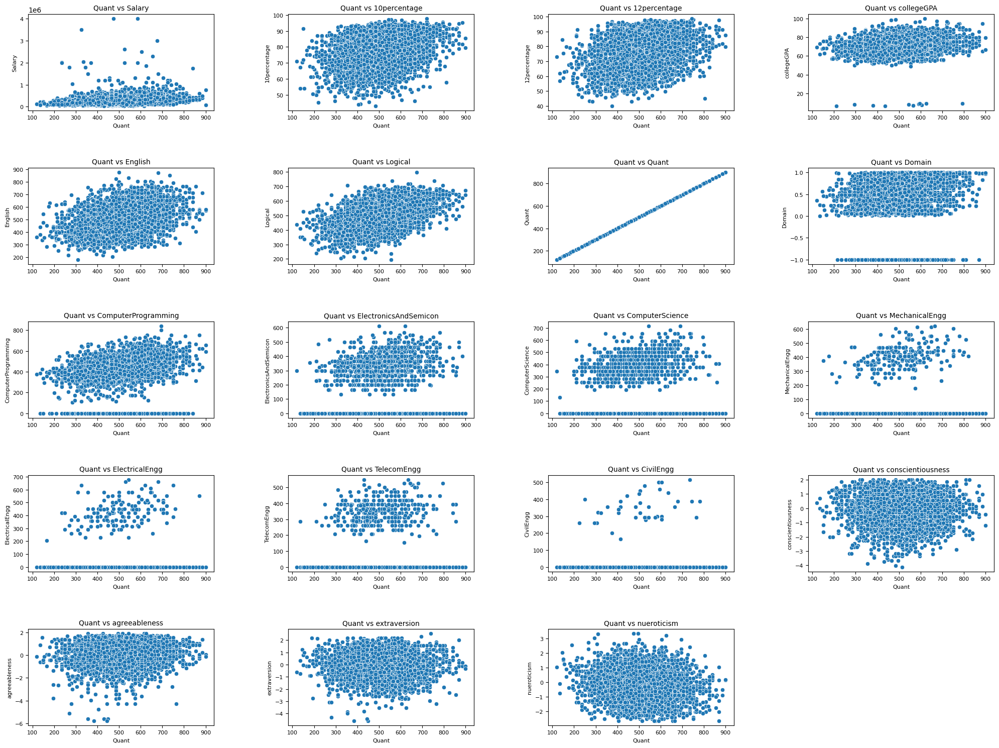

In [62]:
x_col = 'Quant'
fig, axes = plt.subplots(nrows=5, ncols=4, figsize=(20, 15))
axes = axes.flatten()
for i, col in enumerate(numerical_df.columns):
        sns.scatterplot(x=numerical_df[x_col], y=numerical_df[col], ax=axes[i])
        axes[i].set_title(f'{x_col} vs {col}', fontsize=10)
        axes[i].set_xlabel(x_col, fontsize=8)
        axes[i].set_ylabel(col, fontsize=8)
        axes[i].tick_params(axis='both', which='major', labelsize=8)
for j in range(i, len(axes)):
    fig.delaxes(axes[j])
plt.tight_layout()
plt.subplots_adjust(wspace=0.4, hspace=0.6)
plt.show()

### 8) Domain VS Rest of the numerical columns

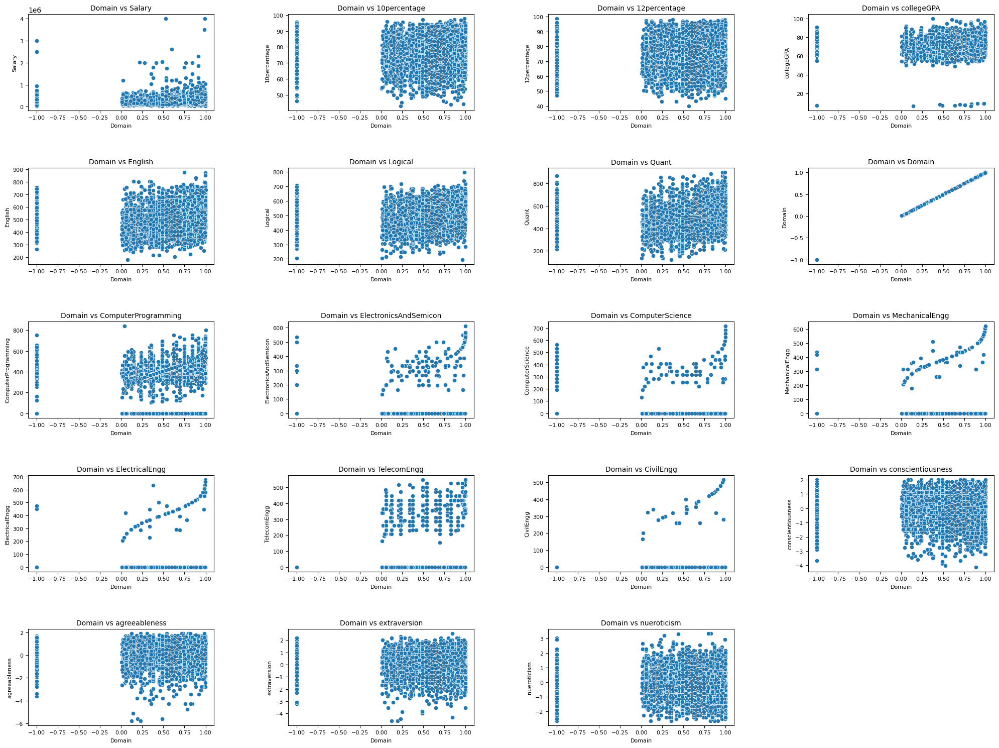

In [63]:
x_col = 'Domain'
fig, axes = plt.subplots(nrows=5, ncols=4, figsize=(20, 15))
axes = axes.flatten()
for i, col in enumerate(numerical_df.columns):
        sns.scatterplot(x=numerical_df[x_col], y=numerical_df[col], ax=axes[i])
        axes[i].set_title(f'{x_col} vs {col}', fontsize=10)
        axes[i].set_xlabel(x_col, fontsize=8)
        axes[i].set_ylabel(col, fontsize=8)
        axes[i].tick_params(axis='both', which='major', labelsize=8)
for j in range(i, len(axes)):
    fig.delaxes(axes[j])
plt.tight_layout()
plt.subplots_adjust(wspace=0.4, hspace=0.6)
plt.show()

### 9) Computer Programming VS Rest of the numerical columns

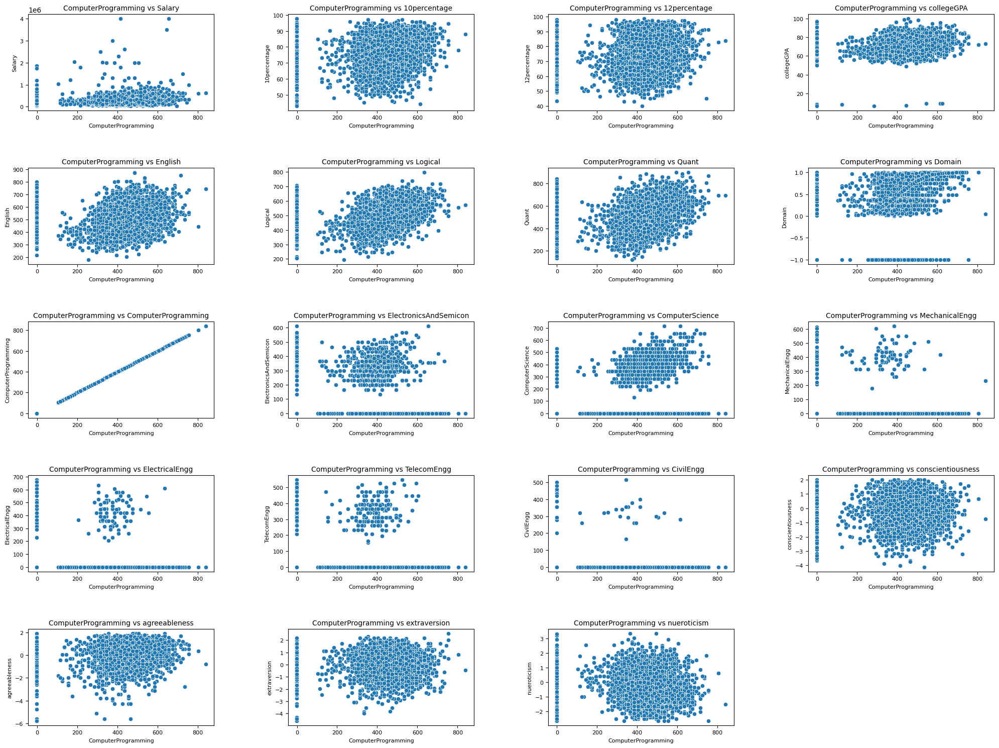

In [64]:
x_col = 'ComputerProgramming'
fig, axes = plt.subplots(nrows=5, ncols=4, figsize=(20, 15))
axes = axes.flatten()
for i, col in enumerate(numerical_df.columns):
        sns.scatterplot(x=numerical_df[x_col], y=numerical_df[col], ax=axes[i])
        axes[i].set_title(f'{x_col} vs {col}', fontsize=10)
        axes[i].set_xlabel(x_col, fontsize=8)
        axes[i].set_ylabel(col, fontsize=8)
        axes[i].tick_params(axis='both', which='major', labelsize=8)
for j in range(i, len(axes)):
    fig.delaxes(axes[j])
plt.tight_layout()
plt.subplots_adjust(wspace=0.4, hspace=0.6)
plt.show()

### 10) Electronics And Semiconductors Engg VS Rest of the numerical columns

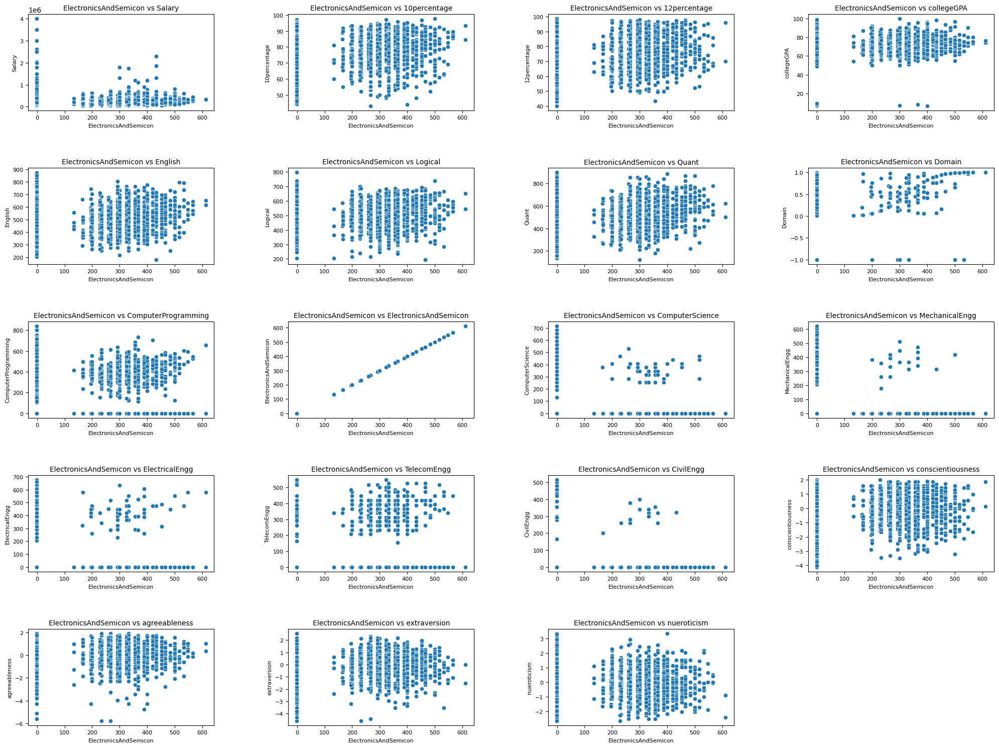

In [65]:
x_col = 'ElectronicsAndSemicon'
fig, axes = plt.subplots(nrows=5, ncols=4, figsize=(20, 15))
axes = axes.flatten()
for i, col in enumerate(numerical_df.columns):
        sns.scatterplot(x=numerical_df[x_col], y=numerical_df[col], ax=axes[i])
        axes[i].set_title(f'{x_col} vs {col}', fontsize=10)
        axes[i].set_xlabel(x_col, fontsize=8)
        axes[i].set_ylabel(col, fontsize=8)
        axes[i].tick_params(axis='both', which='major', labelsize=8)
for j in range(i, len(axes)):
    fig.delaxes(axes[j])
plt.tight_layout()
plt.subplots_adjust(wspace=0.4, hspace=0.6)
plt.show()

### 11) Computer Science VS Rest of the numerical columns

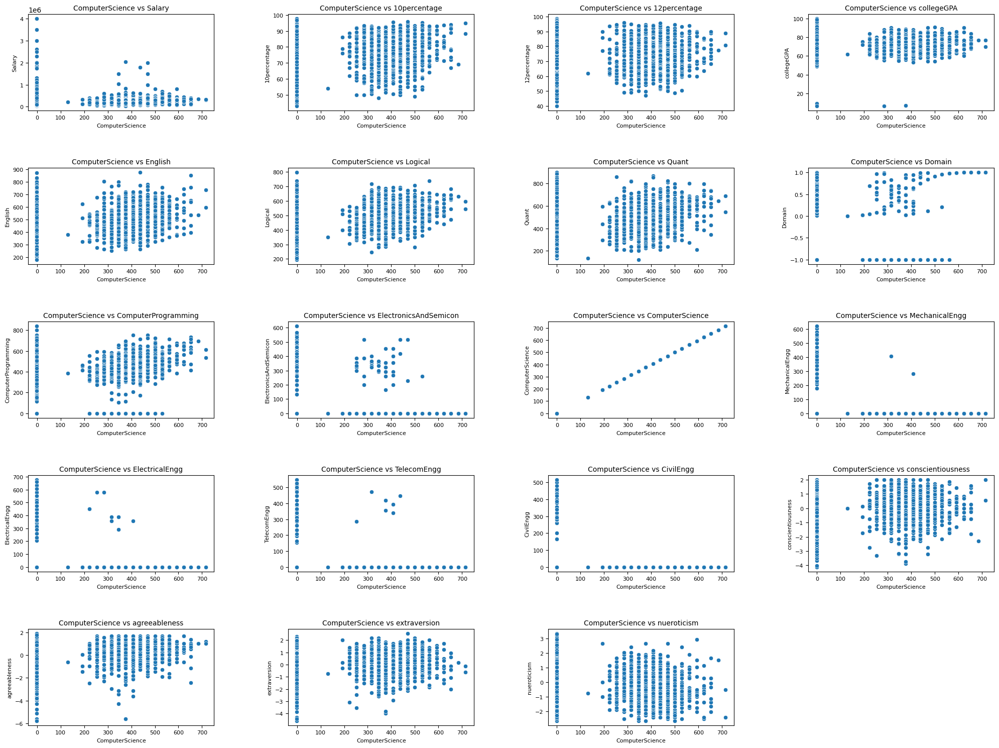

In [66]:
x_col = 'ComputerScience'
fig, axes = plt.subplots(nrows=5, ncols=4, figsize=(20, 15))
axes = axes.flatten()
for i, col in enumerate(numerical_df.columns):
        sns.scatterplot(x=numerical_df[x_col], y=numerical_df[col], ax=axes[i])
        axes[i].set_title(f'{x_col} vs {col}', fontsize=10)
        axes[i].set_xlabel(x_col, fontsize=8)
        axes[i].set_ylabel(col, fontsize=8)
        axes[i].tick_params(axis='both', which='major', labelsize=8)
for j in range(i, len(axes)):
    fig.delaxes(axes[j])
plt.tight_layout()
plt.subplots_adjust(wspace=0.4, hspace=0.6)
plt.show()

### 12) Mechanical Engg VS Rest of the numerical columns

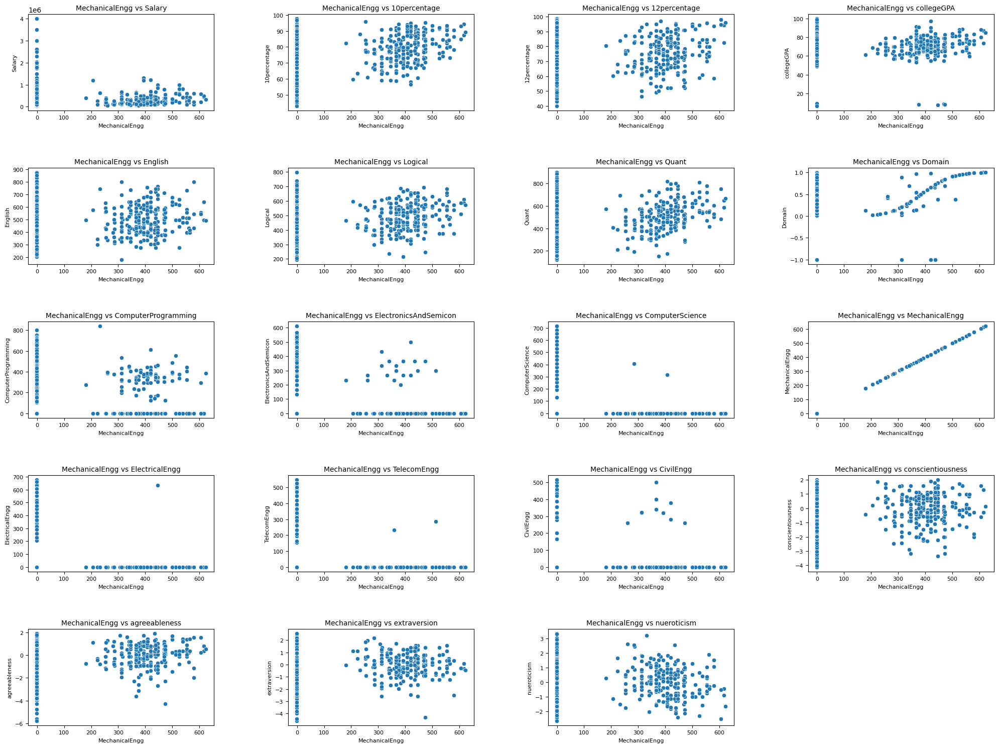

In [67]:
x_col = 'MechanicalEngg'
fig, axes = plt.subplots(nrows=5, ncols=4, figsize=(20, 15))
axes = axes.flatten()
for i, col in enumerate(numerical_df.columns):
        sns.scatterplot(x=numerical_df[x_col], y=numerical_df[col], ax=axes[i])
        axes[i].set_title(f'{x_col} vs {col}', fontsize=10)
        axes[i].set_xlabel(x_col, fontsize=8)
        axes[i].set_ylabel(col, fontsize=8)
        axes[i].tick_params(axis='both', which='major', labelsize=8)
for j in range(i, len(axes)):
    fig.delaxes(axes[j])
plt.tight_layout()
plt.subplots_adjust(wspace=0.4, hspace=0.6)
plt.show()

### 13) Electrical Engg VS Rest of the numerical columns

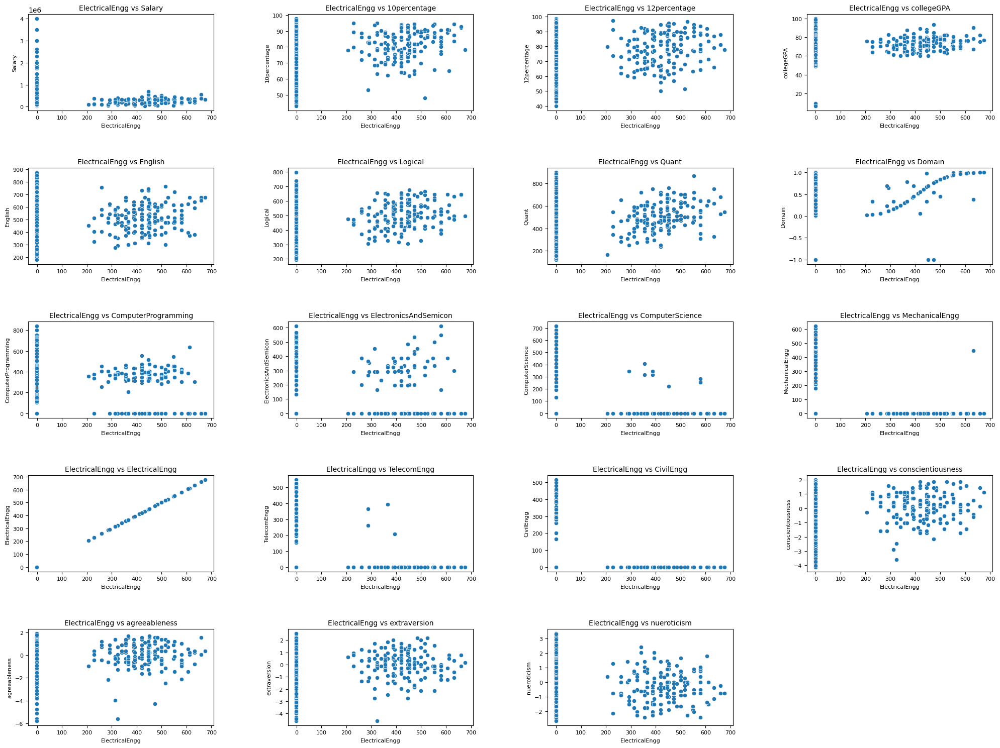

In [68]:
x_col = 'ElectricalEngg'
fig, axes = plt.subplots(nrows=5, ncols=4, figsize=(20, 15))
axes = axes.flatten()
for i, col in enumerate(numerical_df.columns):
        sns.scatterplot(x=numerical_df[x_col], y=numerical_df[col], ax=axes[i])
        axes[i].set_title(f'{x_col} vs {col}', fontsize=10)
        axes[i].set_xlabel(x_col, fontsize=8)
        axes[i].set_ylabel(col, fontsize=8)
        axes[i].tick_params(axis='both', which='major', labelsize=8)
for j in range(i, len(axes)):
    fig.delaxes(axes[j])
plt.tight_layout()
plt.subplots_adjust(wspace=0.4, hspace=0.6)
plt.show()

### 14) Telecom Engg VS Rest of the numerical columns

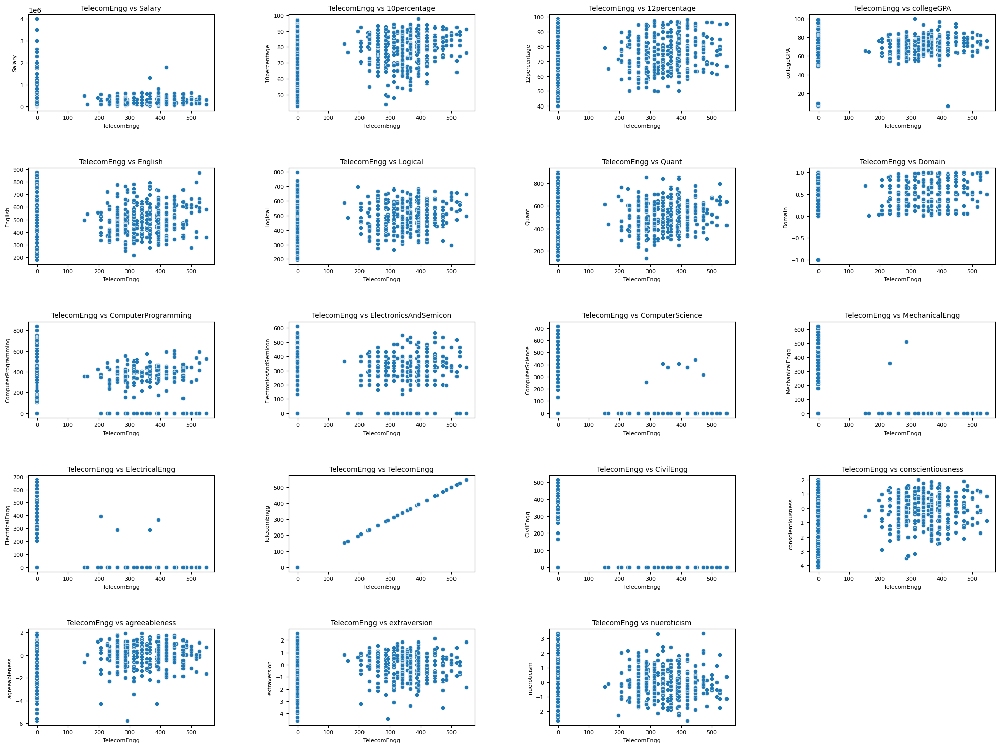

In [69]:
x_col = 'TelecomEngg'
fig, axes = plt.subplots(nrows=5, ncols=4, figsize=(20, 15))
axes = axes.flatten()
for i, col in enumerate(numerical_df.columns):
        sns.scatterplot(x=numerical_df[x_col], y=numerical_df[col], ax=axes[i])
        axes[i].set_title(f'{x_col} vs {col}', fontsize=10)
        axes[i].set_xlabel(x_col, fontsize=8)
        axes[i].set_ylabel(col, fontsize=8)
        axes[i].tick_params(axis='both', which='major', labelsize=8)
for j in range(i, len(axes)):
    fig.delaxes(axes[j])
plt.tight_layout()
plt.subplots_adjust(wspace=0.4, hspace=0.6)
plt.show()

### 15) Civil Engg VS Rest of the numerical columns

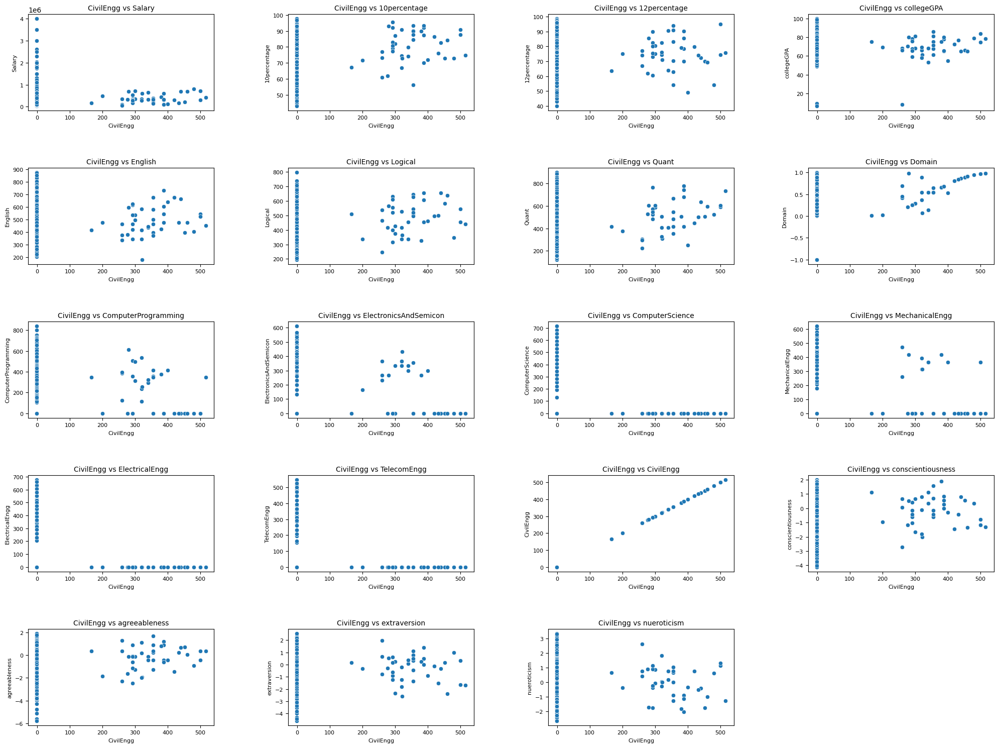

In [70]:
x_col = 'CivilEngg'
fig, axes = plt.subplots(nrows=5, ncols=4, figsize=(20, 15))
axes = axes.flatten()
for i, col in enumerate(numerical_df.columns):
        sns.scatterplot(x=numerical_df[x_col], y=numerical_df[col], ax=axes[i])
        axes[i].set_title(f'{x_col} vs {col}', fontsize=10)
        axes[i].set_xlabel(x_col, fontsize=8)
        axes[i].set_ylabel(col, fontsize=8)
        axes[i].tick_params(axis='both', which='major', labelsize=8)
for j in range(i, len(axes)):
    fig.delaxes(axes[j])
plt.tight_layout()
plt.subplots_adjust(wspace=0.4, hspace=0.6)
plt.show()

### 16) Conscientiousness VS Rest of the numerical columns

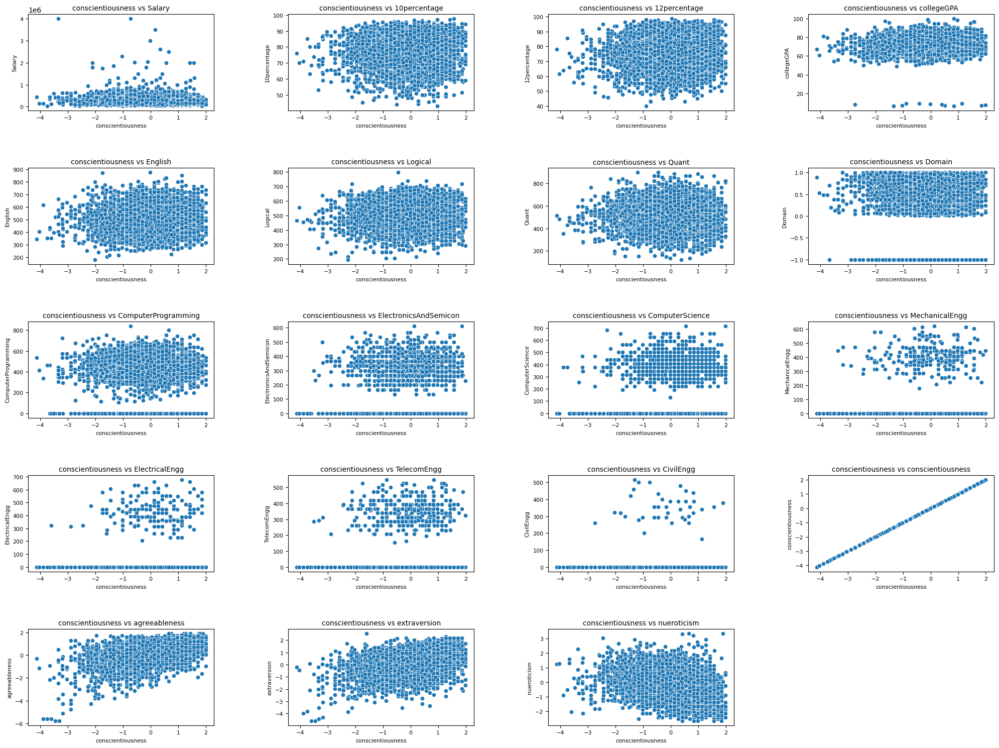

In [71]:
x_col = 'conscientiousness'
fig, axes = plt.subplots(nrows=5, ncols=4, figsize=(20, 15))
axes = axes.flatten()
for i, col in enumerate(numerical_df.columns):
        sns.scatterplot(x=numerical_df[x_col], y=numerical_df[col], ax=axes[i])
        axes[i].set_title(f'{x_col} vs {col}', fontsize=10)
        axes[i].set_xlabel(x_col, fontsize=8)
        axes[i].set_ylabel(col, fontsize=8)
        axes[i].tick_params(axis='both', which='major', labelsize=8)
for j in range(i, len(axes)):
    fig.delaxes(axes[j])
plt.tight_layout()
plt.subplots_adjust(wspace=0.4, hspace=0.6)
plt.show()

### 17) Agreeableness VS Rest of the numerical columns

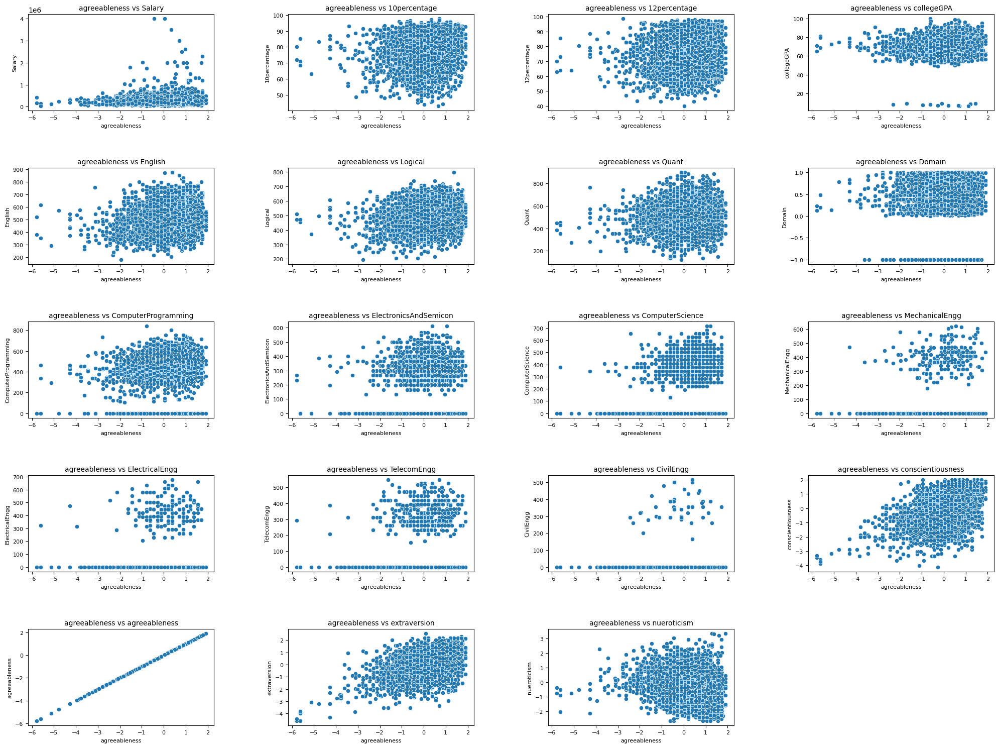

In [72]:
x_col = 'agreeableness'
fig, axes = plt.subplots(nrows=5, ncols=4, figsize=(20, 15))
axes = axes.flatten()
for i, col in enumerate(numerical_df.columns):
        sns.scatterplot(x=numerical_df[x_col], y=numerical_df[col], ax=axes[i])
        axes[i].set_title(f'{x_col} vs {col}', fontsize=10)
        axes[i].set_xlabel(x_col, fontsize=8)
        axes[i].set_ylabel(col, fontsize=8)
        axes[i].tick_params(axis='both', which='major', labelsize=8)
for j in range(i, len(axes)):
    fig.delaxes(axes[j])
plt.tight_layout()
plt.subplots_adjust(wspace=0.4, hspace=0.6)
plt.show()

### 18) Extraversion VS Rest of the numerical columns

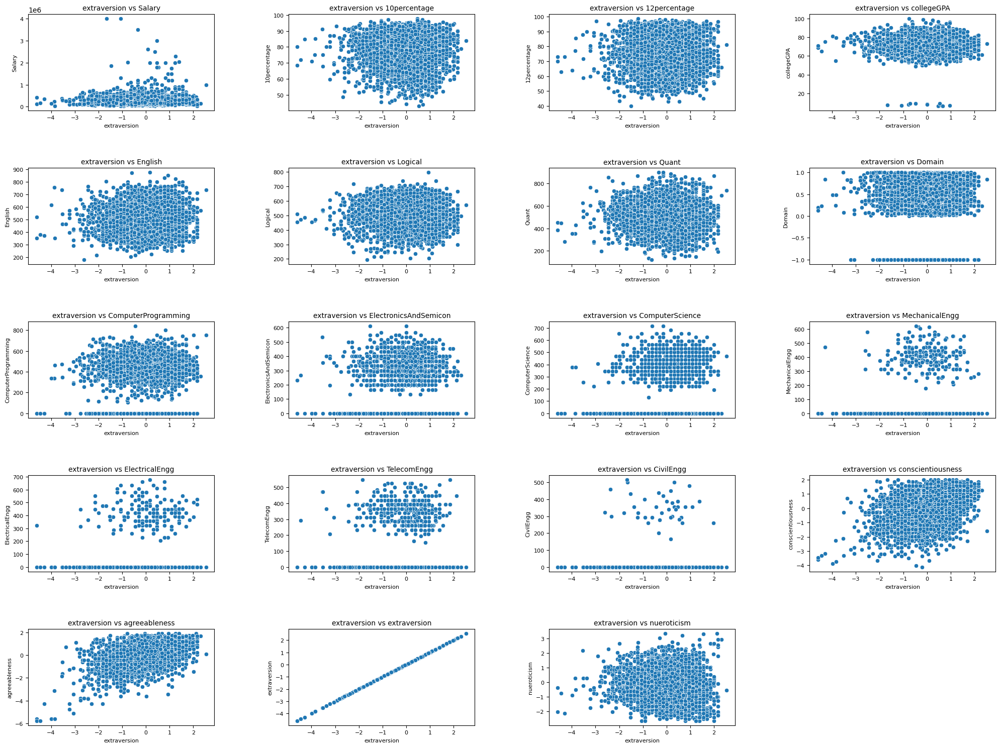

In [73]:
x_col = 'extraversion'
fig, axes = plt.subplots(nrows=5, ncols=4, figsize=(20, 15))
axes = axes.flatten()
for i, col in enumerate(numerical_df.columns):
        sns.scatterplot(x=numerical_df[x_col], y=numerical_df[col], ax=axes[i])
        axes[i].set_title(f'{x_col} vs {col}', fontsize=10)
        axes[i].set_xlabel(x_col, fontsize=8)
        axes[i].set_ylabel(col, fontsize=8)
        axes[i].tick_params(axis='both', which='major', labelsize=8)
for j in range(i, len(axes)):
    fig.delaxes(axes[j])
plt.tight_layout()
plt.subplots_adjust(wspace=0.4, hspace=0.6)
plt.show()

### 19) Nueroticism VS Rest of the numerical columns

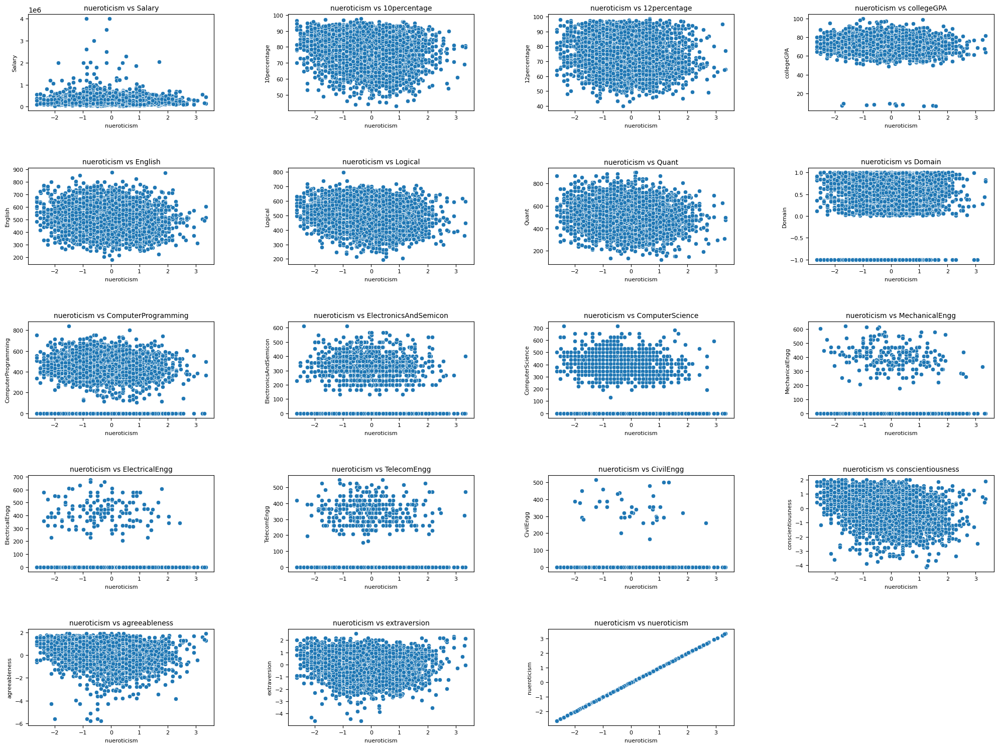

In [74]:
x_col = 'nueroticism'
fig, axes = plt.subplots(nrows=5, ncols=4, figsize=(20, 15))
axes = axes.flatten()
for i, col in enumerate(numerical_df.columns):
        sns.scatterplot(x=df[x_col], y=df[col], ax=axes[i])
        axes[i].set_title(f'{x_col} vs {col}', fontsize=10)
        axes[i].set_xlabel(x_col, fontsize=8)
        axes[i].set_ylabel(col, fontsize=8)
        axes[i].tick_params(axis='both', which='major', labelsize=8)
for j in range(i, len(axes)):
    fig.delaxes(axes[j])
plt.tight_layout()
plt.subplots_adjust(wspace=0.4, hspace=0.6)
plt.show()

### 20) Openess to experience VS Rest of the numerical columns

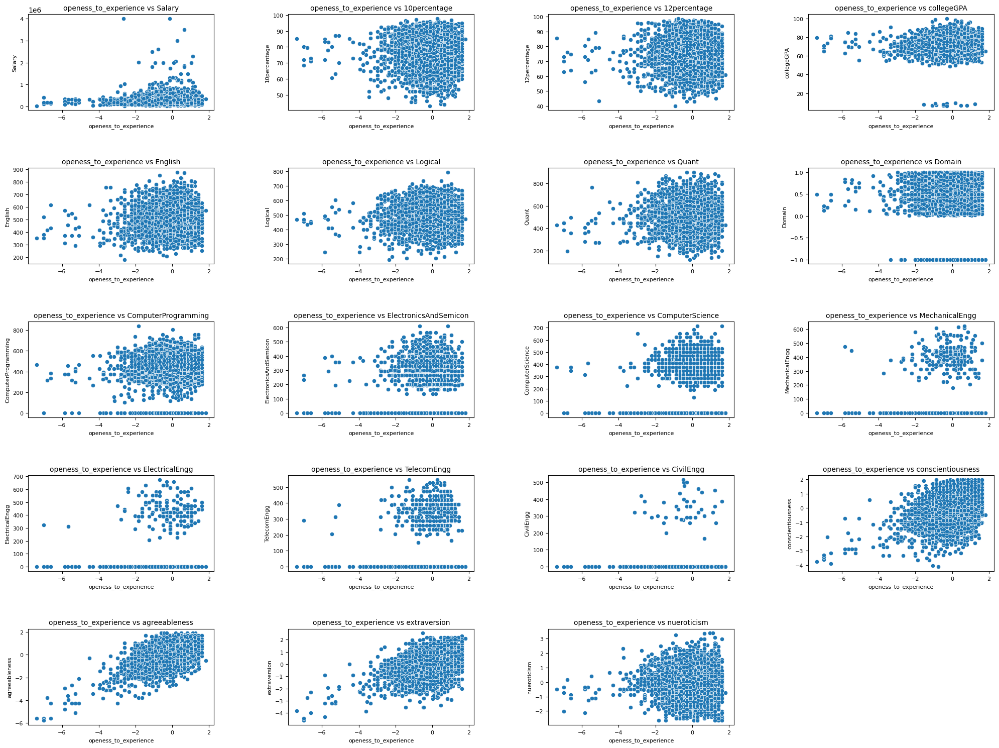

In [75]:
x_col = 'openess_to_experience'
fig, axes = plt.subplots(nrows=5, ncols=4, figsize=(20, 15))
axes = axes.flatten()
for i, col in enumerate(numerical_df.columns):
        sns.scatterplot(x=numerical_df[x_col], y=numerical_df[col], ax=axes[i])
        axes[i].set_title(f'{x_col} vs {col}', fontsize=10)
        axes[i].set_xlabel(x_col, fontsize=8)
        axes[i].set_ylabel(col, fontsize=8)
        axes[i].tick_params(axis='both', which='major', labelsize=8)
for j in range(i, len(axes)):
    fig.delaxes(axes[j])
plt.tight_layout()
plt.subplots_adjust(wspace=0.4, hspace=0.6)
plt.show()

##Performing Bivariate analysis on Categorical VS Categorical columns

In [ ]:
categorical_df_bivariate.head()

,DOJ_year,DOL_year,Designation,JobCity,Gender,DOB_year,12graduation,12board,CollegeTier,Degree,Specialization,CollegeCityTier,CollegeState,GraduationYear
0,2012,present,Others,Bangalore,f,1990,2007,Others,2,B.Tech/B.E.,computer engineering,0,Andhra Pradesh,2011
1,2013,present,Others,Others,m,1989,2007,cbse,2,B.Tech/B.E.,electronics and communication engineering,0,Others,2012
2,2014,present,systems engineer,Chennai,f,1992,2010,cbse,2,B.Tech/B.E.,information technology,0,Uttar Pradesh,2014
3,2011,present,Others,Gurgaon,m,1989,2007,cbse,1,B.Tech/B.E.,computer engineering,1,Others,2011
4,2014,2015,Others,Others,m,1991,2008,cbse,2,B.Tech/B.E.,electronics and communication engineering,0,Uttar Pradesh,2012


In [ ]:
categorical_df_bivariate.shape[1]

14

In [ ]:
categorical_df_bivariate.columns

Index(['DOJ_year', 'DOL_year', 'Designation', 'JobCity', 'Gender', 'DOB_year',
       '12graduation', '12board', 'CollegeTier', 'Degree', 'Specialization',
       'CollegeCityTier', 'CollegeState', 'GraduationYear'],
      dtype='object')

### 1) DOJ Year VS Rest of the categorical columns

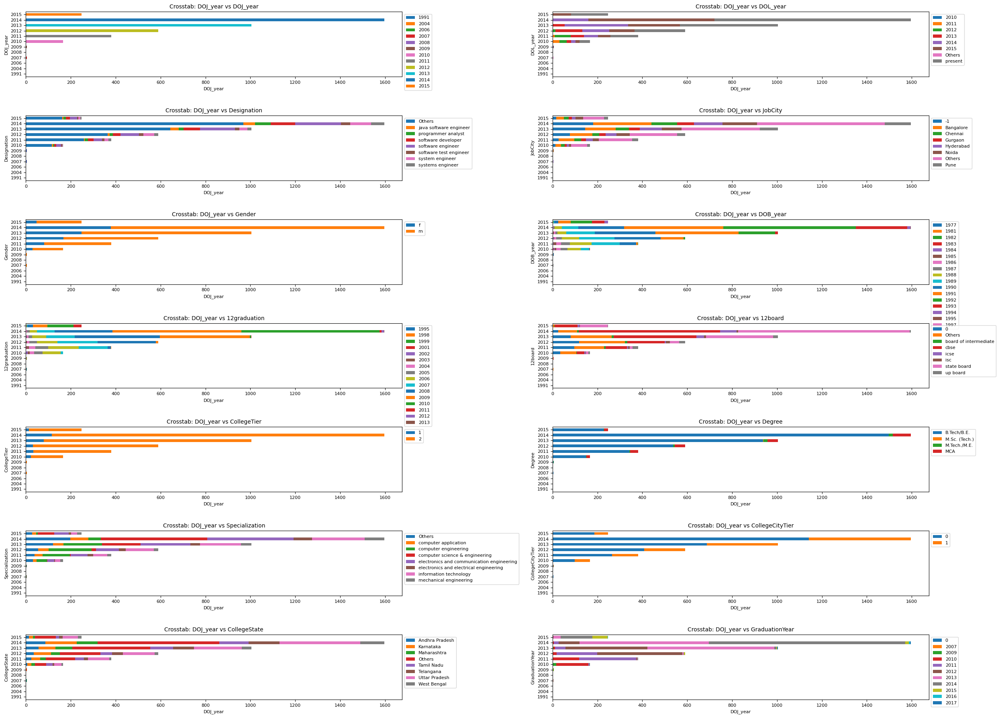

In [ ]:
x_col = 'DOJ_year'

fig, axes = plt.subplots(nrows=7, ncols=2, figsize=(25, 18))

axes = axes.flatten()

for i, col in enumerate(categorical_df_bivariate.columns):
        ctab = pd.crosstab(categorical_df_bivariate[x_col], categorical_df_bivariate[col])

        ctab.plot(kind='barh', stacked=True, ax=axes[i])
        axes[i].set_title(f'Crosstab: {x_col} vs {col}', fontsize=10)
        axes[i].set_xlabel(x_col, fontsize=8)
        axes[i].set_ylabel(col, fontsize=8)
        axes[i].tick_params(axis='both', which='major', labelsize=8)

        axes[i].legend(loc='upper left', bbox_to_anchor=(1, 1), fontsize=8)
for j in range(i + 1, len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.subplots_adjust(wspace=0.4, hspace=0.6)

plt.show()

### 2) DOL Year VS Rest of the categorical columns

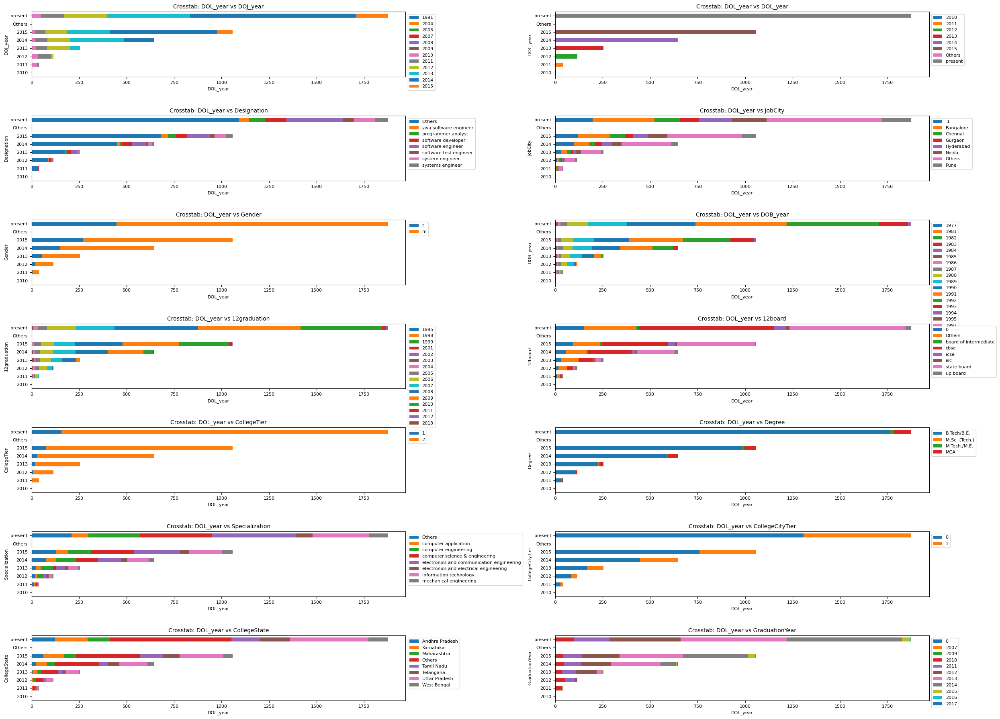

In [ ]:
x_col = 'DOL_year'

fig, axes = plt.subplots(nrows=7, ncols=2, figsize=(25, 18))

axes = axes.flatten()

for i, col in enumerate(categorical_df_bivariate.columns):
        ctab = pd.crosstab(categorical_df_bivariate[x_col], categorical_df_bivariate[col])

        ctab.plot(kind='barh', stacked=True, ax=axes[i])
        axes[i].set_title(f'Crosstab: {x_col} vs {col}', fontsize=10)
        axes[i].set_xlabel(x_col, fontsize=8)
        axes[i].set_ylabel(col, fontsize=8)
        axes[i].tick_params(axis='both', which='major', labelsize=8)

        axes[i].legend(loc='upper left', bbox_to_anchor=(1, 1), fontsize=8)
for j in range(i + 1, len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.subplots_adjust(wspace=0.4, hspace=0.6)

plt.show()

### 3) DOB Year VS Rest of the categorical columns

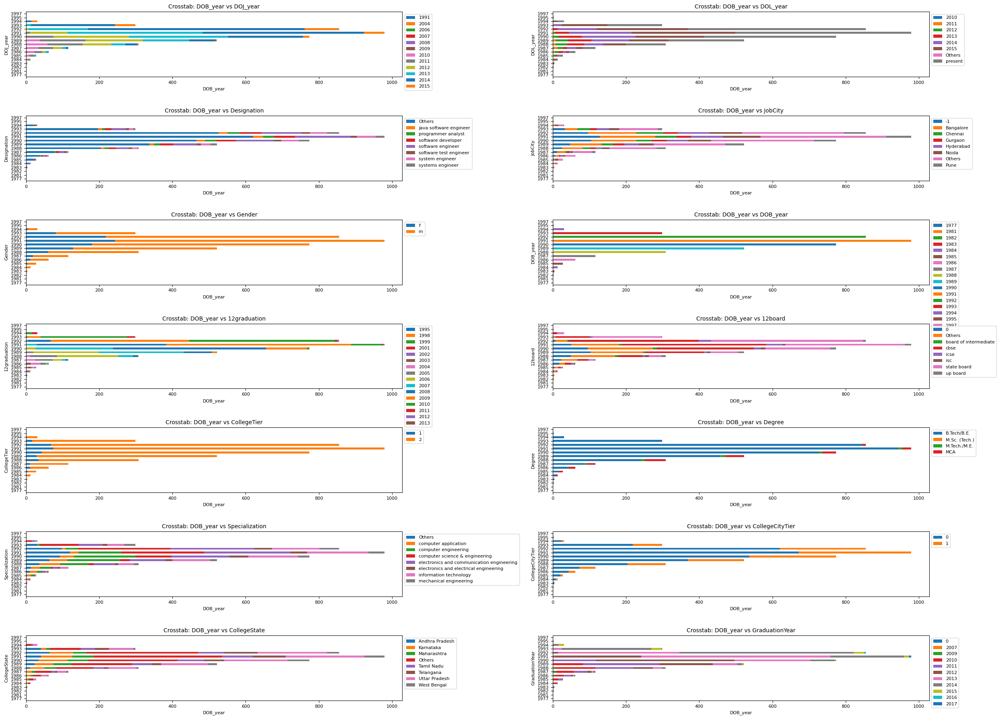

In [ ]:
x_col = 'DOB_year'

fig, axes = plt.subplots(nrows=7, ncols=2, figsize=(25, 18))

axes = axes.flatten()

for i, col in enumerate(categorical_df_bivariate.columns):
        ctab = pd.crosstab(categorical_df_bivariate[x_col], categorical_df_bivariate[col])

        ctab.plot(kind='barh', stacked=True, ax=axes[i])
        axes[i].set_title(f'Crosstab: {x_col} vs {col}', fontsize=10)
        axes[i].set_xlabel(x_col, fontsize=8)
        axes[i].set_ylabel(col, fontsize=8)
        axes[i].tick_params(axis='both', which='major', labelsize=8)

        axes[i].legend(loc='upper left', bbox_to_anchor=(1, 1), fontsize=8)
for j in range(i + 1, len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.subplots_adjust(wspace=0.4, hspace=0.6)

plt.show()

### 4) Designation VS Rest of the categorical columns

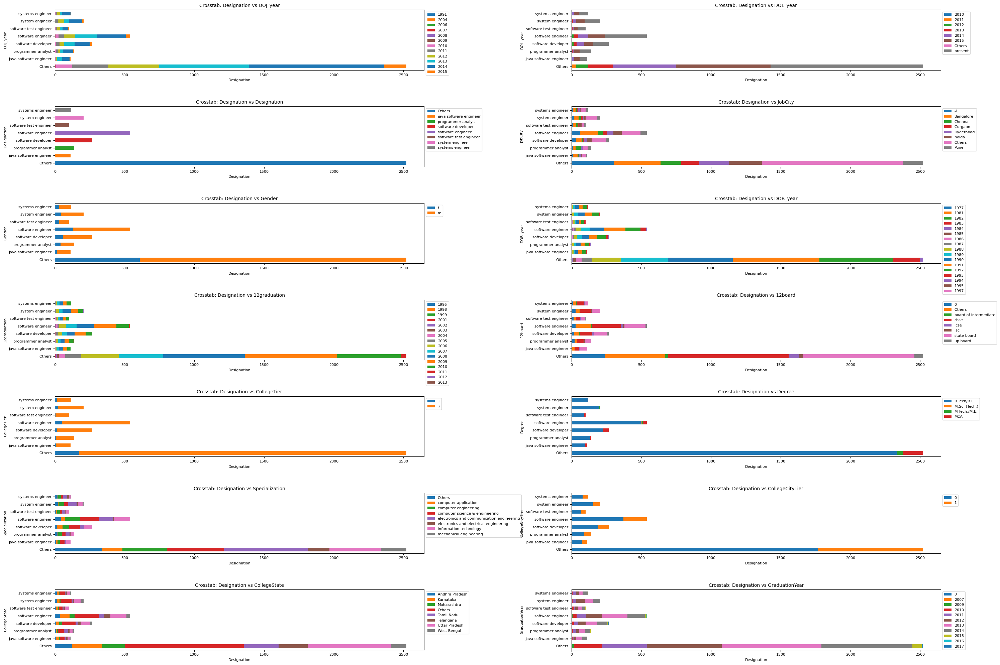

In [ ]:
x_col = 'Designation'

fig, axes = plt.subplots(nrows=7, ncols=2, figsize=(30, 20))

axes = axes.flatten()

for i, col in enumerate(categorical_df_bivariate.columns):
        ctab = pd.crosstab(categorical_df_bivariate[x_col], categorical_df_bivariate[col])

        ctab.plot(kind='barh', stacked=True, ax=axes[i])
        axes[i].set_title(f'Crosstab: {x_col} vs {col}', fontsize=10)
        axes[i].set_xlabel(x_col, fontsize=8)
        axes[i].set_ylabel(col, fontsize=8)
        axes[i].tick_params(axis='both', which='major', labelsize=8)

        axes[i].legend(loc='upper left', bbox_to_anchor=(1, 1), fontsize=8)
for j in range(i + 1, len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.subplots_adjust(wspace=0.4, hspace=0.6)

plt.show()

### 5) Job City VS Rest of the categorical columns

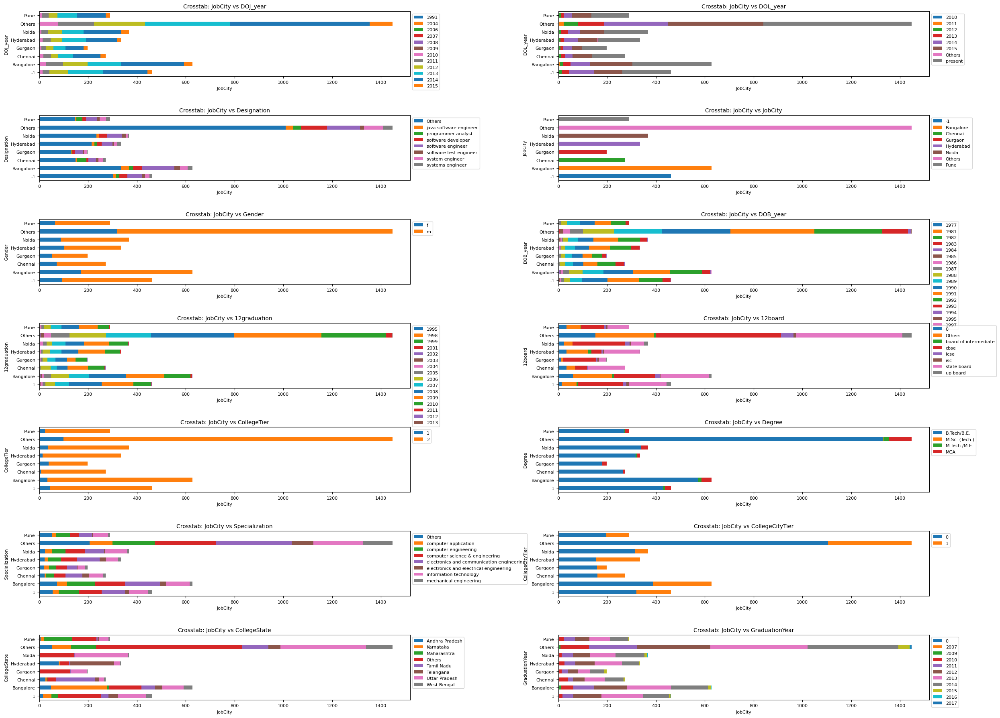

In [ ]:
x_col = 'JobCity'

fig, axes = plt.subplots(nrows=7, ncols=2, figsize=(25, 18))

axes = axes.flatten()

for i, col in enumerate(categorical_df_bivariate.columns):
        ctab = pd.crosstab(categorical_df_bivariate[x_col], categorical_df_bivariate[col])

        ctab.plot(kind='barh', stacked=True, ax=axes[i])
        axes[i].set_title(f'Crosstab: {x_col} vs {col}', fontsize=10)
        axes[i].set_xlabel(x_col, fontsize=8)
        axes[i].set_ylabel(col, fontsize=8)
        axes[i].tick_params(axis='both', which='major', labelsize=8)

        axes[i].legend(loc='upper left', bbox_to_anchor=(1, 1), fontsize=8)
for j in range(i + 1, len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.subplots_adjust(wspace=0.4, hspace=0.6)

plt.show()

### 6) Gender VS Rest of the categorical columns

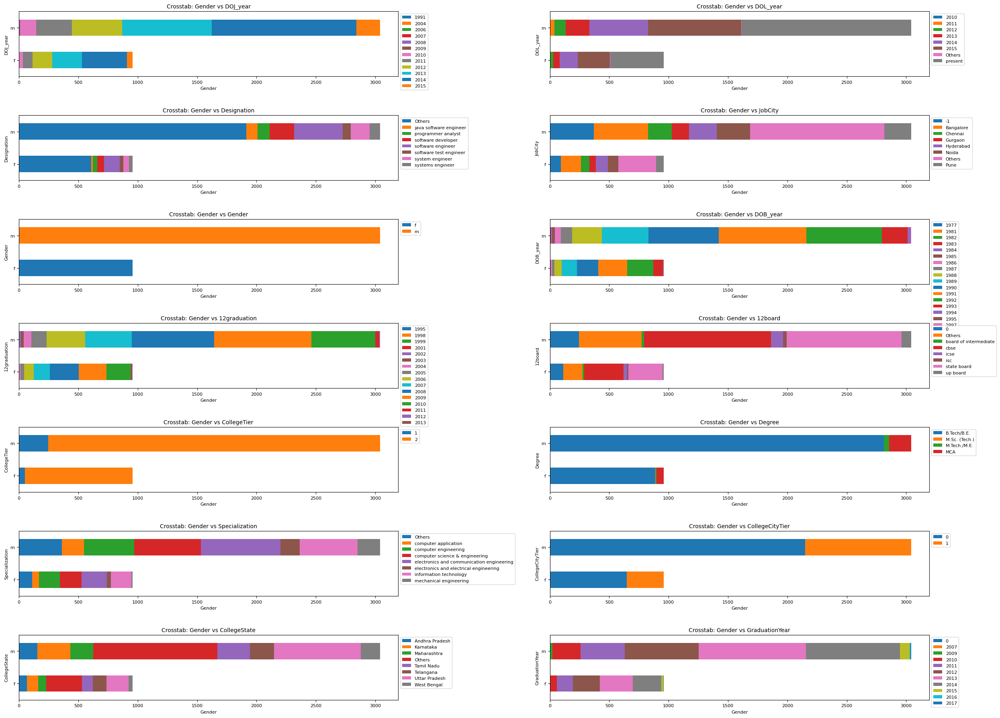

In [ ]:
x_col = 'Gender'

fig, axes = plt.subplots(nrows=7, ncols=2, figsize=(25, 18))

axes = axes.flatten()

for i, col in enumerate(categorical_df_bivariate.columns):
        ctab = pd.crosstab(categorical_df_bivariate[x_col], categorical_df_bivariate[col])

        ctab.plot(kind='barh', stacked=True, ax=axes[i])
        axes[i].set_title(f'Crosstab: {x_col} vs {col}', fontsize=10)
        axes[i].set_xlabel(x_col, fontsize=8)
        axes[i].set_ylabel(col, fontsize=8)
        axes[i].tick_params(axis='both', which='major', labelsize=8)

        axes[i].legend(loc='upper left', bbox_to_anchor=(1, 1), fontsize=8)
for j in range(i + 1, len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.subplots_adjust(wspace=0.4, hspace=0.6)

plt.show()

### 7) 12th graduation VS Rest of the categorical columns

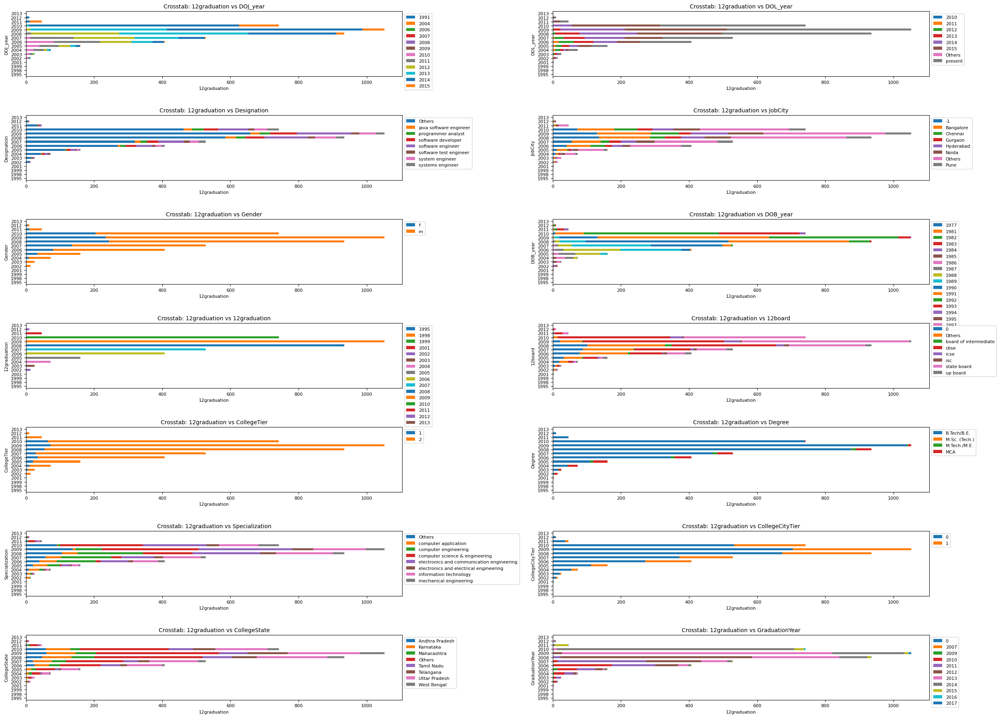

In [ ]:
x_col = '12graduation'

fig, axes = plt.subplots(nrows=7, ncols=2, figsize=(25, 18))

axes = axes.flatten()

for i, col in enumerate(categorical_df_bivariate.columns):
        ctab = pd.crosstab(categorical_df_bivariate[x_col], categorical_df_bivariate[col])

        ctab.plot(kind='barh', stacked=True, ax=axes[i])
        axes[i].set_title(f'Crosstab: {x_col} vs {col}', fontsize=10)
        axes[i].set_xlabel(x_col, fontsize=8)
        axes[i].set_ylabel(col, fontsize=8)
        axes[i].tick_params(axis='both', which='major', labelsize=8)

        axes[i].legend(loc='upper left', bbox_to_anchor=(1, 1), fontsize=8)
for j in range(i + 1, len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.subplots_adjust(wspace=0.4, hspace=0.6)

plt.show()

### 8) 12th board VS Rest of the categorical columns

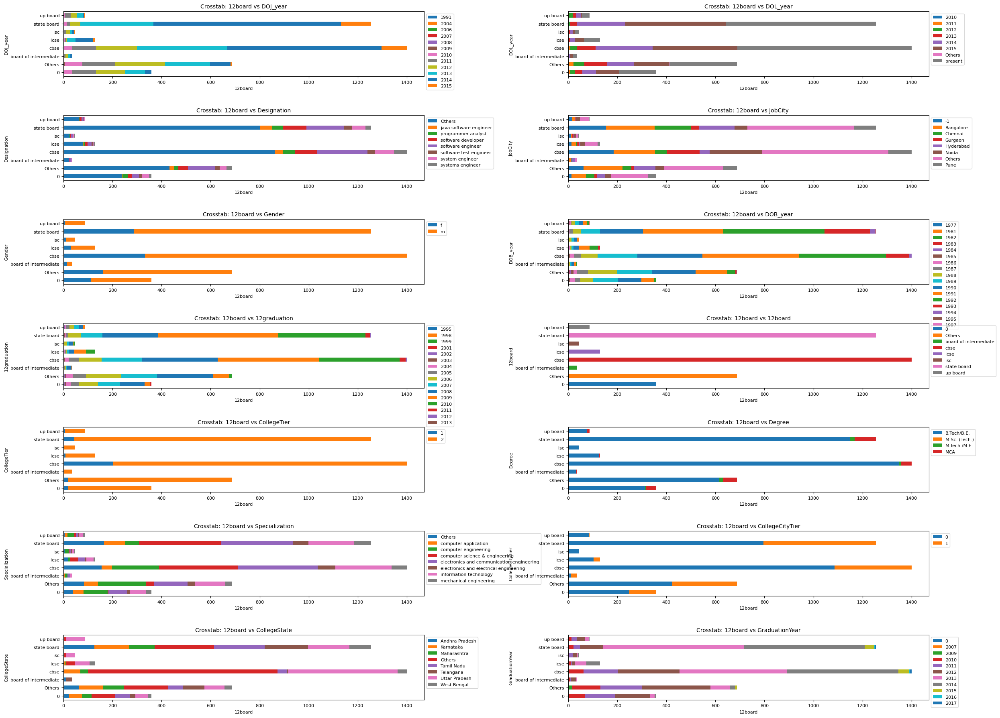

In [ ]:
x_col = '12board'

fig, axes = plt.subplots(nrows=7, ncols=2, figsize=(25, 18))

axes = axes.flatten()

for i, col in enumerate(categorical_df_bivariate.columns):
        ctab = pd.crosstab(categorical_df_bivariate[x_col], categorical_df_bivariate[col])

        ctab.plot(kind='barh', stacked=True, ax=axes[i])
        axes[i].set_title(f'Crosstab: {x_col} vs {col}', fontsize=10)
        axes[i].set_xlabel(x_col, fontsize=8)
        axes[i].set_ylabel(col, fontsize=8)
        axes[i].tick_params(axis='both', which='major', labelsize=8)

        axes[i].legend(loc='upper left', bbox_to_anchor=(1, 1), fontsize=8)
for j in range(i + 1, len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.subplots_adjust(wspace=0.4, hspace=0.6)

plt.show()

### 9) College Tier VS Rest of the categorical columns

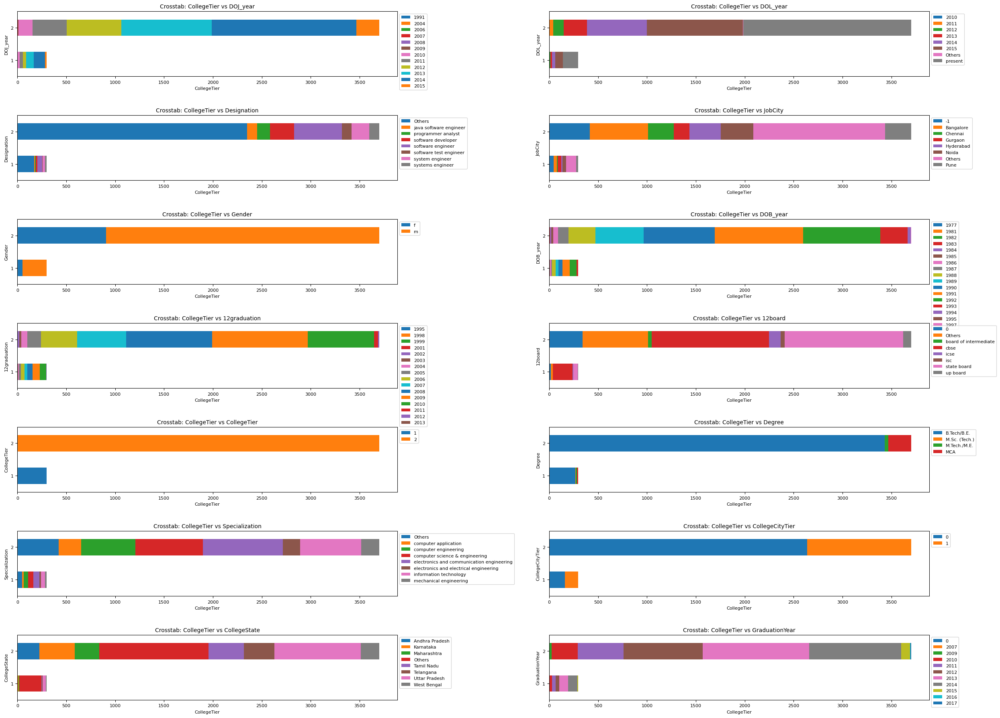

In [ ]:
x_col = 'CollegeTier'

fig, axes = plt.subplots(nrows=7, ncols=2, figsize=(25, 18))

axes = axes.flatten()

for i, col in enumerate(categorical_df_bivariate.columns):
        ctab = pd.crosstab(categorical_df_bivariate[x_col], categorical_df_bivariate[col])

        ctab.plot(kind='barh', stacked=True, ax=axes[i])
        axes[i].set_title(f'Crosstab: {x_col} vs {col}', fontsize=10)
        axes[i].set_xlabel(x_col, fontsize=8)
        axes[i].set_ylabel(col, fontsize=8)
        axes[i].tick_params(axis='both', which='major', labelsize=8)

        axes[i].legend(loc='upper left', bbox_to_anchor=(1, 1), fontsize=8)
for j in range(i + 1, len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.subplots_adjust(wspace=0.4, hspace=0.6)

plt.show()

### 10) Degree VS Rest of the categorical columns

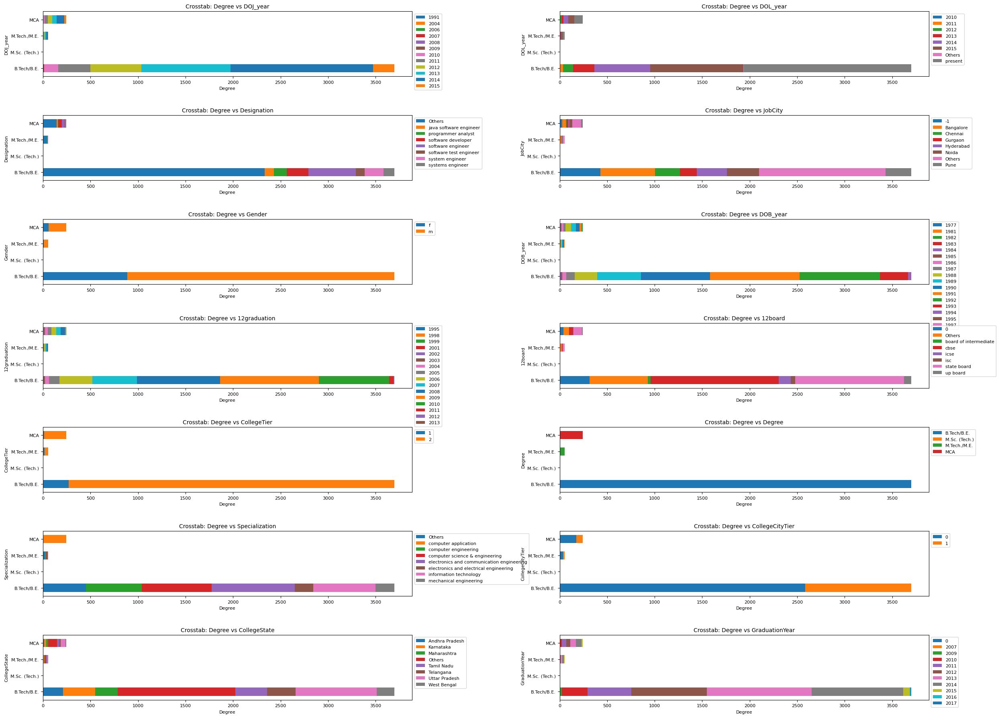

In [ ]:
x_col = 'Degree'

fig, axes = plt.subplots(nrows=7, ncols=2, figsize=(25, 18))

axes = axes.flatten()

for i, col in enumerate(categorical_df_bivariate.columns):
        ctab = pd.crosstab(categorical_df_bivariate[x_col], categorical_df_bivariate[col])

        ctab.plot(kind='barh', stacked=True, ax=axes[i])
        axes[i].set_title(f'Crosstab: {x_col} vs {col}', fontsize=10)
        axes[i].set_xlabel(x_col, fontsize=8)
        axes[i].set_ylabel(col, fontsize=8)
        axes[i].tick_params(axis='both', which='major', labelsize=8)

        axes[i].legend(loc='upper left', bbox_to_anchor=(1, 1), fontsize=8)
for j in range(i + 1, len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.subplots_adjust(wspace=0.4, hspace=0.6)

plt.show()

### 11) Specialization VS Rest of the categorical columns

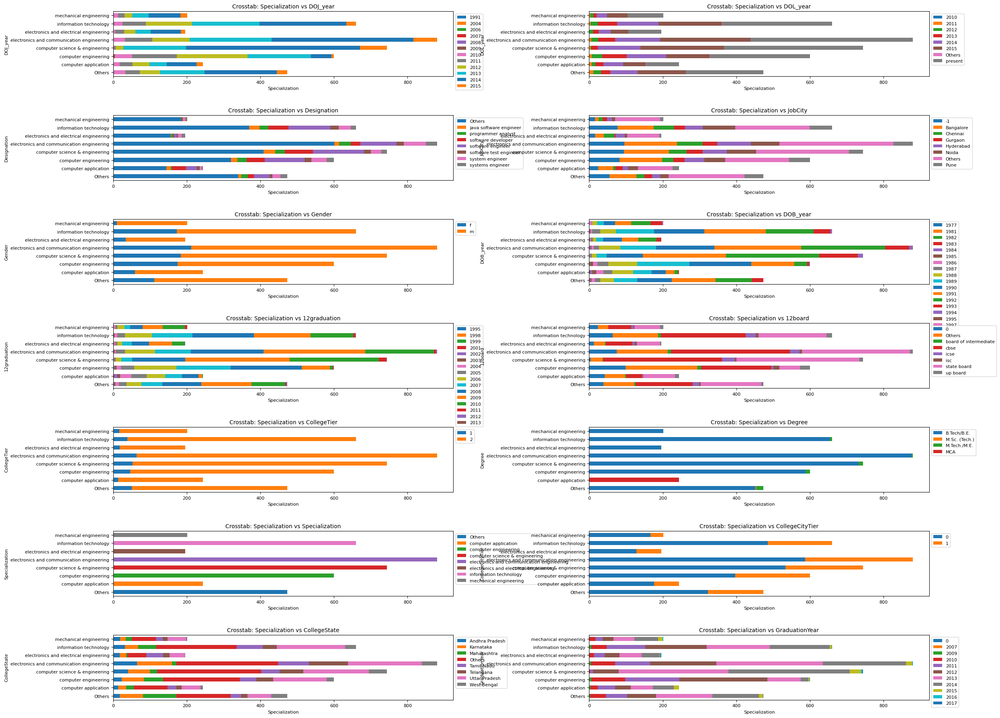

In [ ]:
x_col = 'Specialization'

fig, axes = plt.subplots(nrows=7, ncols=2, figsize=(25, 18))

axes = axes.flatten()

for i, col in enumerate(categorical_df_bivariate.columns):
        ctab = pd.crosstab(categorical_df_bivariate[x_col], categorical_df_bivariate[col])

        ctab.plot(kind='barh', stacked=True, ax=axes[i])
        axes[i].set_title(f'Crosstab: {x_col} vs {col}', fontsize=10)
        axes[i].set_xlabel(x_col, fontsize=8)
        axes[i].set_ylabel(col, fontsize=8)
        axes[i].tick_params(axis='both', which='major', labelsize=8)

        axes[i].legend(loc='upper left', bbox_to_anchor=(1, 1), fontsize=8)
for j in range(i + 1, len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.subplots_adjust(wspace=0.4, hspace=0.6)

plt.show()

### 12) College City Tier VS Rest of the categorical columns

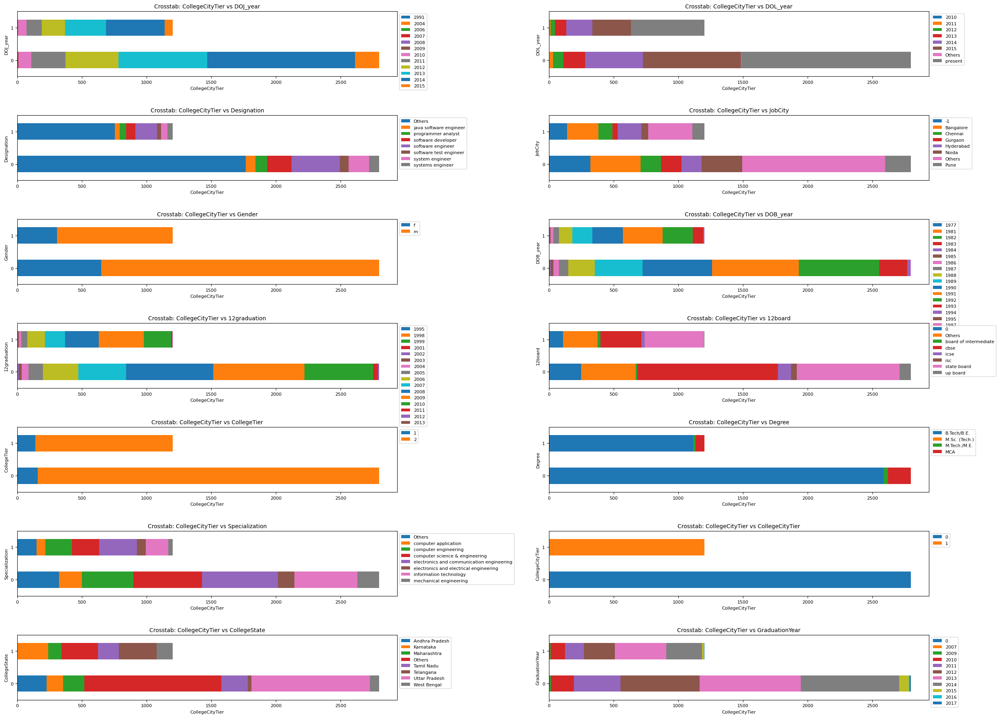

In [ ]:
x_col = 'CollegeCityTier'

fig, axes = plt.subplots(nrows=7, ncols=2, figsize=(25, 18))

axes = axes.flatten()

for i, col in enumerate(categorical_df_bivariate.columns):
        ctab = pd.crosstab(categorical_df_bivariate[x_col], categorical_df_bivariate[col])

        ctab.plot(kind='barh', stacked=True, ax=axes[i])
        axes[i].set_title(f'Crosstab: {x_col} vs {col}', fontsize=10)
        axes[i].set_xlabel(x_col, fontsize=8)
        axes[i].set_ylabel(col, fontsize=8)
        axes[i].tick_params(axis='both', which='major', labelsize=8)

        axes[i].legend(loc='upper left', bbox_to_anchor=(1, 1), fontsize=8)
for j in range(i + 1, len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.subplots_adjust(wspace=0.4, hspace=0.6)

plt.show()

### 13) College State VS Rest of the categorical columns

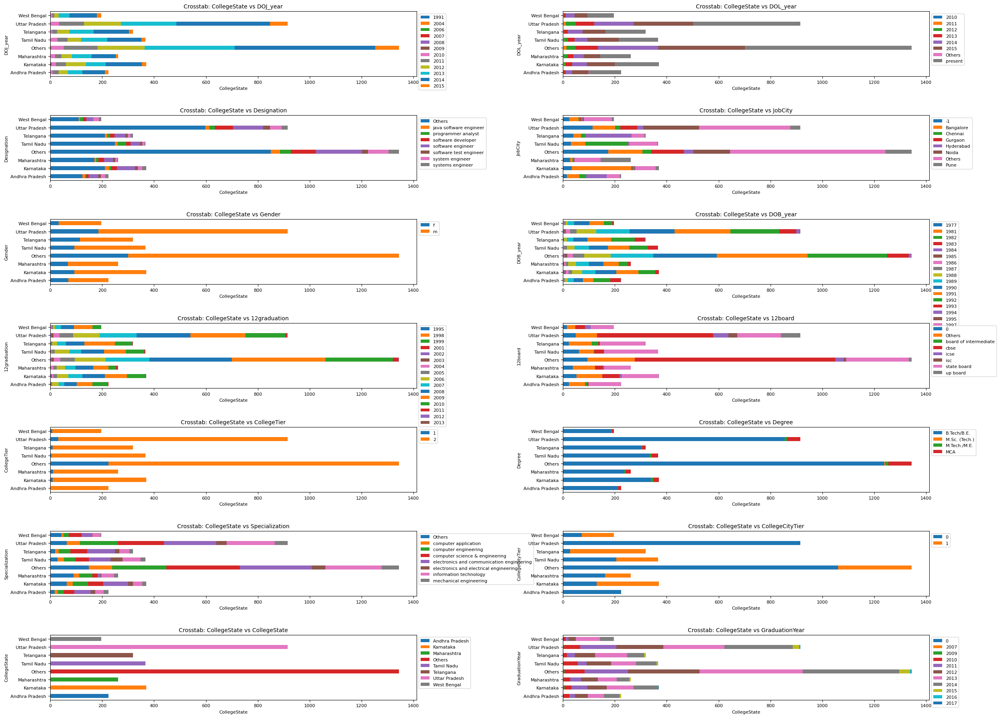

In [ ]:
x_col = 'CollegeState'

fig, axes = plt.subplots(nrows=7, ncols=2, figsize=(25, 18))

axes = axes.flatten()

for i, col in enumerate(categorical_df_bivariate.columns):
        ctab = pd.crosstab(categorical_df_bivariate[x_col], categorical_df_bivariate[col])

        ctab.plot(kind='barh', stacked=True, ax=axes[i])
        axes[i].set_title(f'Crosstab: {x_col} vs {col}', fontsize=10)
        axes[i].set_xlabel(x_col, fontsize=8)
        axes[i].set_ylabel(col, fontsize=8)
        axes[i].tick_params(axis='both', which='major', labelsize=8)

        axes[i].legend(loc='upper left', bbox_to_anchor=(1, 1), fontsize=8)
for j in range(i + 1, len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.subplots_adjust(wspace=0.4, hspace=0.6)

plt.show()

### 14) Graduation Year VS Rest of the categorical columns

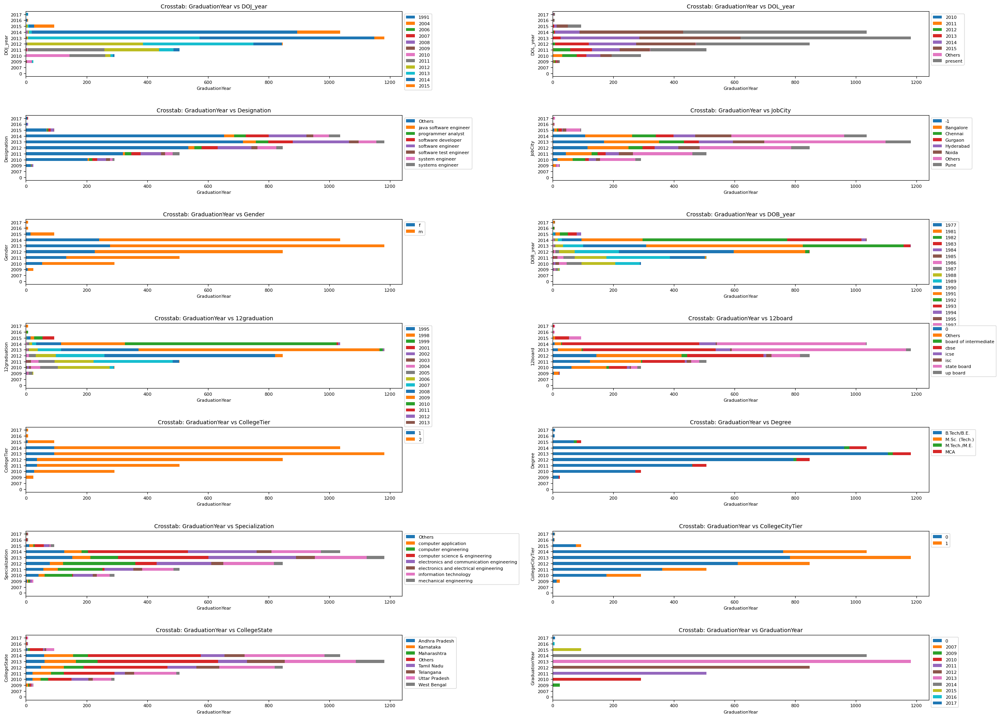

In [ ]:
x_col = 'GraduationYear'

fig, axes = plt.subplots(nrows=7, ncols=2, figsize=(25, 18))

axes = axes.flatten()

for i, col in enumerate(categorical_df_bivariate.columns):
        ctab = pd.crosstab(categorical_df_bivariate[x_col], categorical_df_bivariate[col])

        ctab.plot(kind='barh', stacked=True, ax=axes[i])
        axes[i].set_title(f'Crosstab: {x_col} vs {col}', fontsize=10)
        axes[i].set_xlabel(x_col, fontsize=8)
        axes[i].set_ylabel(col, fontsize=8)
        axes[i].tick_params(axis='both', which='major', labelsize=8)

        axes[i].legend(loc='upper left', bbox_to_anchor=(1, 1), fontsize=8)
for j in range(i + 1, len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.subplots_adjust(wspace=0.4, hspace=0.6)

plt.show()

##Performing Bivariate analysis on Numerical VS Categorical columns

In [35]:
numerical_df.shape[1]

20

In [36]:
numerical_df.columns

Index(['Salary', '10percentage', '12percentage', 'collegeGPA', 'English',
       'Logical', 'Quant', 'Domain', 'ComputerProgramming',
       'ElectronicsAndSemicon', 'ComputerScience', 'MechanicalEngg',
       'ElectricalEngg', 'TelecomEngg', 'CivilEngg', 'conscientiousness',
       'agreeableness', 'extraversion', 'nueroticism',
       'openess_to_experience'],
      dtype='object')

In [37]:
categorical_df_bivariate.shape[1]

14

In [38]:
categorical_df_bivariate.columns

Index(['DOJ_year', 'DOL_year', 'Designation', 'JobCity', 'Gender', 'DOB_year',
       '12graduation', '12board', 'CollegeTier', 'Degree', 'Specialization',
       'CollegeCityTier', 'CollegeState', 'GraduationYear'],
      dtype='object')

### 1) DOJ Year VS Rest of the Numerical columns


/usr/local/lib/python3.10/dist-packages/seaborn/categorical.py:640: FutureWarning: SeriesGroupBy.grouper is deprecated and will be removed in a future version of pandas.
  positions = grouped.grouper.result_index.to_numpy(dtype=float)
/usr/local/lib/python3.10/dist-packages/seaborn/categorical.py:640: FutureWarning: SeriesGroupBy.grouper is deprecated and will be removed in a future version of pandas.
  positions = grouped.grouper.result_index.to_numpy(dtype=float)
/usr/local/lib/python3.10/dist-packages/seaborn/categorical.py:640: FutureWarning: SeriesGroupBy.grouper is deprecated and will be removed in a future version of pandas.
  positions = grouped.grouper.result_index.to_numpy(dtype=float)
/usr/local/lib/python3.10/dist-packages/seaborn/categorical.py:640: FutureWarning: SeriesGroupBy.grouper is deprecated and will be removed in a future version of pandas.
  positions = grouped.grouper.result_index.to_numpy(dtype=float)
/usr/local/lib/python3.10/dist-packages/seaborn/categorical.

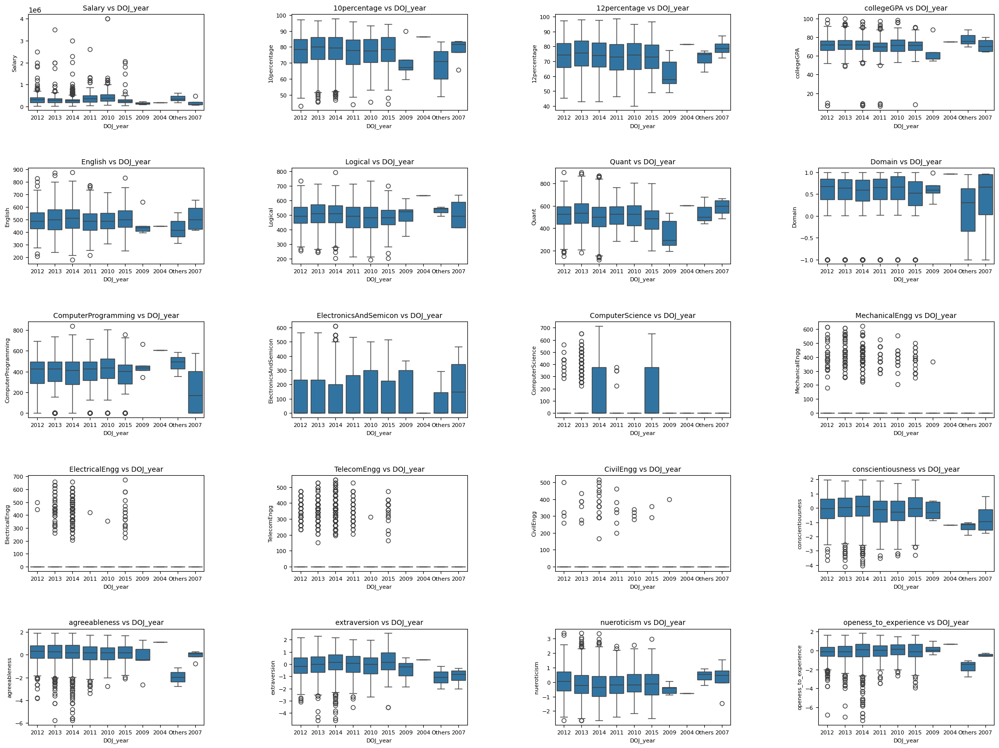

In [39]:
fig, axes = plt.subplots(nrows=5, ncols=4, figsize=(20, 15))
axes = axes.flatten()

plot_idx = 0
cat_col = 'DOJ_year'
for num_col in numerical_df:
        sns.boxplot(x=categorical_df_bivariate[cat_col], y=numerical_df[num_col], ax=axes[plot_idx])

        axes[plot_idx].set_title(f'{num_col} vs {cat_col}', fontsize=10)
        axes[plot_idx].set_xlabel(cat_col, fontsize=8)
        axes[plot_idx].set_ylabel(num_col, fontsize=8)
        axes[plot_idx].tick_params(axis='both', which='major', labelsize=8)

        plot_idx += 1

for j in range(plot_idx, len(axes)):
    fig.delaxes(axes[j])
plt.tight_layout()
plt.subplots_adjust(wspace=0.5, hspace=0.6)

plt.show()

### 2) DOL Year VS Rest of the Numerical columns


/usr/local/lib/python3.10/dist-packages/seaborn/categorical.py:640: FutureWarning: SeriesGroupBy.grouper is deprecated and will be removed in a future version of pandas.
  positions = grouped.grouper.result_index.to_numpy(dtype=float)
/usr/local/lib/python3.10/dist-packages/seaborn/categorical.py:640: FutureWarning: SeriesGroupBy.grouper is deprecated and will be removed in a future version of pandas.
  positions = grouped.grouper.result_index.to_numpy(dtype=float)
/usr/local/lib/python3.10/dist-packages/seaborn/categorical.py:640: FutureWarning: SeriesGroupBy.grouper is deprecated and will be removed in a future version of pandas.
  positions = grouped.grouper.result_index.to_numpy(dtype=float)
/usr/local/lib/python3.10/dist-packages/seaborn/categorical.py:640: FutureWarning: SeriesGroupBy.grouper is deprecated and will be removed in a future version of pandas.
  positions = grouped.grouper.result_index.to_numpy(dtype=float)
/usr/local/lib/python3.10/dist-packages/seaborn/categorical.

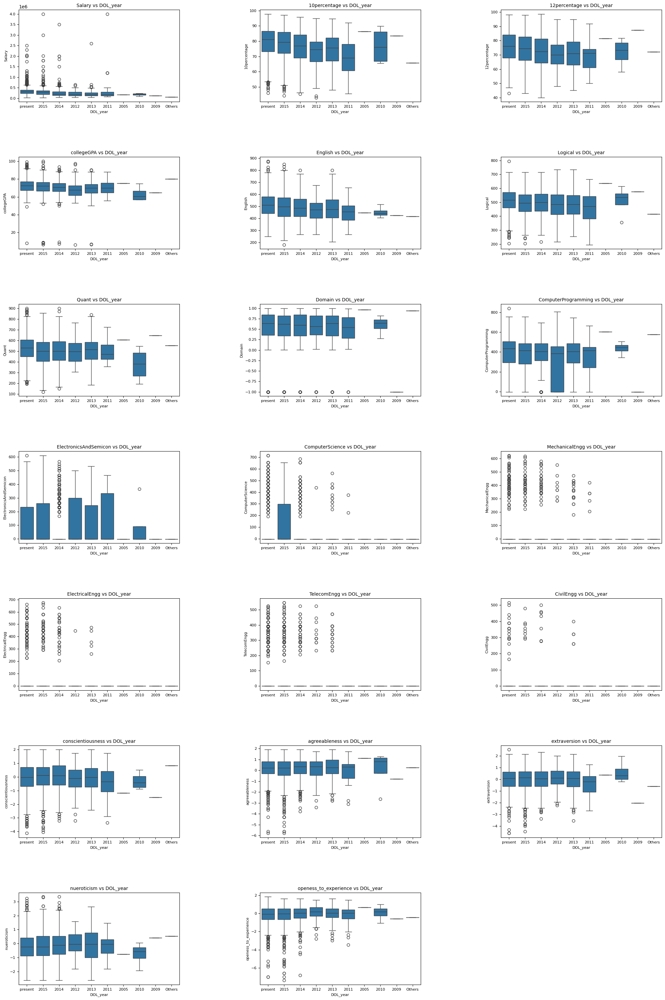

In [40]:
fig, axes = plt.subplots(nrows=7, ncols=3, figsize=(20, 30))
axes = axes.flatten()

plot_idx = 0
cat_col = 'DOL_year'
for num_col in numerical_df:
        sns.boxplot(x=categorical_df_bivariate[cat_col], y=numerical_df[num_col], ax=axes[plot_idx])

        axes[plot_idx].set_title(f'{num_col} vs {cat_col}', fontsize=10)
        axes[plot_idx].set_xlabel(cat_col, fontsize=8)
        axes[plot_idx].set_ylabel(num_col, fontsize=8)
        axes[plot_idx].tick_params(axis='both', which='major', labelsize=8)

        plot_idx += 1

for j in range(plot_idx, len(axes)):
    fig.delaxes(axes[j])
plt.tight_layout()
plt.subplots_adjust(wspace=0.5, hspace=0.6)

plt.show()

### 3) DOB Year VS Rest of the Numerical columns


/usr/local/lib/python3.10/dist-packages/seaborn/categorical.py:640: FutureWarning: SeriesGroupBy.grouper is deprecated and will be removed in a future version of pandas.
  positions = grouped.grouper.result_index.to_numpy(dtype=float)
/usr/local/lib/python3.10/dist-packages/seaborn/categorical.py:640: FutureWarning: SeriesGroupBy.grouper is deprecated and will be removed in a future version of pandas.
  positions = grouped.grouper.result_index.to_numpy(dtype=float)
/usr/local/lib/python3.10/dist-packages/seaborn/categorical.py:640: FutureWarning: SeriesGroupBy.grouper is deprecated and will be removed in a future version of pandas.
  positions = grouped.grouper.result_index.to_numpy(dtype=float)
/usr/local/lib/python3.10/dist-packages/seaborn/categorical.py:640: FutureWarning: SeriesGroupBy.grouper is deprecated and will be removed in a future version of pandas.
  positions = grouped.grouper.result_index.to_numpy(dtype=float)
/usr/local/lib/python3.10/dist-packages/seaborn/categorical.

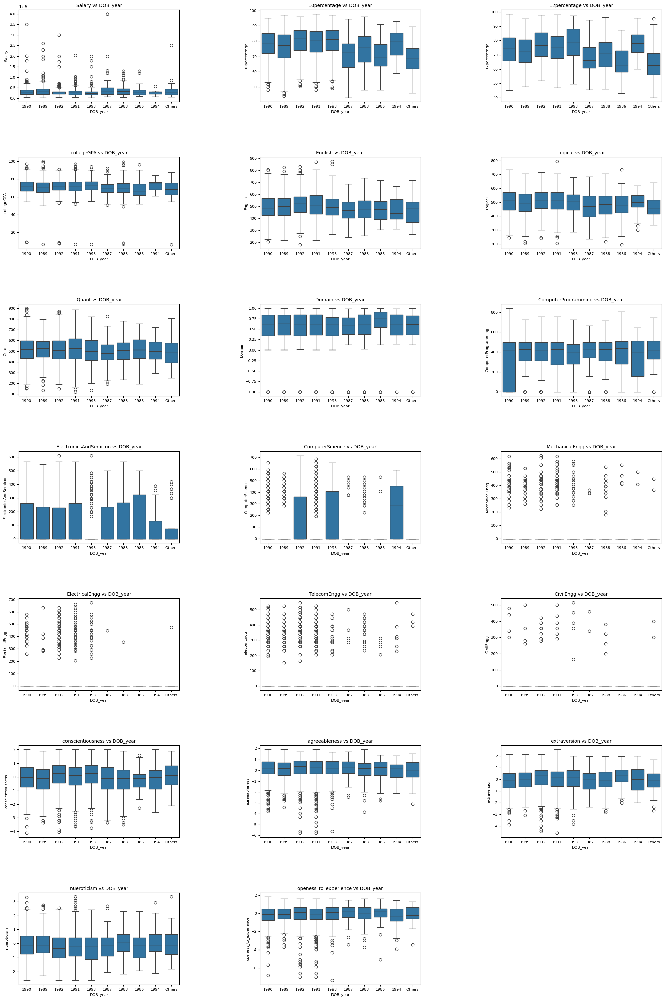

In [41]:
fig, axes = plt.subplots(nrows=7, ncols=3, figsize=(20, 30))
axes = axes.flatten()

plot_idx = 0
cat_col = 'DOB_year'
for num_col in numerical_df:
        sns.boxplot(x=categorical_df_bivariate[cat_col], y=numerical_df[num_col], ax=axes[plot_idx])

        axes[plot_idx].set_title(f'{num_col} vs {cat_col}', fontsize=10)
        axes[plot_idx].set_xlabel(cat_col, fontsize=8)
        axes[plot_idx].set_ylabel(num_col, fontsize=8)
        axes[plot_idx].tick_params(axis='both', which='major', labelsize=8)

        plot_idx += 1

for j in range(plot_idx, len(axes)):
    fig.delaxes(axes[j])
plt.tight_layout()
plt.subplots_adjust(wspace=0.5, hspace=0.6)

plt.show()

### 4) Designation VS Rest of the Numerical columns


/usr/local/lib/python3.10/dist-packages/seaborn/categorical.py:640: FutureWarning: SeriesGroupBy.grouper is deprecated and will be removed in a future version of pandas.
  positions = grouped.grouper.result_index.to_numpy(dtype=float)
/usr/local/lib/python3.10/dist-packages/seaborn/categorical.py:640: FutureWarning: SeriesGroupBy.grouper is deprecated and will be removed in a future version of pandas.
  positions = grouped.grouper.result_index.to_numpy(dtype=float)
/usr/local/lib/python3.10/dist-packages/seaborn/categorical.py:640: FutureWarning: SeriesGroupBy.grouper is deprecated and will be removed in a future version of pandas.
  positions = grouped.grouper.result_index.to_numpy(dtype=float)
/usr/local/lib/python3.10/dist-packages/seaborn/categorical.py:640: FutureWarning: SeriesGroupBy.grouper is deprecated and will be removed in a future version of pandas.
  positions = grouped.grouper.result_index.to_numpy(dtype=float)
/usr/local/lib/python3.10/dist-packages/seaborn/categorical.

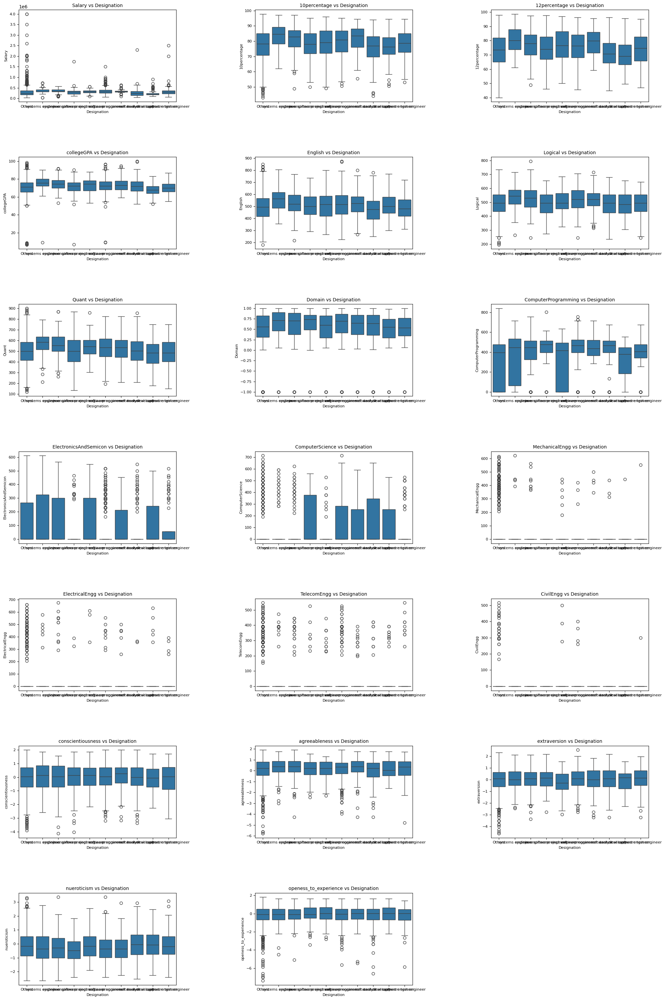

In [42]:
fig, axes = plt.subplots(nrows=7, ncols=3, figsize=(20, 30))
axes = axes.flatten()

plot_idx = 0
cat_col = 'Designation'
for num_col in numerical_df:
        sns.boxplot(x=categorical_df_bivariate[cat_col], y=numerical_df[num_col], ax=axes[plot_idx])

        axes[plot_idx].set_title(f'{num_col} vs {cat_col}', fontsize=10)
        axes[plot_idx].set_xlabel(cat_col, fontsize=8)
        axes[plot_idx].set_ylabel(num_col, fontsize=8)
        axes[plot_idx].tick_params(axis='both', which='major', labelsize=8)

        plot_idx += 1

for j in range(plot_idx, len(axes)):
    fig.delaxes(axes[j])
plt.tight_layout()
plt.subplots_adjust(wspace=0.5, hspace=0.6)

plt.show()

### 5) Job City VS Rest of the Numerical columns


/usr/local/lib/python3.10/dist-packages/seaborn/categorical.py:640: FutureWarning: SeriesGroupBy.grouper is deprecated and will be removed in a future version of pandas.
  positions = grouped.grouper.result_index.to_numpy(dtype=float)
/usr/local/lib/python3.10/dist-packages/seaborn/categorical.py:640: FutureWarning: SeriesGroupBy.grouper is deprecated and will be removed in a future version of pandas.
  positions = grouped.grouper.result_index.to_numpy(dtype=float)
/usr/local/lib/python3.10/dist-packages/seaborn/categorical.py:640: FutureWarning: SeriesGroupBy.grouper is deprecated and will be removed in a future version of pandas.
  positions = grouped.grouper.result_index.to_numpy(dtype=float)
/usr/local/lib/python3.10/dist-packages/seaborn/categorical.py:640: FutureWarning: SeriesGroupBy.grouper is deprecated and will be removed in a future version of pandas.
  positions = grouped.grouper.result_index.to_numpy(dtype=float)
/usr/local/lib/python3.10/dist-packages/seaborn/categorical.

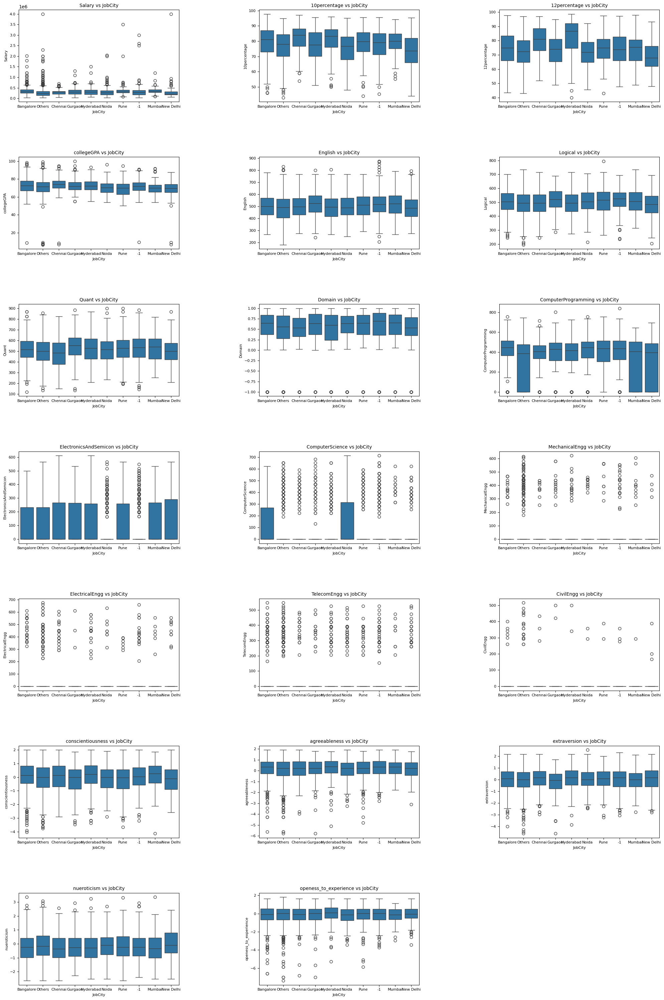

In [43]:
fig, axes = plt.subplots(nrows=7, ncols=3, figsize=(20, 30))
axes = axes.flatten()

plot_idx = 0
cat_col = 'JobCity'
for num_col in numerical_df:
        sns.boxplot(x=categorical_df_bivariate[cat_col], y=numerical_df[num_col], ax=axes[plot_idx])

        axes[plot_idx].set_title(f'{num_col} vs {cat_col}', fontsize=10)
        axes[plot_idx].set_xlabel(cat_col, fontsize=8)
        axes[plot_idx].set_ylabel(num_col, fontsize=8)
        axes[plot_idx].tick_params(axis='both', which='major', labelsize=8)

        plot_idx += 1

for j in range(plot_idx, len(axes)):
    fig.delaxes(axes[j])
plt.tight_layout()
plt.subplots_adjust(wspace=0.5, hspace=0.6)

plt.show()

### 6) Gender VS Rest of the Numerical columns


/usr/local/lib/python3.10/dist-packages/seaborn/categorical.py:640: FutureWarning: SeriesGroupBy.grouper is deprecated and will be removed in a future version of pandas.
  positions = grouped.grouper.result_index.to_numpy(dtype=float)
/usr/local/lib/python3.10/dist-packages/seaborn/categorical.py:640: FutureWarning: SeriesGroupBy.grouper is deprecated and will be removed in a future version of pandas.
  positions = grouped.grouper.result_index.to_numpy(dtype=float)
/usr/local/lib/python3.10/dist-packages/seaborn/categorical.py:640: FutureWarning: SeriesGroupBy.grouper is deprecated and will be removed in a future version of pandas.
  positions = grouped.grouper.result_index.to_numpy(dtype=float)
/usr/local/lib/python3.10/dist-packages/seaborn/categorical.py:640: FutureWarning: SeriesGroupBy.grouper is deprecated and will be removed in a future version of pandas.
  positions = grouped.grouper.result_index.to_numpy(dtype=float)
/usr/local/lib/python3.10/dist-packages/seaborn/categorical.

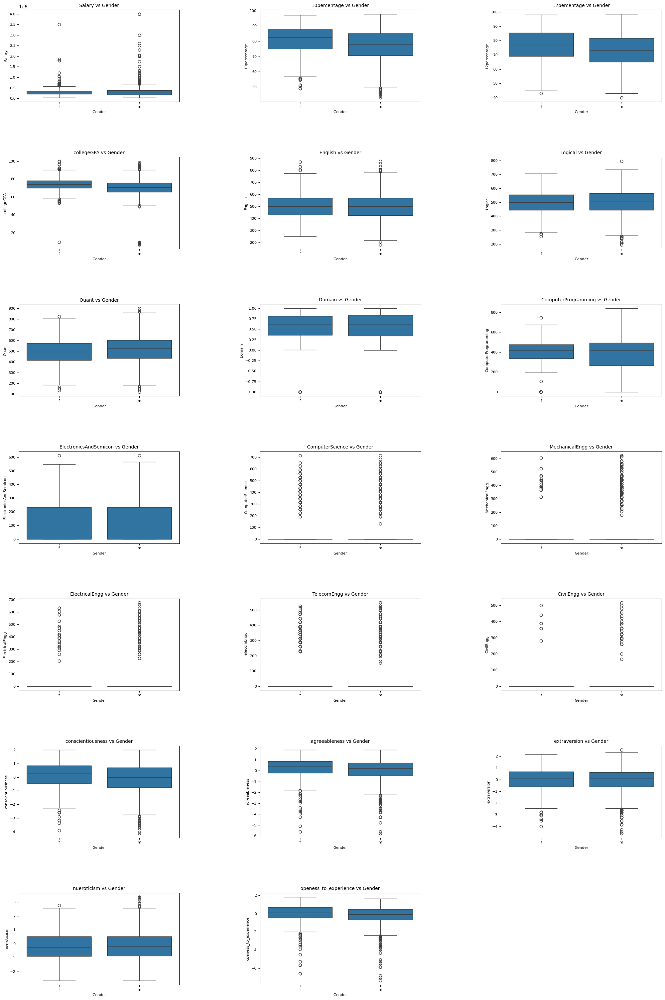

In [44]:
fig, axes = plt.subplots(nrows=7, ncols=3, figsize=(20, 30))
axes = axes.flatten()

plot_idx = 0
cat_col = 'Gender'
for num_col in numerical_df:
        sns.boxplot(x=categorical_df_bivariate[cat_col], y=numerical_df[num_col], ax=axes[plot_idx])

        axes[plot_idx].set_title(f'{num_col} vs {cat_col}', fontsize=10)
        axes[plot_idx].set_xlabel(cat_col, fontsize=8)
        axes[plot_idx].set_ylabel(num_col, fontsize=8)
        axes[plot_idx].tick_params(axis='both', which='major', labelsize=8)

        plot_idx += 1

for j in range(plot_idx, len(axes)):
    fig.delaxes(axes[j])
plt.tight_layout()
plt.subplots_adjust(wspace=0.5, hspace=0.6)

plt.show()

### 7) 12th graduation VS Rest of the Numerical columns


/usr/local/lib/python3.10/dist-packages/seaborn/categorical.py:640: FutureWarning: SeriesGroupBy.grouper is deprecated and will be removed in a future version of pandas.
  positions = grouped.grouper.result_index.to_numpy(dtype=float)
/usr/local/lib/python3.10/dist-packages/seaborn/categorical.py:640: FutureWarning: SeriesGroupBy.grouper is deprecated and will be removed in a future version of pandas.
  positions = grouped.grouper.result_index.to_numpy(dtype=float)
/usr/local/lib/python3.10/dist-packages/seaborn/categorical.py:640: FutureWarning: SeriesGroupBy.grouper is deprecated and will be removed in a future version of pandas.
  positions = grouped.grouper.result_index.to_numpy(dtype=float)
/usr/local/lib/python3.10/dist-packages/seaborn/categorical.py:640: FutureWarning: SeriesGroupBy.grouper is deprecated and will be removed in a future version of pandas.
  positions = grouped.grouper.result_index.to_numpy(dtype=float)
/usr/local/lib/python3.10/dist-packages/seaborn/categorical.

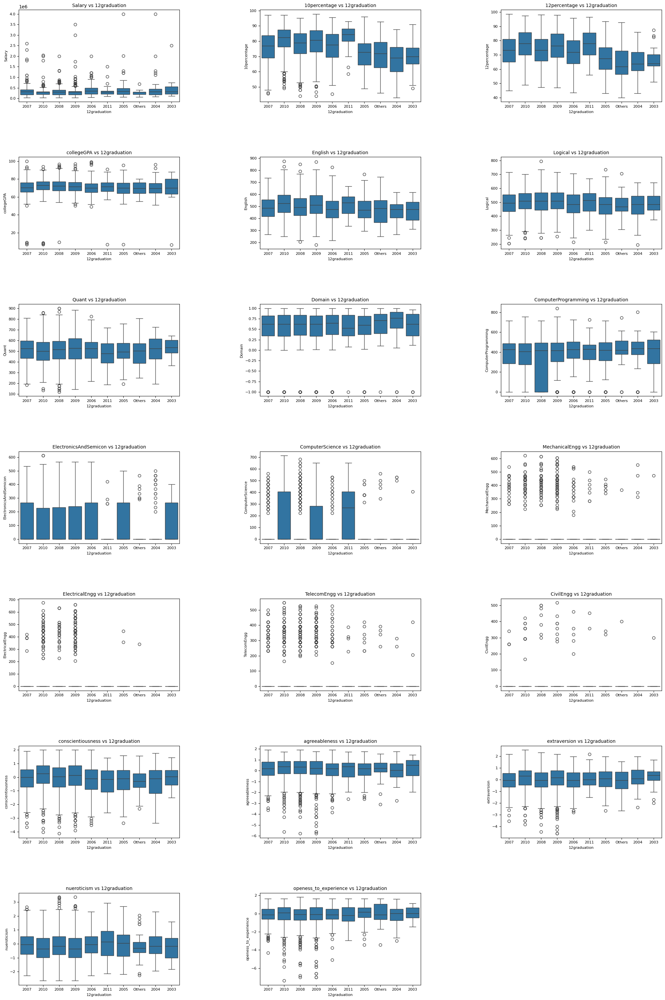

In [45]:
fig, axes = plt.subplots(nrows=7, ncols=3, figsize=(20, 30))
axes = axes.flatten()

plot_idx = 0
cat_col = '12graduation'
for num_col in numerical_df:
        sns.boxplot(x=categorical_df_bivariate[cat_col], y=numerical_df[num_col], ax=axes[plot_idx])

        axes[plot_idx].set_title(f'{num_col} vs {cat_col}', fontsize=10)
        axes[plot_idx].set_xlabel(cat_col, fontsize=8)
        axes[plot_idx].set_ylabel(num_col, fontsize=8)
        axes[plot_idx].tick_params(axis='both', which='major', labelsize=8)

        plot_idx += 1

for j in range(plot_idx, len(axes)):
    fig.delaxes(axes[j])
plt.tight_layout()
plt.subplots_adjust(wspace=0.5, hspace=0.6)

plt.show()

### 8) 12th board VS Rest of the Numerical columns


/usr/local/lib/python3.10/dist-packages/seaborn/categorical.py:640: FutureWarning: SeriesGroupBy.grouper is deprecated and will be removed in a future version of pandas.
  positions = grouped.grouper.result_index.to_numpy(dtype=float)
/usr/local/lib/python3.10/dist-packages/seaborn/categorical.py:640: FutureWarning: SeriesGroupBy.grouper is deprecated and will be removed in a future version of pandas.
  positions = grouped.grouper.result_index.to_numpy(dtype=float)
/usr/local/lib/python3.10/dist-packages/seaborn/categorical.py:640: FutureWarning: SeriesGroupBy.grouper is deprecated and will be removed in a future version of pandas.
  positions = grouped.grouper.result_index.to_numpy(dtype=float)
/usr/local/lib/python3.10/dist-packages/seaborn/categorical.py:640: FutureWarning: SeriesGroupBy.grouper is deprecated and will be removed in a future version of pandas.
  positions = grouped.grouper.result_index.to_numpy(dtype=float)
/usr/local/lib/python3.10/dist-packages/seaborn/categorical.

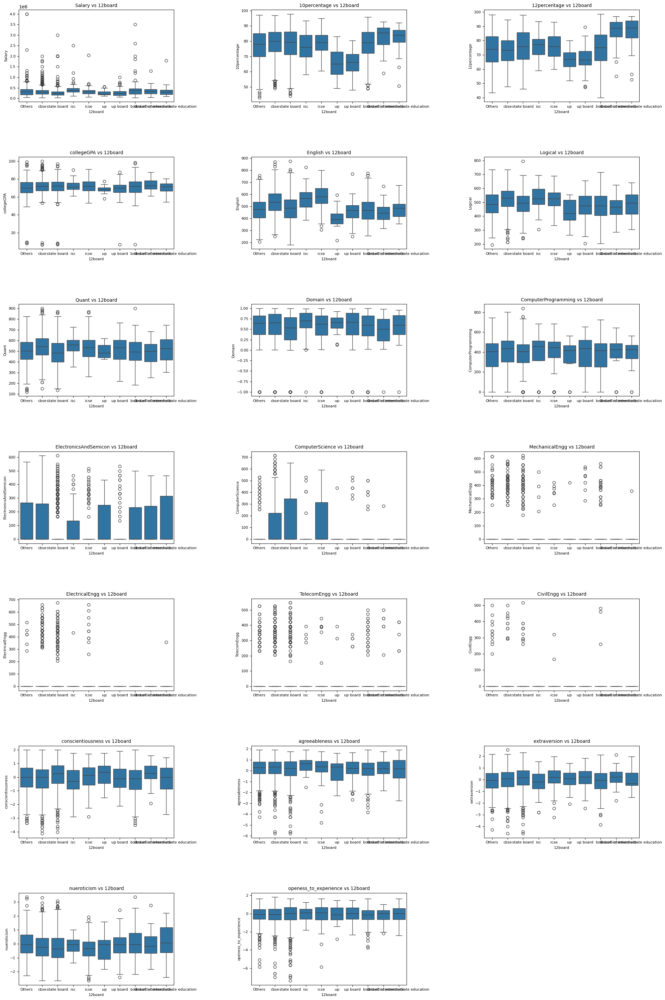

In [46]:
fig, axes = plt.subplots(nrows=7, ncols=3, figsize=(20, 30))
axes = axes.flatten()

plot_idx = 0
cat_col = '12board'
for num_col in numerical_df:
        sns.boxplot(x=categorical_df_bivariate[cat_col], y=numerical_df[num_col], ax=axes[plot_idx])

        axes[plot_idx].set_title(f'{num_col} vs {cat_col}', fontsize=10)
        axes[plot_idx].set_xlabel(cat_col, fontsize=8)
        axes[plot_idx].set_ylabel(num_col, fontsize=8)
        axes[plot_idx].tick_params(axis='both', which='major', labelsize=8)

        plot_idx += 1

for j in range(plot_idx, len(axes)):
    fig.delaxes(axes[j])
plt.tight_layout()
plt.subplots_adjust(wspace=0.5, hspace=0.6)

plt.show()

### 9) College Tier VS Rest of the Numerical columns


/usr/local/lib/python3.10/dist-packages/seaborn/categorical.py:640: FutureWarning: SeriesGroupBy.grouper is deprecated and will be removed in a future version of pandas.
  positions = grouped.grouper.result_index.to_numpy(dtype=float)
/usr/local/lib/python3.10/dist-packages/seaborn/categorical.py:640: FutureWarning: SeriesGroupBy.grouper is deprecated and will be removed in a future version of pandas.
  positions = grouped.grouper.result_index.to_numpy(dtype=float)
/usr/local/lib/python3.10/dist-packages/seaborn/categorical.py:640: FutureWarning: SeriesGroupBy.grouper is deprecated and will be removed in a future version of pandas.
  positions = grouped.grouper.result_index.to_numpy(dtype=float)
/usr/local/lib/python3.10/dist-packages/seaborn/categorical.py:640: FutureWarning: SeriesGroupBy.grouper is deprecated and will be removed in a future version of pandas.
  positions = grouped.grouper.result_index.to_numpy(dtype=float)
/usr/local/lib/python3.10/dist-packages/seaborn/categorical.

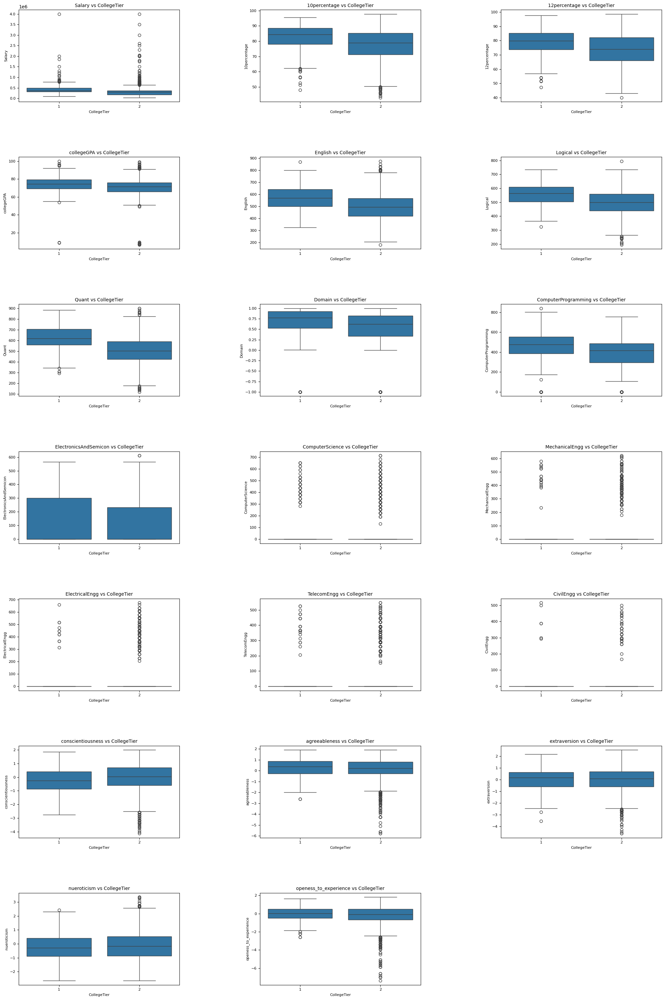

In [47]:
fig, axes = plt.subplots(nrows=7, ncols=3, figsize=(20, 30))
axes = axes.flatten()

plot_idx = 0
cat_col = 'CollegeTier'
for num_col in numerical_df:
        sns.boxplot(x=categorical_df_bivariate[cat_col], y=numerical_df[num_col], ax=axes[plot_idx])

        axes[plot_idx].set_title(f'{num_col} vs {cat_col}', fontsize=10)
        axes[plot_idx].set_xlabel(cat_col, fontsize=8)
        axes[plot_idx].set_ylabel(num_col, fontsize=8)
        axes[plot_idx].tick_params(axis='both', which='major', labelsize=8)

        plot_idx += 1

for j in range(plot_idx, len(axes)):
    fig.delaxes(axes[j])
plt.tight_layout()
plt.subplots_adjust(wspace=0.5, hspace=0.6)

plt.show()

### 10) Degree VS Rest of the Numerical columns


/usr/local/lib/python3.10/dist-packages/seaborn/categorical.py:640: FutureWarning: SeriesGroupBy.grouper is deprecated and will be removed in a future version of pandas.
  positions = grouped.grouper.result_index.to_numpy(dtype=float)
/usr/local/lib/python3.10/dist-packages/seaborn/categorical.py:640: FutureWarning: SeriesGroupBy.grouper is deprecated and will be removed in a future version of pandas.
  positions = grouped.grouper.result_index.to_numpy(dtype=float)
/usr/local/lib/python3.10/dist-packages/seaborn/categorical.py:640: FutureWarning: SeriesGroupBy.grouper is deprecated and will be removed in a future version of pandas.
  positions = grouped.grouper.result_index.to_numpy(dtype=float)
/usr/local/lib/python3.10/dist-packages/seaborn/categorical.py:640: FutureWarning: SeriesGroupBy.grouper is deprecated and will be removed in a future version of pandas.
  positions = grouped.grouper.result_index.to_numpy(dtype=float)
/usr/local/lib/python3.10/dist-packages/seaborn/categorical.

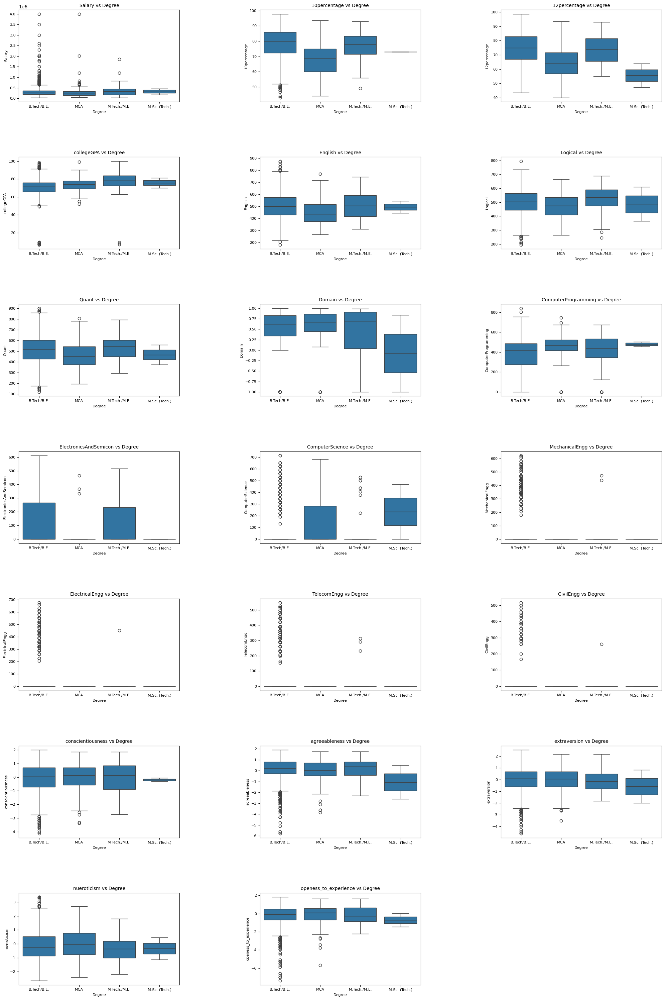

In [48]:
fig, axes = plt.subplots(nrows=7, ncols=3, figsize=(20, 30))
axes = axes.flatten()

plot_idx = 0
cat_col = 'Degree'
for num_col in numerical_df:
        sns.boxplot(x=categorical_df_bivariate[cat_col], y=numerical_df[num_col], ax=axes[plot_idx])

        axes[plot_idx].set_title(f'{num_col} vs {cat_col}', fontsize=10)
        axes[plot_idx].set_xlabel(cat_col, fontsize=8)
        axes[plot_idx].set_ylabel(num_col, fontsize=8)
        axes[plot_idx].tick_params(axis='both', which='major', labelsize=8)

        plot_idx += 1

for j in range(plot_idx, len(axes)):
    fig.delaxes(axes[j])
plt.tight_layout()
plt.subplots_adjust(wspace=0.5, hspace=0.6)

plt.show()

### 11) Specialization VS Rest of the Numerical columns


/usr/local/lib/python3.10/dist-packages/seaborn/categorical.py:640: FutureWarning: SeriesGroupBy.grouper is deprecated and will be removed in a future version of pandas.
  positions = grouped.grouper.result_index.to_numpy(dtype=float)
/usr/local/lib/python3.10/dist-packages/seaborn/categorical.py:640: FutureWarning: SeriesGroupBy.grouper is deprecated and will be removed in a future version of pandas.
  positions = grouped.grouper.result_index.to_numpy(dtype=float)
/usr/local/lib/python3.10/dist-packages/seaborn/categorical.py:640: FutureWarning: SeriesGroupBy.grouper is deprecated and will be removed in a future version of pandas.
  positions = grouped.grouper.result_index.to_numpy(dtype=float)
/usr/local/lib/python3.10/dist-packages/seaborn/categorical.py:640: FutureWarning: SeriesGroupBy.grouper is deprecated and will be removed in a future version of pandas.
  positions = grouped.grouper.result_index.to_numpy(dtype=float)
/usr/local/lib/python3.10/dist-packages/seaborn/categorical.

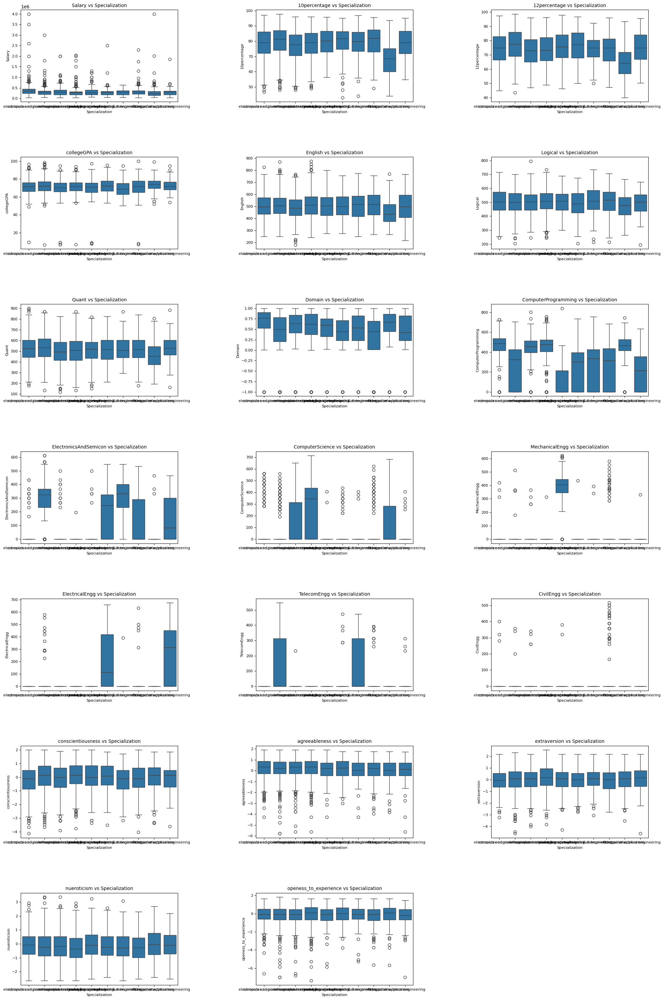

In [49]:
fig, axes = plt.subplots(nrows=7, ncols=3, figsize=(20, 30))
axes = axes.flatten()

plot_idx = 0
cat_col = 'Specialization'
for num_col in numerical_df:
        sns.boxplot(x=categorical_df_bivariate[cat_col], y=numerical_df[num_col], ax=axes[plot_idx])

        axes[plot_idx].set_title(f'{num_col} vs {cat_col}', fontsize=10)
        axes[plot_idx].set_xlabel(cat_col, fontsize=8)
        axes[plot_idx].set_ylabel(num_col, fontsize=8)
        axes[plot_idx].tick_params(axis='both', which='major', labelsize=8)

        plot_idx += 1

for j in range(plot_idx, len(axes)):
    fig.delaxes(axes[j])
plt.tight_layout()
plt.subplots_adjust(wspace=0.5, hspace=0.6)

plt.show()

### 12) CollegeCityTier VS Rest of the Numerical columns


/usr/local/lib/python3.10/dist-packages/seaborn/categorical.py:640: FutureWarning: SeriesGroupBy.grouper is deprecated and will be removed in a future version of pandas.
  positions = grouped.grouper.result_index.to_numpy(dtype=float)
/usr/local/lib/python3.10/dist-packages/seaborn/categorical.py:640: FutureWarning: SeriesGroupBy.grouper is deprecated and will be removed in a future version of pandas.
  positions = grouped.grouper.result_index.to_numpy(dtype=float)
/usr/local/lib/python3.10/dist-packages/seaborn/categorical.py:640: FutureWarning: SeriesGroupBy.grouper is deprecated and will be removed in a future version of pandas.
  positions = grouped.grouper.result_index.to_numpy(dtype=float)
/usr/local/lib/python3.10/dist-packages/seaborn/categorical.py:640: FutureWarning: SeriesGroupBy.grouper is deprecated and will be removed in a future version of pandas.
  positions = grouped.grouper.result_index.to_numpy(dtype=float)
/usr/local/lib/python3.10/dist-packages/seaborn/categorical.

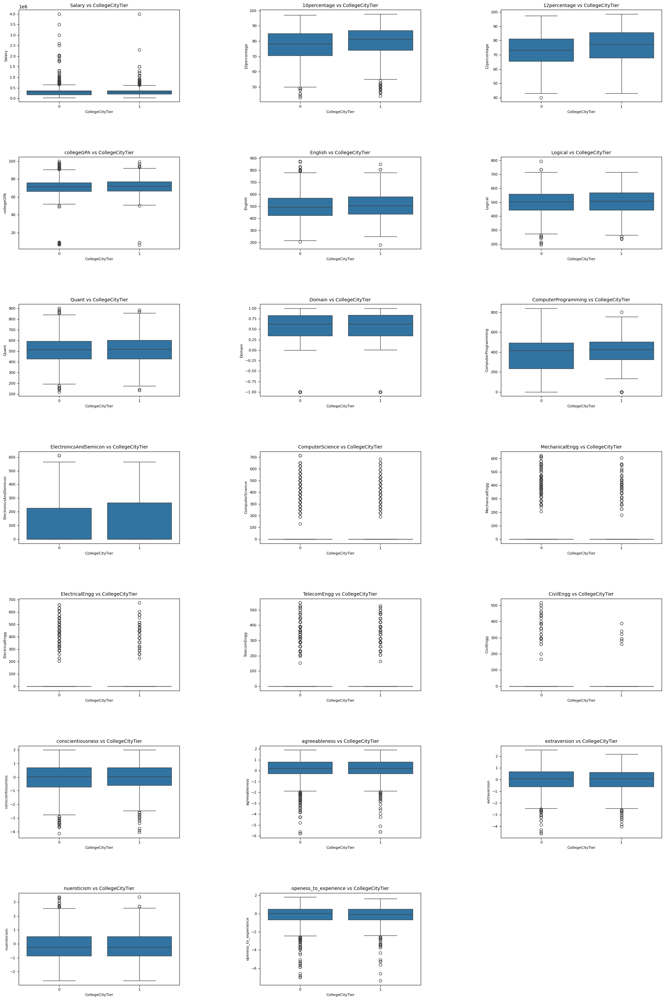

In [50]:
fig, axes = plt.subplots(nrows=7, ncols=3, figsize=(20, 30))
axes = axes.flatten()

plot_idx = 0
cat_col = 'CollegeCityTier'
for num_col in numerical_df:
        sns.boxplot(x=categorical_df_bivariate[cat_col], y=numerical_df[num_col], ax=axes[plot_idx])

        axes[plot_idx].set_title(f'{num_col} vs {cat_col}', fontsize=10)
        axes[plot_idx].set_xlabel(cat_col, fontsize=8)
        axes[plot_idx].set_ylabel(num_col, fontsize=8)
        axes[plot_idx].tick_params(axis='both', which='major', labelsize=8)

        plot_idx += 1

for j in range(plot_idx, len(axes)):
    fig.delaxes(axes[j])
plt.tight_layout()
plt.subplots_adjust(wspace=0.5, hspace=0.6)

plt.show()

### 13) College State VS Rest of the Numerical columns


/usr/local/lib/python3.10/dist-packages/seaborn/categorical.py:640: FutureWarning: SeriesGroupBy.grouper is deprecated and will be removed in a future version of pandas.
  positions = grouped.grouper.result_index.to_numpy(dtype=float)
/usr/local/lib/python3.10/dist-packages/seaborn/categorical.py:640: FutureWarning: SeriesGroupBy.grouper is deprecated and will be removed in a future version of pandas.
  positions = grouped.grouper.result_index.to_numpy(dtype=float)
/usr/local/lib/python3.10/dist-packages/seaborn/categorical.py:640: FutureWarning: SeriesGroupBy.grouper is deprecated and will be removed in a future version of pandas.
  positions = grouped.grouper.result_index.to_numpy(dtype=float)
/usr/local/lib/python3.10/dist-packages/seaborn/categorical.py:640: FutureWarning: SeriesGroupBy.grouper is deprecated and will be removed in a future version of pandas.
  positions = grouped.grouper.result_index.to_numpy(dtype=float)
/usr/local/lib/python3.10/dist-packages/seaborn/categorical.

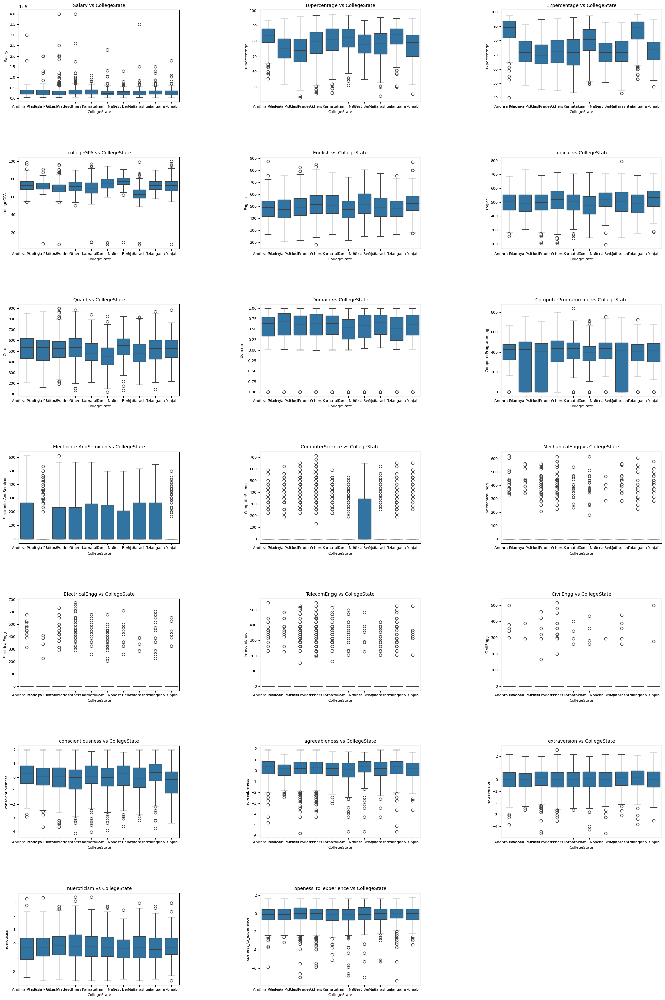

In [51]:
fig, axes = plt.subplots(nrows=7, ncols=3, figsize=(20, 30))
axes = axes.flatten()

plot_idx = 0
cat_col = 'CollegeState'
for num_col in numerical_df:
        sns.boxplot(x=categorical_df_bivariate[cat_col], y=numerical_df[num_col], ax=axes[plot_idx])

        axes[plot_idx].set_title(f'{num_col} vs {cat_col}', fontsize=10)
        axes[plot_idx].set_xlabel(cat_col, fontsize=8)
        axes[plot_idx].set_ylabel(num_col, fontsize=8)
        axes[plot_idx].tick_params(axis='both', which='major', labelsize=8)

        plot_idx += 1

for j in range(plot_idx, len(axes)):
    fig.delaxes(axes[j])
plt.tight_layout()
plt.subplots_adjust(wspace=0.5, hspace=0.6)

plt.show()

### 14) GraduationYear VS Rest of the Numerical columns


/usr/local/lib/python3.10/dist-packages/seaborn/categorical.py:640: FutureWarning: SeriesGroupBy.grouper is deprecated and will be removed in a future version of pandas.
  positions = grouped.grouper.result_index.to_numpy(dtype=float)
/usr/local/lib/python3.10/dist-packages/seaborn/categorical.py:640: FutureWarning: SeriesGroupBy.grouper is deprecated and will be removed in a future version of pandas.
  positions = grouped.grouper.result_index.to_numpy(dtype=float)
/usr/local/lib/python3.10/dist-packages/seaborn/categorical.py:640: FutureWarning: SeriesGroupBy.grouper is deprecated and will be removed in a future version of pandas.
  positions = grouped.grouper.result_index.to_numpy(dtype=float)
/usr/local/lib/python3.10/dist-packages/seaborn/categorical.py:640: FutureWarning: SeriesGroupBy.grouper is deprecated and will be removed in a future version of pandas.
  positions = grouped.grouper.result_index.to_numpy(dtype=float)
/usr/local/lib/python3.10/dist-packages/seaborn/categorical.

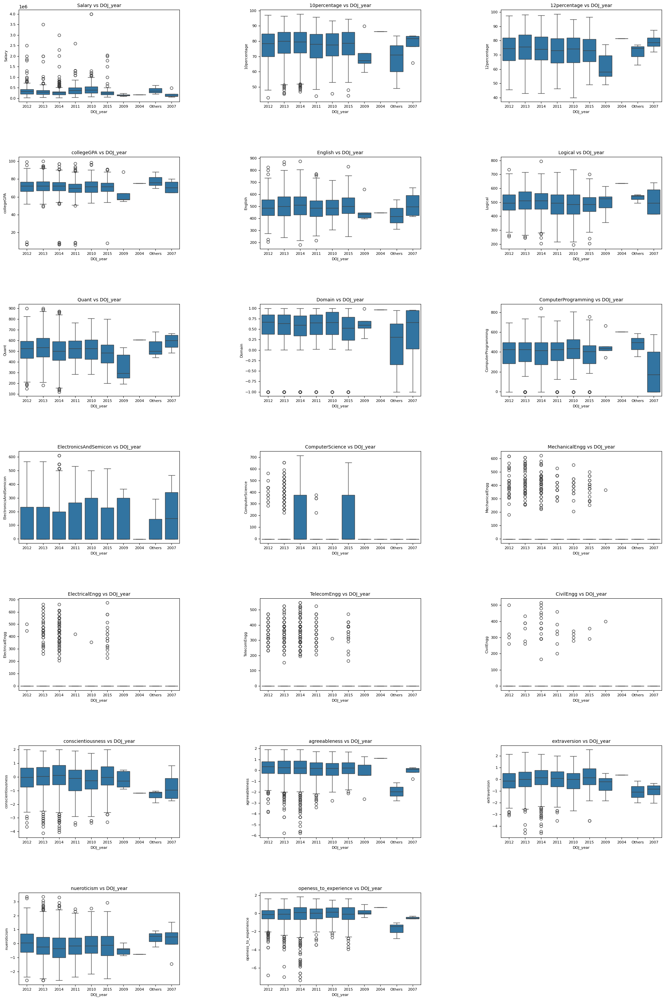

In [52]:
fig, axes = plt.subplots(nrows=7, ncols=3, figsize=(20, 30))
axes = axes.flatten()

plot_idx = 0
cat_col = 'DOJ_year'
for num_col in numerical_df:
        sns.boxplot(x=categorical_df_bivariate[cat_col], y=numerical_df[num_col], ax=axes[plot_idx])

        axes[plot_idx].set_title(f'{num_col} vs {cat_col}', fontsize=10)
        axes[plot_idx].set_xlabel(cat_col, fontsize=8)
        axes[plot_idx].set_ylabel(num_col, fontsize=8)
        axes[plot_idx].tick_params(axis='both', which='major', labelsize=8)

        plot_idx += 1

for j in range(plot_idx, len(axes)):
    fig.delaxes(axes[j])
plt.tight_layout()
plt.subplots_adjust(wspace=0.5, hspace=0.6)

plt.show()

# Step 5: Research Questions

### 1) Times of India article dated Jan 18, 2019 states that “After doing your Computer Science Engineering if you take up jobs as a Programming Analyst, Software Engineer, Hardware Engineer and Associate Engineer you can earn up to 2.5-3 lakhs as a fresh graduate.” Test this claim with the data given to you.

In [26]:
research_analysis_df = df[['Salary', 'Designation']]
specified_values = ['programmer analyst', 'software engineer', 'hardware engineer', 'associate engineer']
research_analysis_df = research_analysis_df[research_analysis_df['Designation'].isin(specified_values)]

/usr/local/lib/python3.10/dist-packages/seaborn/categorical.py:640: FutureWarning: SeriesGroupBy.grouper is deprecated and will be removed in a future version of pandas.
  positions = grouped.grouper.result_index.to_numpy(dtype=float)


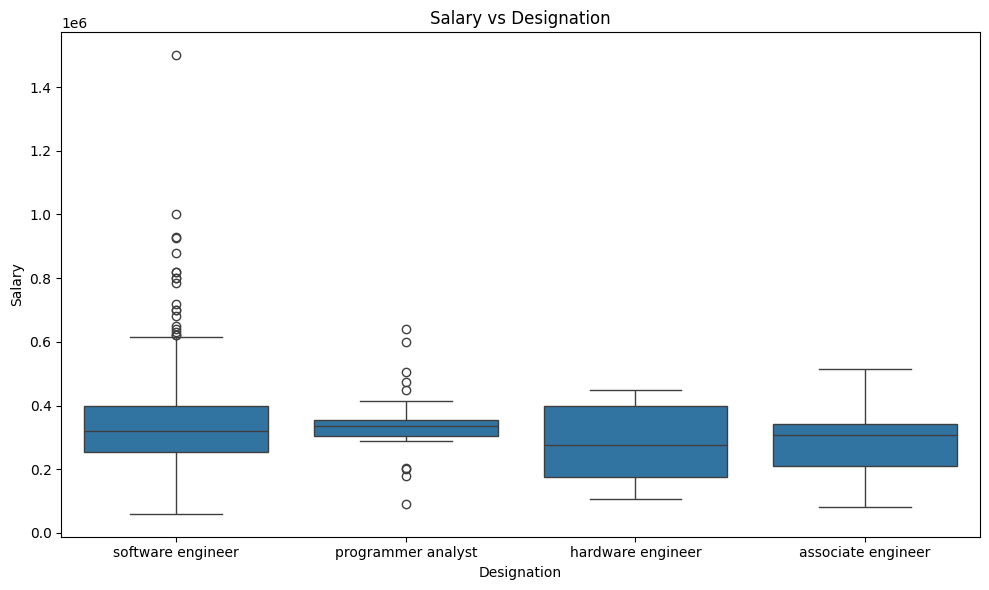

In [27]:
cat_col = 'Designation'
num_col = 'Salary'
plt.figure(figsize=(10, 6))
sns.boxplot(x=research_analysis_df['Designation'], y=research_analysis_df['Salary'])
plt.title(f'{num_col} vs {cat_col}')
plt.xlabel(cat_col)
plt.ylabel(num_col)

plt.tight_layout()
plt.show()

### 2) Is there a relationship between gender and specialization? (i.e. Does the preference of Specialisation depend on the Gender?)


In [32]:
# Run the categorical_df_bivariate once before running this
def replace_less_frequent_with_others(column, top_n=9):
    # Get the top N most frequent values
    top_values = column.value_counts().nlargest(top_n).index
    # Replace values not in the top N with 'Others'
    return column.apply(lambda x: x if x in top_values else 'Others')
for col in categorical_df_bivariate.select_dtypes(include=['object', 'int32', 'int64']).columns:
    unique_vals_count = categorical_df_bivariate[col].nunique()

    if unique_vals_count > 9:
        categorical_df_bivariate[col] = replace_less_frequent_with_others(categorical_df_bivariate[col], top_n=9)
categorical_df_bivariate.nunique()

<ipython-input-32-21cb9f2ee44b>:11: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  categorical_df_bivariate[col] = replace_less_frequent_with_others(categorical_df_bivariate[col], top_n=9)
<ipython-input-32-21cb9f2ee44b>:11: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  categorical_df_bivariate[col] = replace_less_frequent_with_others(categorical_df_bivariate[col], top_n=9)
<ipython-input-32-21cb9f2ee44b>:11: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try usin

,0
DOJ_year,10
DOL_year,10
Designation,10
JobCity,10
Gender,2
DOB_year,10
12graduation,10
12board,10
CollegeTier,2
Degree,4


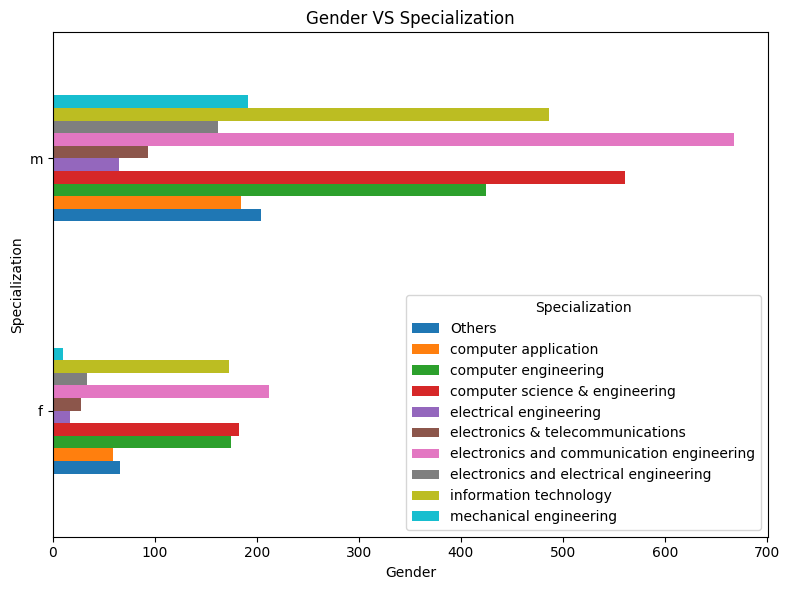

In [33]:
cat_col1 = 'Gender'
cat_col2 = 'Specialization'

crosstab_result = pd.crosstab(categorical_df_bivariate[cat_col1], categorical_df_bivariate[cat_col2])
crosstab_result.plot(kind='barh', figsize=(8, 6))

plt.title(f'{cat_col1} VS {cat_col2}')
plt.xlabel(cat_col1)
plt.ylabel(cat_col2)

plt.tight_layout()

plt.show()

From the above analysis we can see that in 'Mechanical Engineering' field the percentage of 'females' are less than 'males' and we can conclude the same that in mechanical engineers are preferring male candidates over female candidates

# Step 6: Conclusion

From the above analysis on the AMCAT dataset, it can be concluded that the patterns and trends obtained which were done mostly using pandas library exclusively, and needs basic understanding of the same, as well as we obtained interesting results for each column while perfoming univariate analysis. This is all about this project, hope it gave a good understanding of how EDA is done.

# Step 7: Some interesting conclusions

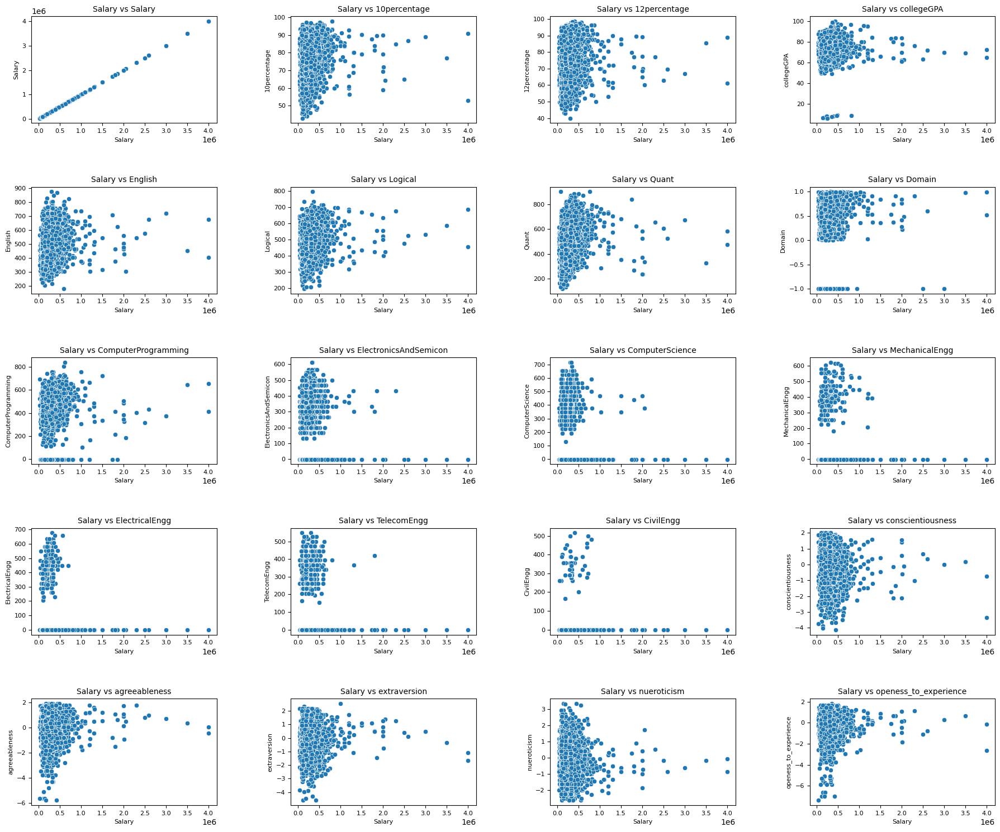

In [34]:
x_col = 'Salary'
fig, axes = plt.subplots(nrows=5, ncols=4, figsize=(18, 15))
axes = axes.flatten()
for i, col in enumerate(numerical_df.columns):
        sns.scatterplot(x=numerical_df[x_col], y=numerical_df[col], ax=axes[i])
        axes[i].set_title(f'{x_col} vs {col}', fontsize=10)
        axes[i].set_xlabel(x_col, fontsize=8)
        axes[i].set_ylabel(col, fontsize=8)
        axes[i].tick_params(axis='both', which='major', labelsize=8)
for j in range(i+1, len(axes)):
    fig.delaxes(axes[j])
plt.tight_layout()
plt.subplots_adjust(wspace=0.4, hspace=0.6)
plt.show()

Assuming that the candidates who have attempted the corresponding technical sections in AMCAT belong to the respective departments in their college degree, we can see that irrespective of those, the salary earned by either a computer science engineering grad or a mechanical engineering grad or any of the degree for the matter of fact is almost the same for most of the candidates

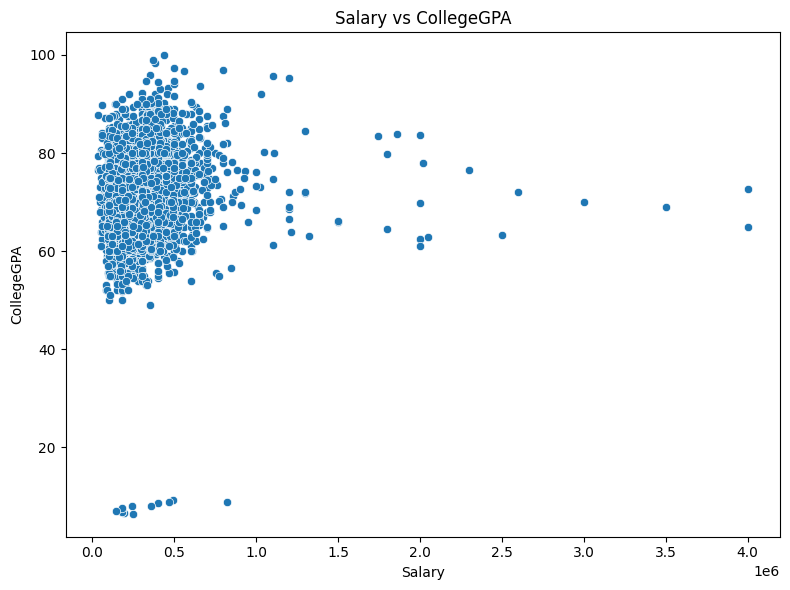

In [21]:
plt.figure(figsize=(8, 6))
sns.scatterplot(x='Salary', y='collegeGPA', data=numerical_df)


plt.title('Salary vs CollegeGPA')
plt.xlabel('Salary')
plt.ylabel('CollegeGPA')

# Adjust the layout
plt.tight_layout()

# Show the plot
plt.show()